# ⚠️ Dataset Info

- STL-10 dataset
- Training: 5,000 images, Test: 8,000 images
- Each image: 96-96 RGB
- Estimated download time: 10 minutes on Colab


In [ ]:
!pip install numpy pandas matplotlib scikit-learn torch torchvision

# Initialization

## install dependencies

In [1]:
try:
    import optuna
    print("Optuna is already installed.")
except ImportError:
    print("Optuna not found, installing...")
    %pip install optuna
    import optuna
    print("Optuna installed successfully.")

Optuna not found, installing...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.9/400.9 kB 11.0 MB/s eta 0:00:00
Optuna installed successfully.


In [2]:
try:
    import tensorflow_datasets as tfds
    print("tfds is already installed.")
except ImportError:
    print("tfds not found, installing...")
    !pip install tensorflow-datasets
    import tensorflow_datasets as tfds
    print("tfds installed successfully.")

tfds is already installed.


## import dependencies

In [3]:
import os
import random
import pickle
import time

import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dense, Flatten, Input, MaxPooling2D, AveragePooling2D
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.utils import to_categorical

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

import optuna

from IPython.display import Audio, display

## configuration and initialization

In [4]:
SEED = 42
IS_LOCAL = False

random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

SAVE_MODEL = False

from IPython.display import Audio, display
import numpy as np

def play_sound(freq, duration):
  """Plays a simple tone in the notebook."""
  # Generate a simple sine wave
  sample_rate = 44100
  t = np.linspace(0., duration, int(sample_rate * duration))
  amplitude = np.iinfo(np.int16).max * 0.5
  audio = amplitude * np.sin(2. * np.pi * freq * t)
  display(Audio(audio, rate=sample_rate, autoplay=True))

def show_training_charts(history):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))  # 1 row, 2 columns

    # Accuracy chart
    ax1.plot(history['accuracy'], label='Training Accuracy')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Accuracy')
    ax1.set_title('Training Accuracy')
    ax1.legend()

    # Loss chart
    ax2.plot(history['loss'], label='Training Loss')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Loss')
    ax2.set_title('Training Loss')
    ax2.legend()

    # Add border around figure
    fig.patch.set_linewidth(1)
    fig.patch.set_edgecolor('black')

    plt.tight_layout()
    plt.show()


def show_confusion_matrix(model, x_test, y_test):
    y_pred_probs = model.predict(x_test)

    y_true_labels = np.argmax(y_test, axis=1)
    y_pred_labels = np.argmax(y_pred_probs, axis=1)

    cm = confusion_matrix(y_true_labels, y_pred_labels)

    plt.figure(figsize=(10, 8))

    ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                    cbar_kws={'shrink': 0.8})

    for _, spine in ax.spines.items():
        spine.set_visible(True)
        spine.set_linewidth(1)
        spine.set_edgecolor('black')

    plt.xlabel('Predicted', fontsize=12)
    plt.ylabel('Actual', fontsize=12)
    plt.title('Confusion Matrix', fontsize=14)
    plt.tight_layout()
    plt.show()

def get_gpu_memory_info():
  gpus = tf.config.list_physical_devices('GPU')
  if gpus:
      details = tf.config.experimental.get_memory_info('GPU:0')
      return details['current'] / 1e6, details['peak'] / 1e6
  return None, None

def inference_speed(model, x_test):
    num_samples = x_test.shape[0]

    # Warm-up run (to account for any initial overhead)
    model.predict(x_test, batch_size=num_samples, verbose=0)

    # Measure inference time
    start_time = time.time()
    model.predict(x_test, batch_size=num_samples, verbose=0)
    end_time = time.time()

    # Calculate metrics
    total_time = (end_time - start_time)*1000
    avg_time_per_sample = (total_time / num_samples)*1000
    throughput = num_samples / total_time

    return {
        'total_time_ms': total_time,
        'avg_time_per_sample_ms': avg_time_per_sample,
        'throughput': throughput
    }


def model_evaluation(model, x_test, y_test):
    print("\n=== model evaluation ===")
    loss, accuracy = model.evaluate(x_test, y_test)
    print(f"Test accuracy: {accuracy:.4f}")

    return loss, accuracy

def show_predictions(model, image_set, label_set):
    GRID = 10
    plt.figure(figsize=(GRID * 2, GRID * 2))
    predictions = model.predict(image_set[:GRID*GRID])

    for i in range(GRID * GRID):
        plt.subplot(GRID, GRID, i + 1)
        plt.imshow(image_set[i])
        predicted_label = np.argmax(predictions[i]) + 1
        true_label = np.argmax(label_set[i]) + 1
        plt.title(f"Pred: {predicted_label}, Actual: {true_label}")
        plt.axis('off')
    plt.show()

## mount drive

In [5]:
if IS_LOCAL:
  from google.colab import drive
  drive.mount('/content/drive')

# load dataset

## function load from local

In [6]:
data_path = '/content/drive/MyDrive/school - president university/smt-3_thesis/experiment_avg-topk-pooling/stl-10' # Replace with the actual path in your drive

def read_labels(path_to_labels):
  with open(path_to_labels, 'rb') as f:
    labels = np.fromfile(f, dtype=np.uint8)
    return labels

def read_images(path_to_images):
  """Reads the images from the binary file."""
  with open(path_to_images, 'rb') as f:
    images = np.fromfile(f, dtype=np.uint8)
    images = images.reshape(-1, 3, 96, 96)
    # We need to permute the axes to get the standard (batch_size, height, width, channels) format.
    images = np.transpose(images, (0, 3, 2, 1))
    return images

def load_images(image_path, label_path):
  image_path = os.path.join(data_path, image_path)
  label_path = os.path.join(data_path, label_path)

  train_images = read_images(image_path)
  train_labels = read_labels(label_path)

  return train_images, train_labels

def load_from_local():
  test_images, test_labels = load_images('test_X.bin', 'test_y.bin')
  train_images, train_labels = load_images('train_X.bin', 'train_y.bin')
  return test_images, test_labels, train_images, train_labels

## function load from online

In [7]:
def dataset_to_numpy(ds):
    images, labels = [], []
    for img, lbl in tfds.as_numpy(ds):
        images.append(img)
        labels.append(lbl)
    return np.array(images), np.array(labels)

def load_from_online():
  # Download and load STL-10
  dataset, info = tfds.load('stl10', with_info=True, as_supervised=True)

  train_dataset = dataset['train']
  test_dataset = dataset['test']

  train_images, train_labels = dataset_to_numpy(train_dataset)
  test_images, test_labels = dataset_to_numpy(test_dataset)

  return test_images, test_labels, train_images, train_labels

## load data

In [8]:
if IS_LOCAL:
  print("loading data from gdrive ...")
  test_images, test_labels, train_images, train_labels = load_from_local()
else:
  print("loading data from tfds")
  test_images, test_labels, train_images, train_labels = load_from_online()

print("Training images shape:", train_images.shape)   # (5000, 96, 96, 3)
print("Training labels shape:", train_labels.shape)   # (5000,)
print()
print("Test images shape:", test_images.shape)        # (8000, 96, 96, 3)
print("Test labels shape:", test_labels.shape)        # (8000,)
print()

# Convert labels to one-hot encoding for Keras
num_classes = 10
train_labels_one_hot = to_categorical(train_labels - 1, num_classes=num_classes) # STL-10 labels are 1-indexed
test_labels_one_hot = to_categorical(test_labels - 1, num_classes=num_classes)

print("Training labels one-hot shape:", train_labels_one_hot.shape)
print("Test labels one-hot shape:", test_labels_one_hot.shape)
print("=============================================")

loading data from tfds


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/stl10/incomplete.HBRPOI_1.0.0/stl10-train.tfrecord*...:   0%|          | 0…

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/stl10/incomplete.HBRPOI_1.0.0/stl10-test.tfrecord*...:   0%|          | 0/…

Generating unlabelled examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/stl10/incomplete.HBRPOI_1.0.0/stl10-unlabelled.tfrecord*...:   0%|        …

Dataset stl10 downloaded and prepared to /root/tensorflow_datasets/stl10/1.0.0. Subsequent calls will reuse this data.
Training images shape: (5000, 96, 96, 3)
Training labels shape: (5000,)

Test images shape: (8000, 96, 96, 3)
Test labels shape: (8000,)

Training labels one-hot shape: (5000, 10)
Test labels one-hot shape: (8000, 10)


In [9]:
import tensorflow_datasets as tfds
import tensorflow as tf

# Load STL-10 dataset
# Use the 'train' and 'test' splits. The 'unlabelled' split is also available but not used here.
ds_train, ds_test = tfds.load('stl10', split=['train', 'test'], as_supervised=True)

# Define image size and number of classes
IMG_WIDTH = 96
IMG_HEIGHT = 96
num_classes = 10

# Function to preprocess images (resize and normalize)
def preprocess_image(image, label):
    image = tf.image.resize(image, (IMG_WIDTH, IMG_HEIGHT))
    image = tf.cast(image, tf.float32) / 255.0
    label = tf.one_hot(label, num_classes)
    return image, label

# Apply preprocessing and batch
BATCH_SIZE = 32  # You can adjust this batch size
x_train = ds_train.map(preprocess_image).batch(BATCH_SIZE)
x_test = ds_test.map(preprocess_image).batch(BATCH_SIZE)

# Note: STL-10 test set is 8000 images, training set is 5000 images.
# If you need numpy arrays for compatibility with existing code, you can convert:
# x_train_np = np.concatenate([x for x, y in x_train], axis=0)
# y_train_np = np.concatenate([tf.argmax(y, axis=1) for x, y in x_train], axis=0)
# x_test_np = np.concatenate([x for x, y in x_test], axis=0)
# y_test_np = np.concatenate([tf.argmax(y, axis=1) for x, y in x_test], axis=0)

In [10]:
print("=== data preparation summary ===")

x_train = train_images
y_train = train_labels_one_hot
x_test = test_images
y_test = test_labels_one_hot
print("x_train",x_train.shape)
print("y_train",y_train.shape)
print("x_test",x_test.shape)
print("y_test",y_test.shape)

=== data preparation summary ===
x_train (5000, 96, 96, 3)
y_train (5000, 10)
x_test (8000, 96, 96, 3)
y_test (8000, 10)


===== training data =====


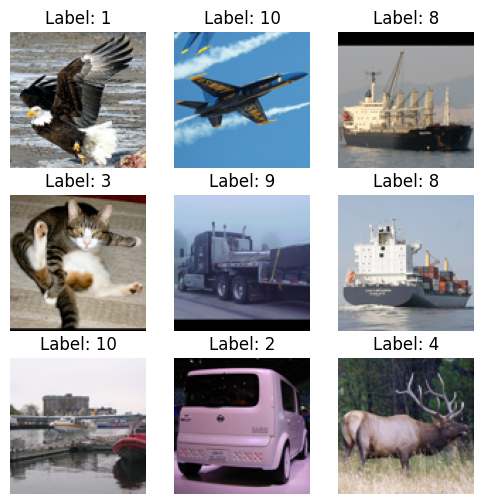


===== testing data =====


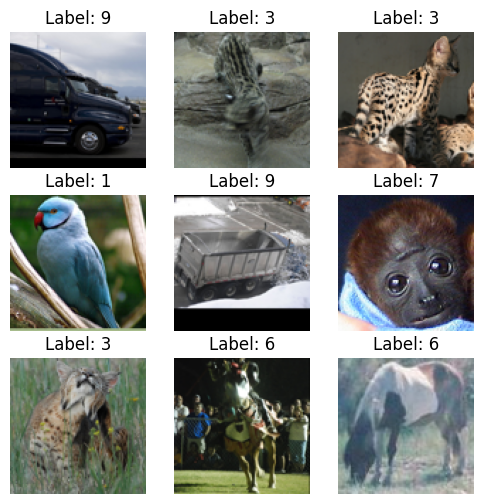

In [11]:
import matplotlib.pyplot as plt

def show_data(image_set, label_set):
  GRID = 3
  plt.figure(figsize=(GRID*2, GRID*2))
  for i in range(GRID*GRID):
      plt.subplot(GRID, GRID, i + 1)
      plt.imshow(image_set[i])
      plt.title(f"Label: {np.argmax(label_set[i]) + 1}")
      plt.axis('off')
  plt.show()

print("===== training data =====")
show_data(x_train, y_train)
print()
print("===== testing data =====")
show_data(x_test, y_test)


In [12]:
print("x_train before normalization:", x_train.shape)
print("x_test before normalization:", x_test.shape)
print()
print(x_train[0][:,:,0])

x_train before normalization: (5000, 96, 96, 3)
x_test before normalization: (8000, 96, 96, 3)

[[136 125 125 ...  98  91  84]
 [138 116 111 ... 118 118  97]
 [129 111 127 ... 113 122 116]
 ...
 [132 129 121 ... 215 192 198]
 [144 127 123 ... 196 200 149]
 [164 148 159 ... 212 168 122]]


In [13]:
# Normalize pixel values to be between 0 and 1
x_train = x_train.astype('float32') / 255.0
x_test = x_test.astype('float32') / 255.0

print("x_train after normalization:", x_train.shape)
print("x_test after normalization:", x_test.shape)
print()
print(np.round(x_train[0][:,:,0],2))

x_train after normalization: (5000, 96, 96, 3)
x_test after normalization: (8000, 96, 96, 3)

[[0.53 0.49 0.49 ... 0.38 0.36 0.33]
 [0.54 0.45 0.44 ... 0.46 0.46 0.38]
 [0.51 0.44 0.5  ... 0.44 0.48 0.45]
 ...
 [0.52 0.51 0.47 ... 0.84 0.75 0.78]
 [0.56 0.5  0.48 ... 0.77 0.78 0.58]
 [0.64 0.58 0.62 ... 0.83 0.66 0.48]]


# standard pooling - average pooling

## develop base model

In [ ]:
def create_model_average_pooling(_pool_size=(2, 2)):
  print('creating model ...')
  print('pool_size', _pool_size)

  model = Sequential()

  model.add(Input(shape=(len(x_train[0]), len(x_train[0][0]), 3)))
  model.add(Conv2D(6, kernel_size=(5, 5), activation='tanh', padding='same', name='conv1'))
  model.add(AveragePooling2D(pool_size=_pool_size, name='pool1'))
  model.add(Conv2D(16, kernel_size=(5, 5), activation='tanh', padding='same', name='conv2'))
  model.add(AveragePooling2D(pool_size=_pool_size, name='pool2'))
  model.add(Conv2D(120, kernel_size=(5, 5), activation='tanh', padding='same', name='conv3'))

  model.add(Flatten())
  model.add(Dense(84, activation='tanh', name='fc1'))
  model.add(Dense(len(y_train[0]), activation='softmax', name='fc2'))

  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

  print('model created')
  return model

## experiment

In [ ]:
def train_model(x_train, y_train, pool_size):
    start_time = time.time()

    print(f"\n=== Experiment: pool_size={pool_size} ===")
    model = create_model_average_pooling(_pool_size=pool_size)

    print("\n=== model summary ===")
    model.summary()

    print("\n=== model training ===")
    history = model.fit(x_train, y_train, batch_size=128, epochs=50, verbose=1)
    cur, peak = get_gpu_memory_info()

    end_time = time.time()
    training_time = end_time - start_time

    return model, history, training_time, cur, peak

def run_experiment(pool_size):
    print("run experiment for average pooling")
    # training process
    model, history, training_time, cur_mb, peak_mb = train_model(x_train, y_train, pool_size)

    # model evaluation
    loss, accuracy = model_evaluation(model, x_test, y_test)

    # inference benchmark
    inference = inference_speed(model, x_test)

    # Store results
    result = {
        'model': model,
        'pool_size': pool_size,
        'test_accuracy': accuracy,
        'training_history': history.history,
        'training_time': training_time,
        'current_mb': cur_mb,
        'peak_mb': peak_mb,
        'inference_benchmark': inference
    }

    return result

results_avg = []
result = run_experiment(pool_size=(2, 2))
results_avg.append(result)

result = run_experiment(pool_size=(3, 3))
results_avg.append(result)

result = run_experiment(pool_size=(4, 4))
results_avg.append(result)

run experiment for average pooling

=== Experiment: pool_size=(2, 2) ===
creating model ...
pool_size (2, 2)
model created

=== model summary ===


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (AveragePooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (AveragePooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 66ms/step - accuracy: 0.1187 - loss: 3.3780
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 23ms/step - accuracy: 0.1988 - loss: 2.1287
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.2711 - loss: 1.9689
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.2979 - loss: 1.8758
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.2990 - loss: 1.8630
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3217 - loss: 1.8353
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3805 - loss: 1.6966
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4038 - loss: 1.6076
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4731 - loss: 1.4904
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5562 - loss: 1.3172
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5727 - loss: 1.2591
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (AveragePooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (AveragePooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 57ms/step - accuracy: 0.1873 - loss: 2.2172
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3341 - loss: 1.8084
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3865 - loss: 1.7009
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4171 - loss: 1.6263
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4410 - loss: 1.5564
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4649 - loss: 1.5010
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4761 - loss: 1.4471
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.5041 - loss: 1.4023
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.5286 - loss: 1.3247
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5531 - loss: 1.2505
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.5964 - loss: 1.1511
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (AveragePooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (AveragePooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 72ms/step - accuracy: 0.1946 - loss: 2.1937
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 16ms/step - accuracy: 0.3166 - loss: 1.8813
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3610 - loss: 1.7603
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3881 - loss: 1.6926
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4020 - loss: 1.6443
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4148 - loss: 1.6192
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4225 - loss: 1.5929
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.4436 - loss: 1.5567
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4649 - loss: 1.5081
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4821 - loss: 1.4683
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5000 - loss: 1.4249
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Full Results Summary ===
Experiment 1:
  pool_size: (2, 2)
  Test Accuracy: 0.3359
  Training History Accuracy: 0.998199999332428
  Training Time: 68.77471876144409
  Current Memory: 91.300608
  Peak Memory: 955.890688
  Inference Benchmark:
    Total Time: 3380.1252841949463
    Average Time per Sample: 422.5156605243683
    Throughput: 2.3667761776189256




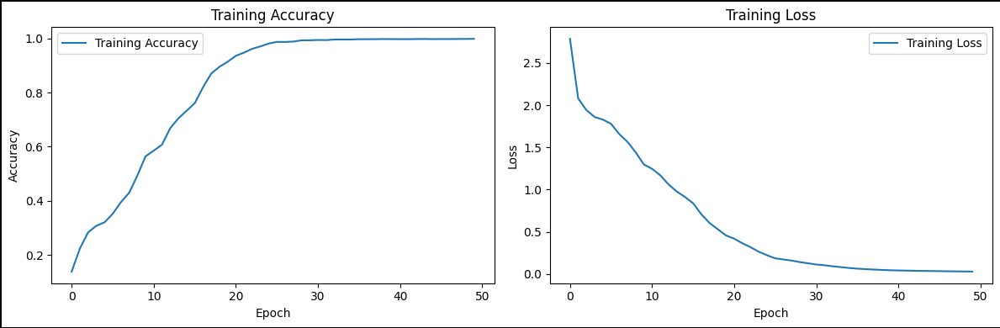


250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


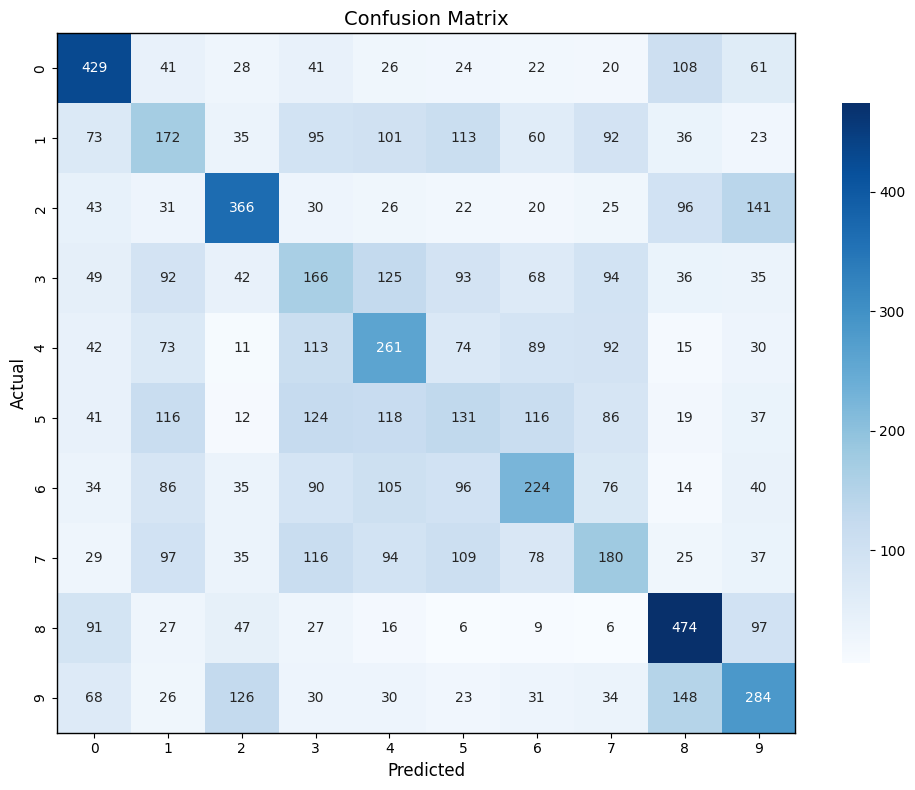

--------------------------------------------------
Experiment 2:
  pool_size: (3, 3)
  Test Accuracy: 0.3861
  Training History Accuracy: 0.9994000196456909
  Training Time: 56.423481702804565
  Current Memory: 104.317184
  Peak Memory: 9188.372736
  Inference Benchmark:
    Total Time: 3083.512783050537
    Average Time per Sample: 385.43909788131714
    Throughput: 2.594443598215135




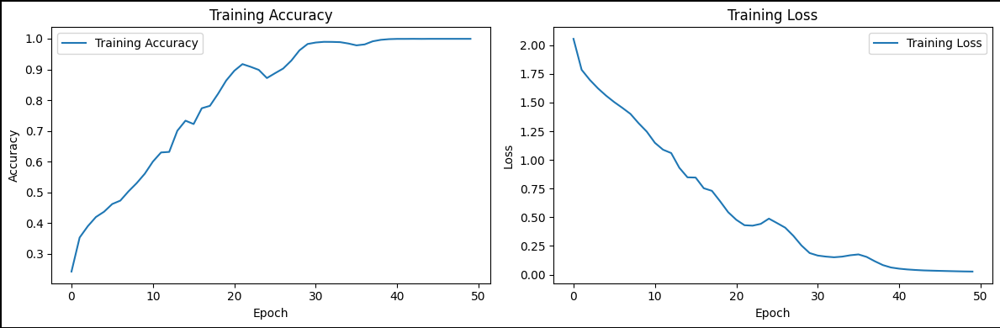


250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


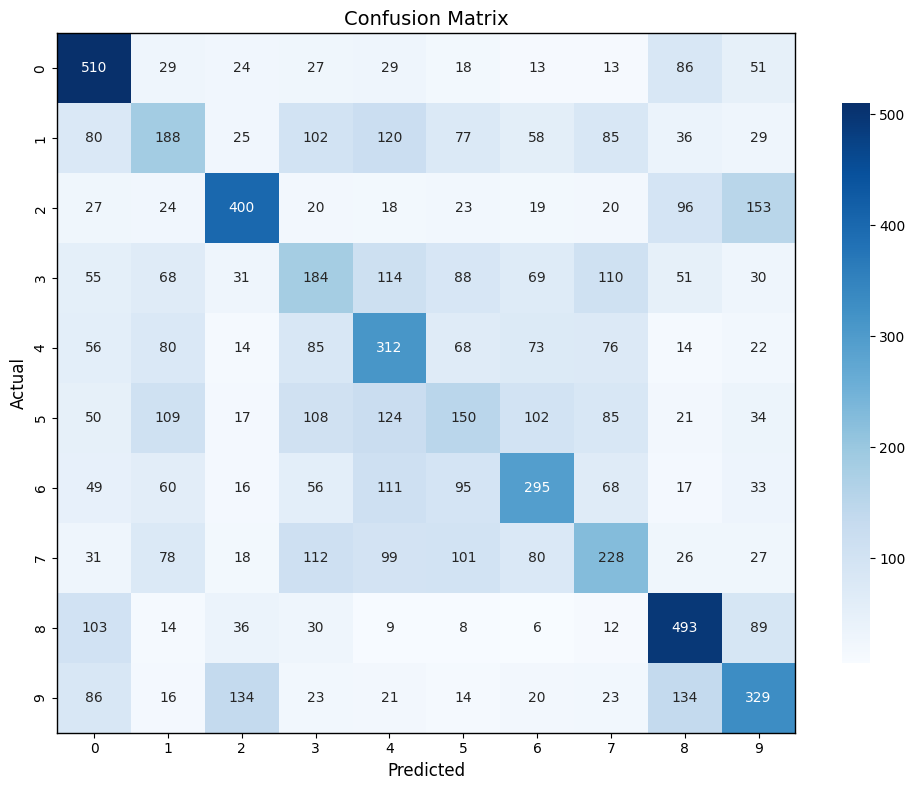

--------------------------------------------------
Experiment 3:
  pool_size: (4, 4)
  Test Accuracy: 0.4175
  Training History Accuracy: 0.7972000241279602
  Training Time: 47.67741632461548
  Current Memory: 111.020544
  Peak Memory: 9188.372736
  Inference Benchmark:
    Total Time: 3411.067008972168
    Average Time per Sample: 426.383376121521
    Throughput: 2.3453071953607214




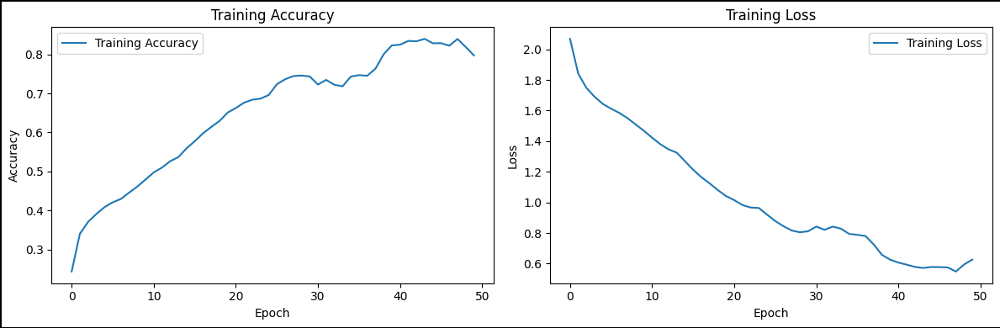


250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


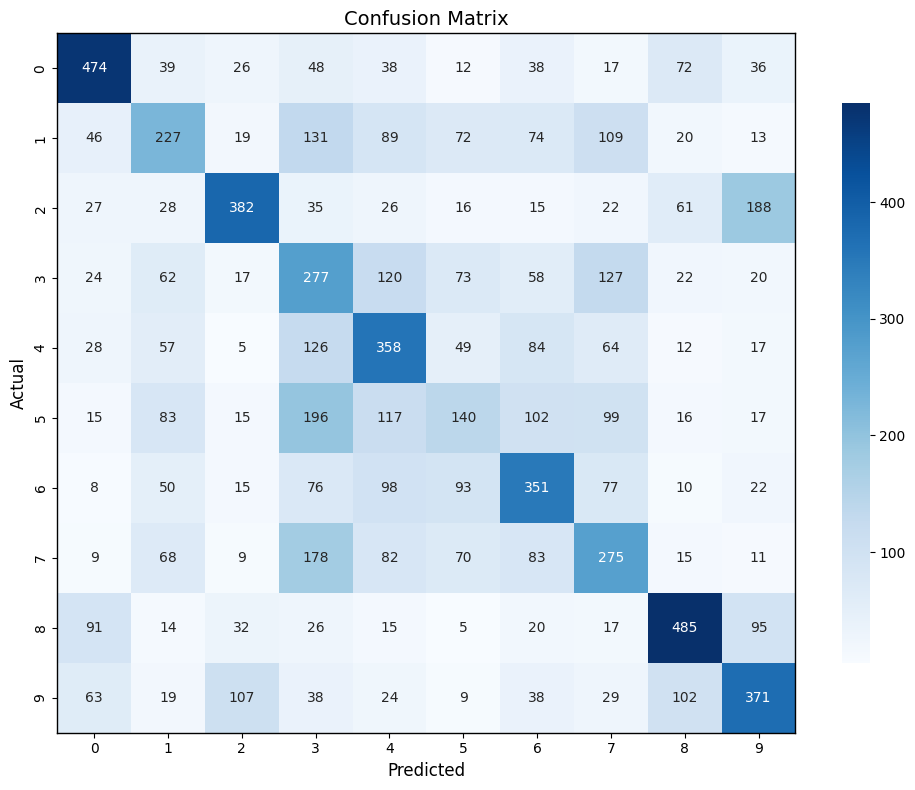

--------------------------------------------------


In [ ]:
print("\n=== Full Results Summary ===")
for idx, result in enumerate(results_avg, 1):
    print(f"Experiment {idx}:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training History Accuracy: {result['training_history']['accuracy'][-1]}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print()
    print()
    show_training_charts(result['training_history'])
    print()
    show_confusion_matrix(result['model'], x_test, y_test)
    print("-" * 50)

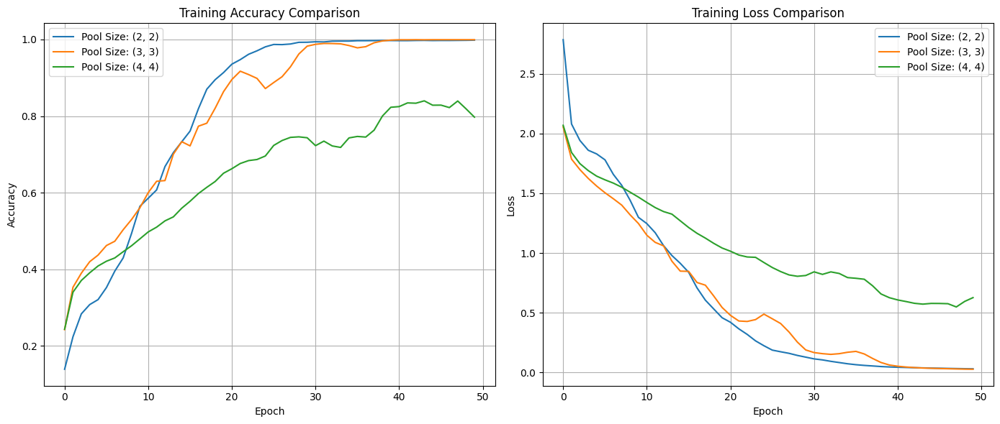

In [ ]:
# Create figure with 2 plots side by side
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# ---- Accuracy subplot ----
for idx, result in enumerate(results_avg):
    axes[0].plot(result['training_history']['accuracy'], label=f"Pool Size: {result['pool_size']}")
axes[0].set_title('Training Accuracy Comparison')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].legend()
axes[0].grid(True)

# ---- Loss subplot ----
for idx, result in enumerate(results_avg):
    axes[1].plot(result['training_history']['loss'], label=f"Pool Size: {result['pool_size']}")
axes[1].set_title('Training Loss Comparison')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].legend()
axes[1].grid(True)

# Show both side by side
plt.tight_layout()
plt.show()


In [ ]:
if SAVE_MODEL:
  for idx, result in enumerate(results_avg):
      model = result['model']
      pool_size = result['pool_size']
      model_name = f"average_pooling_model_poolsize_{pool_size[0]}x{pool_size[1]}.h5"
      model.save(model_name)
      print(f"Saved model: {model_name}")

## prediction

===== testing data with predictions =====
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 210ms/step


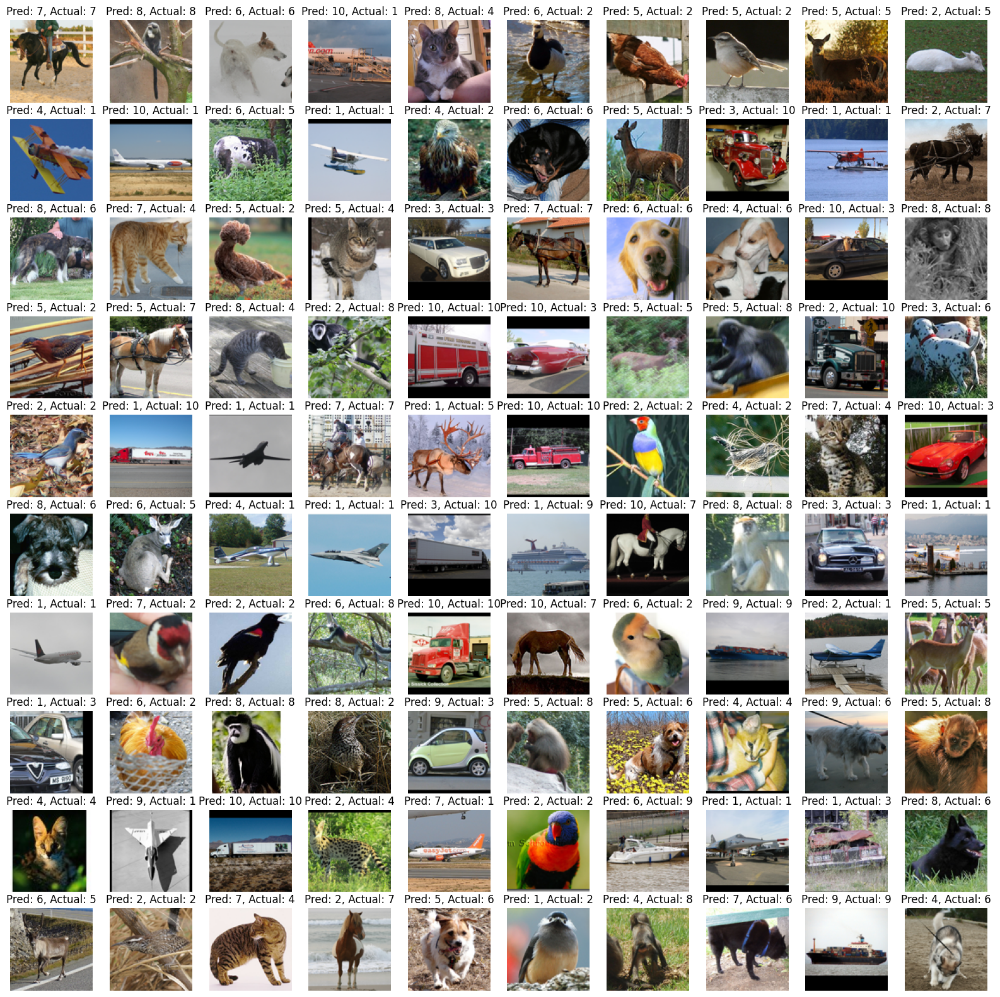

In [ ]:
print("===== testing data with predictions =====")

model = results_avg[2]['model']
show_predictions(model, x_test, y_test)

In [ ]:
play_sound(440, 1.0)

# standard pooling - max pooling

## develop base model

In [ ]:
def create_model_max_pooling(_pool_size=(2, 2)):
  print('creating model ...')
  print('pool_size', _pool_size)

  model = Sequential()

  model.add(Input(shape=(len(x_train[0]), len(x_train[0][0]), 3)))
  model.add(Conv2D(6, kernel_size=(5, 5), activation='tanh', padding='same', name='conv1'))
  model.add(MaxPooling2D(pool_size=_pool_size, name='pool1'))
  model.add(Conv2D(16, kernel_size=(5, 5), activation='tanh', padding='same', name='conv2'))
  model.add(MaxPooling2D(pool_size=_pool_size, name='pool2'))
  model.add(Conv2D(120, kernel_size=(5, 5), activation='tanh', padding='same', name='conv3'))

  model.add(Flatten())
  model.add(Dense(84, activation='tanh', name='fc1'))
  model.add(Dense(len(y_train[0]), activation='softmax', name='fc2'))

  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

  print('model created')
  return model

## experiment

In [ ]:
def train_model(x_train, y_train, pool_size):
    start_time = time.time()

    print(f"\n=== Experiment: pool_size={pool_size} ===")
    model = create_model_max_pooling(_pool_size=pool_size)

    print("\n=== model summary ===")
    model.summary()

    print("\n=== model training ===")
    history = model.fit(x_train, y_train, batch_size=128, epochs=50, verbose=1)
    cur, peak = get_gpu_memory_info()

    end_time = time.time()
    training_time = end_time - start_time

    return model, history, training_time, cur, peak

def run_experiment(pool_size):
    # training process
    model, history, training_time, cur_mb, peak_mb = train_model(x_train, y_train, pool_size)

    # model evaluation
    loss, accuracy = model_evaluation(model, x_test, y_test)

    # inference benchmark
    inference = inference_speed(model, x_test)

    # Store results
    result = {
        'model': model,
        'pool_size': pool_size,
        'test_accuracy': accuracy,
        'training_history': history.history,
        'training_time': training_time,
        'current_mb': cur_mb,
        'peak_mb': peak_mb,
        'inference_benchmark': inference
    }

    return result

results_max = []
result = run_experiment(pool_size=(2, 2))
results_max.append(result)

result = run_experiment(pool_size=(3, 3))
results_max.append(result)

result = run_experiment(pool_size=(4, 4))
results_max.append(result)


=== Experiment: pool_size=(2, 2) ===
creating model ...
pool_size (2, 2)
model created

=== model summary ===


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (MaxPooling2D)            │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (MaxPooling2D)            │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - accuracy: 0.2399 - loss: 2.7196
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5034 - loss: 1.3786
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6549 - loss: 1.0436
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7271 - loss: 0.8658
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7594 - loss: 0.7746
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.8748 - loss: 0.5041
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.9554 - loss: 0.2977
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.9831 - loss: 0.1987
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.9931 - loss: 0.1400
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.9968 - loss: 0.0996
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.9991 - loss: 0.0721
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (MaxPooling2D)            │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (MaxPooling2D)            │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 65ms/step - accuracy: 0.2937 - loss: 2.0556
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4555 - loss: 1.4925
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.5327 - loss: 1.3213
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.5812 - loss: 1.1889
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.6348 - loss: 1.0469
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.6753 - loss: 0.9518
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.7118 - loss: 0.8534
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.7458 - loss: 0.7605
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.7729 - loss: 0.6836
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.8190 - loss: 0.5775
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.8471 - loss: 0.5104
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (MaxPooling2D)            │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (MaxPooling2D)            │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 57ms/step - accuracy: 0.2826 - loss: 2.0099
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4457 - loss: 1.5083
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5095 - loss: 1.3541
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5498 - loss: 1.2394
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.5855 - loss: 1.1462
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6118 - loss: 1.0860
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6333 - loss: 1.0406
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6613 - loss: 0.9625
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6893 - loss: 0.8989
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.6993 - loss: 0.8626
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.7200 - loss: 0.7869
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Full Results Summary ===
Experiment 1:
  pool_size: (2, 2)
  Test Accuracy: 0.4781
  Training History Accuracy: 1.0
  Training Time: 65.13210129737854
  Current Memory: 182.444288
  Peak Memory: 9188.372736
  Inference Benchmark:
    Total Time: 3339.972496032715
    Average Time per Sample: 417.49656200408936
    Throughput: 2.395229304882767




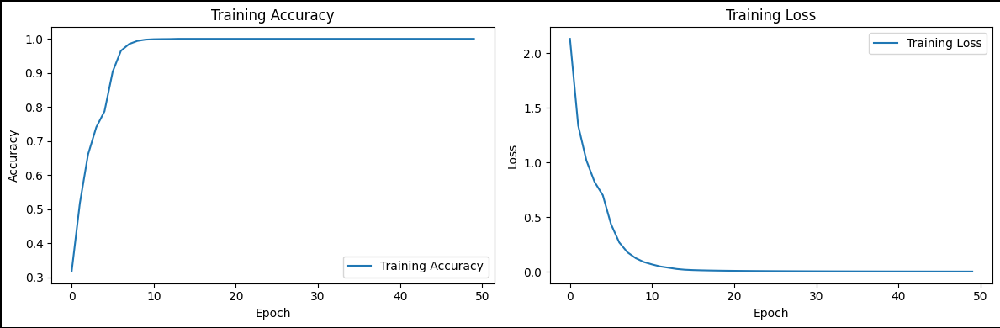

250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


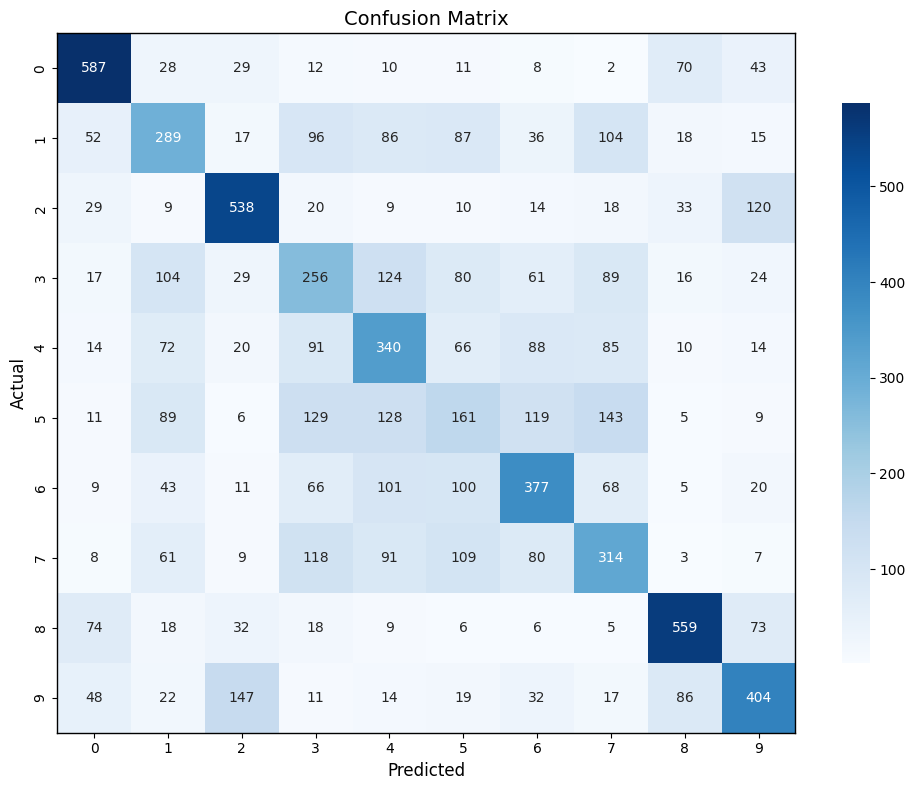

--------------------------------------------------
Experiment 2:
  pool_size: (3, 3)
  Test Accuracy: 0.5251
  Training History Accuracy: 1.0
  Training Time: 54.50909662246704
  Current Memory: 195.435776
  Peak Memory: 9188.372736
  Inference Benchmark:
    Total Time: 3363.696813583374
    Average Time per Sample: 420.46210169792175
    Throughput: 2.378335635867709




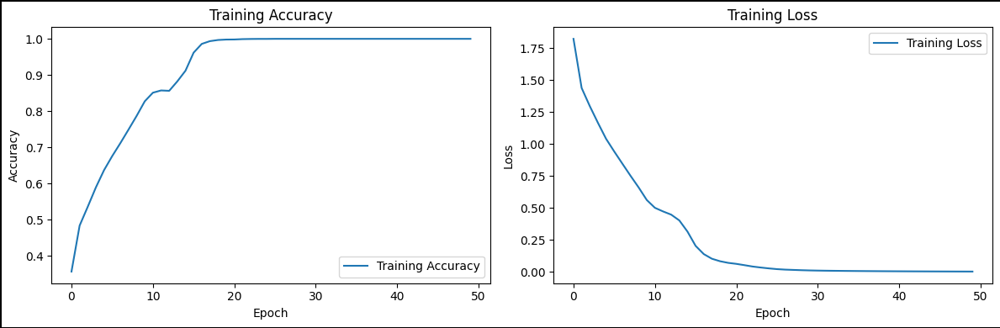


250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


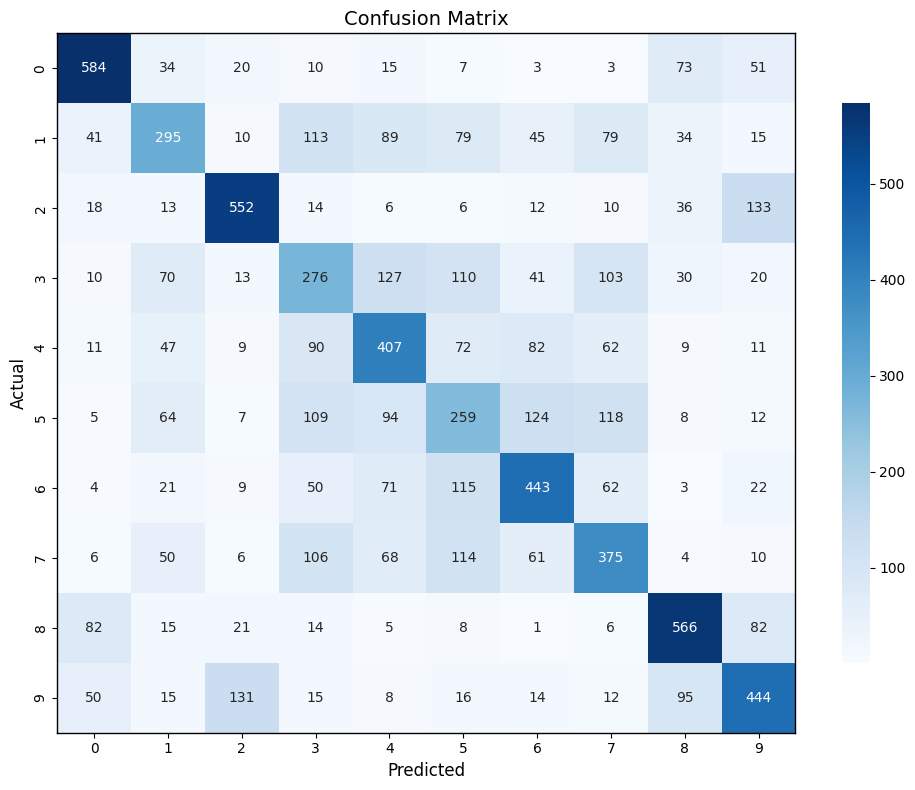

--------------------------------------------------
Experiment 3:
  pool_size: (4, 4)
  Test Accuracy: 0.5577
  Training History Accuracy: 1.0
  Training Time: 52.56940722465515
  Current Memory: 201.651712
  Peak Memory: 9188.372736
  Inference Benchmark:
    Total Time: 3379.7481060028076
    Average Time per Sample: 422.46851325035095
    Throughput: 2.367040308652326




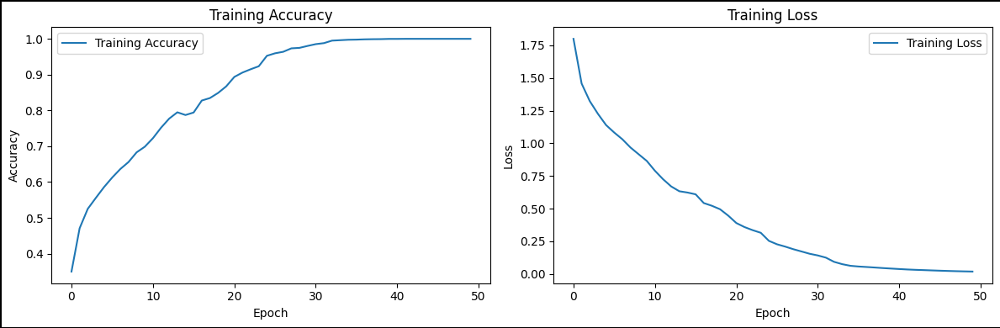


250/250 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


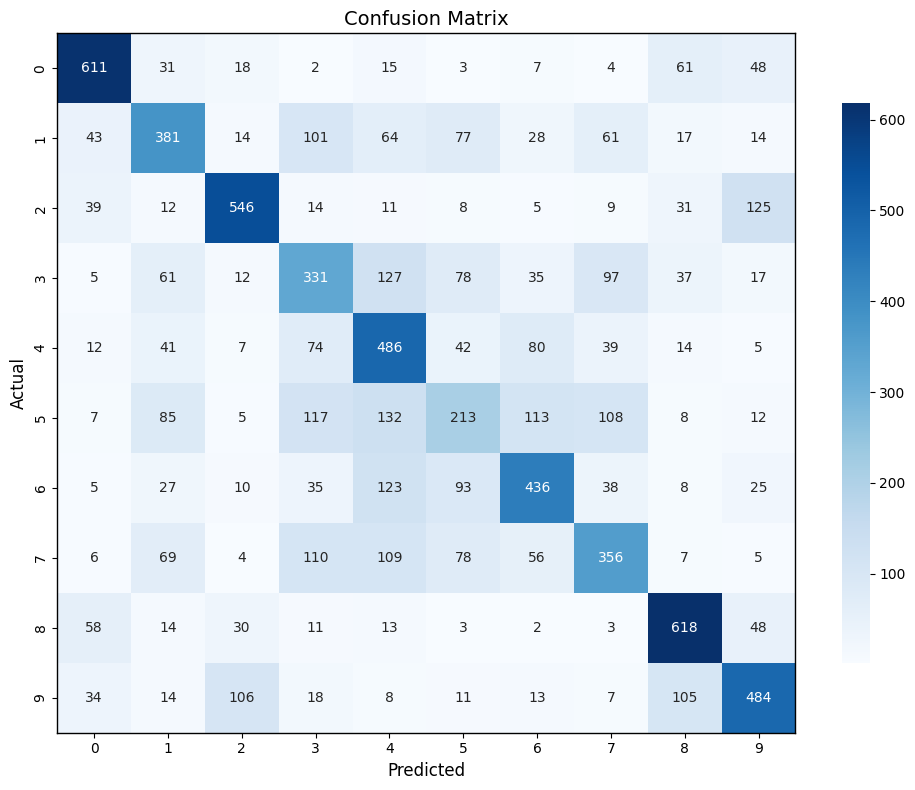

--------------------------------------------------


In [ ]:
print("\n=== Full Results Summary ===")
for idx, result in enumerate(results_max, 1):
    print(f"Experiment {idx}:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training History Accuracy: {result['training_history']['accuracy'][-1]}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print()
    print()
    show_training_charts(result['training_history'])
    print()
    show_confusion_matrix(result['model'], x_test, y_test)
    print("-" * 50)

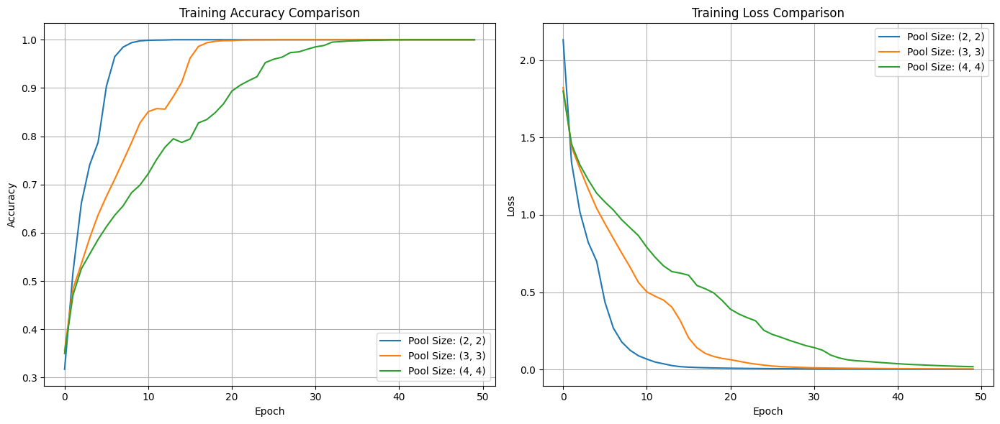

In [ ]:
# Create figure with 2 plots side by side
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# ---- Accuracy subplot ----
for idx, result in enumerate(results_max):
    axes[0].plot(result['training_history']['accuracy'], label=f"Pool Size: {result['pool_size']}")
axes[0].set_title('Training Accuracy Comparison')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].legend()
axes[0].grid(True)

# ---- Loss subplot ----
for idx, result in enumerate(results_max):
    axes[1].plot(result['training_history']['loss'], label=f"Pool Size: {result['pool_size']}")
axes[1].set_title('Training Loss Comparison')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].legend()
axes[1].grid(True)

# Show both side by side
plt.tight_layout()
plt.show()


In [ ]:
if SAVE_MODEL:
  for idx, result in enumerate(results_max):
      model = result['model']
      pool_size = result['pool_size']
      model_name = f"max_pooling_model_poolsize_{pool_size[0]}x{pool_size[1]}.h5"
      model.save(model_name)
      print(f"Saved model: {model_name}")

## prediction

===== testing data with predictions =====
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 203ms/step


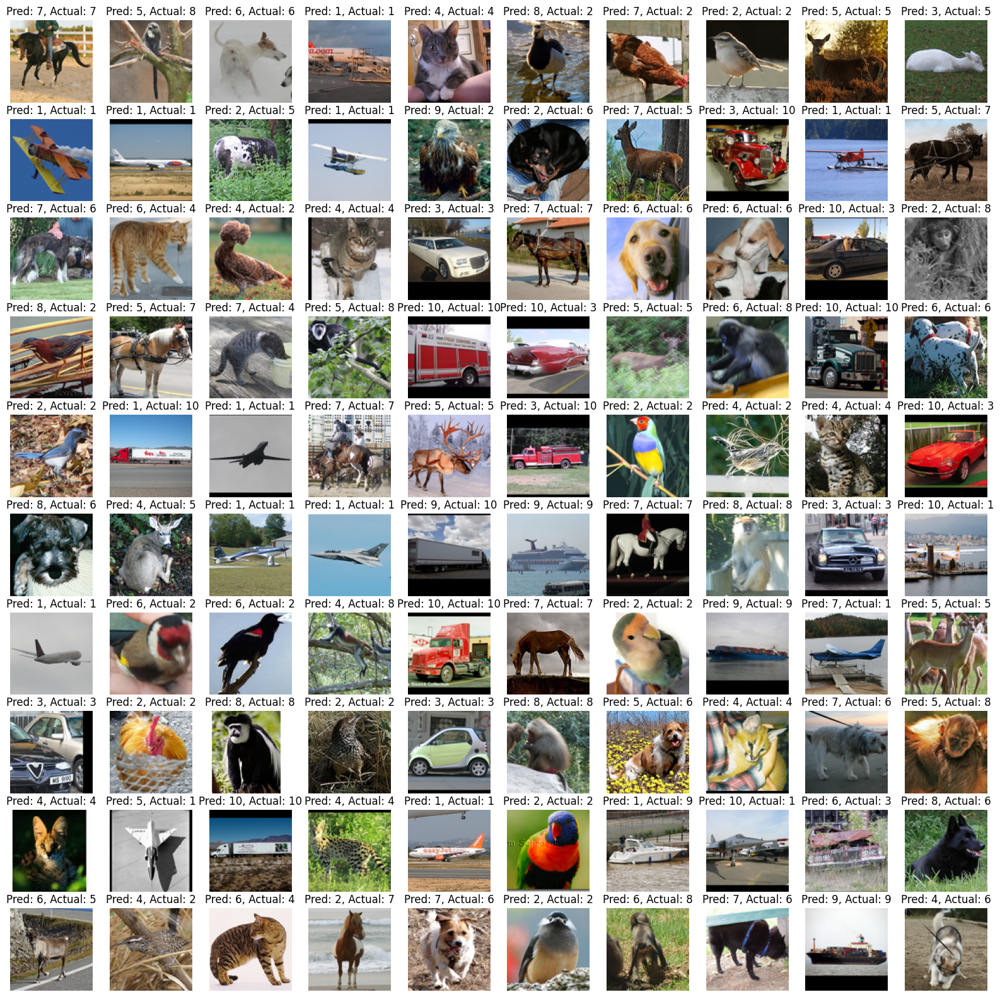

In [ ]:
print("===== testing data with predictions =====")
model = results_max[2]['model']
show_predictions(model, x_test, y_test)

In [ ]:
play_sound(440, 1.0)

# t-max-avg pooling

## custom pooling development

In [ ]:
import tensorflow as tf

class TMaxAvgPooling2D(tf.keras.layers.Layer):
    def __init__(self, pool_size=(2, 2), k=2, t=0.7, **kwargs):
        super(TMaxAvgPooling2D, self).__init__(**kwargs)
        self.pool_size = pool_size
        self.k = k
        self.t = t

    def call(self, inputs):
        patches = tf.image.extract_patches(
            images=inputs,
            sizes=[1, *self.pool_size, 1],
            strides=[1, *self.pool_size, 1],
            rates=[1, 1, 1, 1],
            padding='VALID'
        )
        batch, out_h, out_w, depth = tf.shape(patches)[0], tf.shape(patches)[1], tf.shape(patches)[2], tf.shape(patches)[3]
        ksize = self.pool_size[0] * self.pool_size[1]
        channels = tf.shape(inputs)[-1]

        patches = tf.reshape(patches, [batch, out_h, out_w, ksize, channels])

        # get top-k
        sorted_vals = tf.sort(patches, direction='DESCENDING', axis=3)
        topk = sorted_vals[:, :, :, :self.k, :]

        # check if all top-k > threshold
        condition = tf.reduce_all(topk > self.t, axis=3)  # shape: [batch, out_h, out_w, channels]
        condition = tf.cast(condition, tf.float32)

        max_vals = tf.reduce_max(topk, axis=3)
        avg_vals = tf.reduce_mean(topk, axis=3)

        output = condition * max_vals + (1.0 - condition) * avg_vals
        return output

    def get_config(self):
        config = super().get_config()
        config.update({
            'pool_size': self.pool_size,
            'k': self.k,
            't': self.t
        })
        return config


## develop base model

In [ ]:
def create_model(
                 _pool_size=(2, 2),
                 _k=2,
                 _t=0.7):
  print('creating model ...')
  print('pool_size', _pool_size)
  print('k', _k)
  print('t', _t)

  model = Sequential()

  model.add(Input(shape=(96, 96, 3)))
  model.add(Conv2D(6, kernel_size=(5, 5), activation='tanh', padding='same', name='conv1'))
  model.add(TMaxAvgPooling2D(pool_size=_pool_size, k=_k, t=_t, name='pool1'))
  model.add(Conv2D(16, kernel_size=(5, 5), activation='tanh', padding='same', name='conv2'))
  model.add(TMaxAvgPooling2D(pool_size=_pool_size, k=_k, t=_t, name='pool2'))
  model.add(Conv2D(120, kernel_size=(5, 5), activation='tanh', padding='same', name='conv3'))

  model.add(Flatten())
  model.add(Dense(84, activation='tanh', name='fc1'))
  model.add(Dense(len(y_train[0]), activation='softmax', name='fc2'))

  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

  print('model created')
  return model


## experiment

In [ ]:
def train_model(x_train, y_train, pool_size, k, t):
    start_time = time.time()

    print(f"\n=== Experiment: pool_size={pool_size}, k={k}, t={t} ===")
    model = create_model(_pool_size=pool_size, _k=k, _t=t)

    print("\n=== model summary ===")
    model.summary()

    print("\n=== model training ===")
    history = model.fit(x_train, y_train, batch_size=128, epochs=50, verbose=1)
    cur, peak = get_gpu_memory_info()

    end_time = time.time()
    training_time = end_time - start_time

    return model, history, training_time, cur, peak

def run_experiment(pool_size, k, t):
    # training process
    model, history, training_time, cur_mb, peak_mb = train_model(x_train, y_train, pool_size, k, t)

    # model evaluation
    loss, accuracy = model_evaluation(model, x_test, y_test)

    # inference benchmark
    inference = inference_speed(model, x_test)

    # Store results
    result = {
        'model': model,
        'pool_size': pool_size,
        'k': k,
        't': t,
        'test_accuracy': accuracy,
        'training_history': history.history,
        'training_time': training_time,
        'current_mb': cur_mb,
        'peak_mb': peak_mb,
        'inference_benchmark': inference
    }

    return result



In [ ]:
results_tmaxavg = []
result = run_experiment(pool_size=(2, 2), k=1, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(2, 2), k=2, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(2, 2), k=3, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(3, 3), k=2, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(3, 3), k=3, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(3, 3), k=4, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(3, 3), k=5, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(3, 3), k=6, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=2, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=3, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=4, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=5, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=6, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=7, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=8, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=9, t=0.7)
results_tmaxavg.append(result)

result = run_experiment(pool_size=(4, 4), k=10, t=0.7)
results_tmaxavg.append(result)


=== Experiment: pool_size=(2, 2), k=1, t=0.7 ===
creating model ...
pool_size (2, 2)
k 1
t 0.7
model created

=== model summary ===


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 12s 94ms/step - accuracy: 0.1229 - loss: 3.5032
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.2313 - loss: 2.0295
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.2621 - loss: 1.8948
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - accuracy: 0.2885 - loss: 1.8314
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.3349 - loss: 1.7134
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.3884 - loss: 1.6305
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.4014 - loss: 1.5879
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.4552 - loss: 1.4643
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.5035 - loss: 1.3606
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.5749 - loss: 1.2031
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.6533 - loss: 1.0535
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 78ms/step - accuracy: 0.1764 - loss: 3.1940
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.3249 - loss: 1.7930
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.4495 - loss: 1.5178
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.5425 - loss: 1.2818
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.6434 - loss: 1.0697
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7158 - loss: 0.8961
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.7912 - loss: 0.7314
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8149 - loss: 0.6493
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8703 - loss: 0.5067
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.9470 - loss: 0.3403
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.9660 - loss: 0.2532
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 78ms/step - accuracy: 0.1338 - loss: 3.9477
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2537 - loss: 2.0309
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.3014 - loss: 1.8785
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3378 - loss: 1.8066
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3824 - loss: 1.6588
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.4527 - loss: 1.5180
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.5367 - loss: 1.3348
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.6047 - loss: 1.2043
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.6349 - loss: 1.0921
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.7168 - loss: 0.9269
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7183 - loss: 0.8783
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 76ms/step - accuracy: 0.2690 - loss: 2.0155
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4620 - loss: 1.4774
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5497 - loss: 1.2790
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6101 - loss: 1.1172
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6551 - loss: 1.0006
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6973 - loss: 0.8923
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7361 - loss: 0.8011
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7607 - loss: 0.7282
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7766 - loss: 0.6832
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7909 - loss: 0.6176
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.8498 - loss: 0.5006
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 72ms/step - accuracy: 0.2804 - loss: 2.0933
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4469 - loss: 1.5075
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5118 - loss: 1.3571
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.5692 - loss: 1.2250
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5975 - loss: 1.1288
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6216 - loss: 1.0494
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6660 - loss: 0.9552
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6920 - loss: 0.8795
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7148 - loss: 0.8071
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7464 - loss: 0.7209
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7653 - loss: 0.6762
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Experiment: pool_size=(3, 3), k=4, t=0.7 ===
creating model ...
pool_size (3, 3)
k 4
t 0.7
model created

=== model summary ===


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 71ms/step - accuracy: 0.2379 - loss: 2.1486
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4231 - loss: 1.5695
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4873 - loss: 1.4239
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5076 - loss: 1.3839
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5632 - loss: 1.2160
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5992 - loss: 1.1115
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6317 - loss: 1.0262
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6528 - loss: 0.9507
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6949 - loss: 0.8649
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7370 - loss: 0.7782
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7588 - loss: 0.7180
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Experiment: pool_size=(3, 3), k=5, t=0.7 ===
creating model ...
pool_size (3, 3)
k 5
t 0.7
model created

=== model summary ===


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 75ms/step - accuracy: 0.2537 - loss: 2.1459
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4033 - loss: 1.6252
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4762 - loss: 1.4557
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5277 - loss: 1.3256
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5702 - loss: 1.2036
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6091 - loss: 1.0942
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6558 - loss: 0.9885
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6732 - loss: 0.9237
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7123 - loss: 0.8400
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7425 - loss: 0.7603
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7632 - loss: 0.6988
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 74ms/step - accuracy: 0.2347 - loss: 2.2633
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.3980 - loss: 1.6335
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4509 - loss: 1.4992
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4984 - loss: 1.3797
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5391 - loss: 1.3055
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5756 - loss: 1.2103
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5927 - loss: 1.1154
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6313 - loss: 1.0620
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6376 - loss: 1.0060
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6670 - loss: 0.9373
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6983 - loss: 0.8713
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 70ms/step - accuracy: 0.2415 - loss: 2.0758
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4301 - loss: 1.5589
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4828 - loss: 1.4234
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5374 - loss: 1.2959
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5674 - loss: 1.2128
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5830 - loss: 1.1509
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5931 - loss: 1.1141
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6148 - loss: 1.0638
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6515 - loss: 0.9877
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6723 - loss: 0.9218
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6975 - loss: 0.8772
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 68ms/step - accuracy: 0.2598 - loss: 2.0353
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4561 - loss: 1.4912
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5007 - loss: 1.3773
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5406 - loss: 1.2733
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5672 - loss: 1.1953
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5899 - loss: 1.1272
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6158 - loss: 1.0671
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6344 - loss: 1.0340
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6478 - loss: 0.9861
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6806 - loss: 0.9320
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6881 - loss: 0.8796
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 65ms/step - accuracy: 0.2536 - loss: 2.0849
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - accuracy: 0.4112 - loss: 1.5756
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4849 - loss: 1.4095
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5150 - loss: 1.3157
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5517 - loss: 1.2262
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5751 - loss: 1.1654
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5969 - loss: 1.1024
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6233 - loss: 1.0411
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6336 - loss: 1.0166
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6588 - loss: 0.9498
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6770 - loss: 0.8985
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.2394 - loss: 2.0595
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4342 - loss: 1.5413
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5095 - loss: 1.3980
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5406 - loss: 1.2891
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5725 - loss: 1.2054
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5981 - loss: 1.1389
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6104 - loss: 1.0862
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6359 - loss: 1.0415
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6322 - loss: 1.0234
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6603 - loss: 0.9566
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6762 - loss: 0.9233
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 89ms/step - accuracy: 0.1822 - loss: 2.3436
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - accuracy: 0.3639 - loss: 1.7358
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4281 - loss: 1.5694
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4650 - loss: 1.4759
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5027 - loss: 1.3739
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5443 - loss: 1.2684
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5547 - loss: 1.2119
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5722 - loss: 1.1653
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6028 - loss: 1.1078
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6137 - loss: 1.0794
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6441 - loss: 1.0331
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 93ms/step - accuracy: 0.2432 - loss: 2.0478
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 21ms/step - accuracy: 0.4323 - loss: 1.5596
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4780 - loss: 1.4254
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5219 - loss: 1.3212
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5528 - loss: 1.2435
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5741 - loss: 1.1714
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5912 - loss: 1.1152
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6159 - loss: 1.0703
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6283 - loss: 1.0309
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6487 - loss: 0.9712
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6513 - loss: 0.9546
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 68ms/step - accuracy: 0.2123 - loss: 2.1685
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3832 - loss: 1.6594
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4563 - loss: 1.4899
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4744 - loss: 1.4107
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4990 - loss: 1.3372
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5347 - loss: 1.2916
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5567 - loss: 1.2273
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5701 - loss: 1.1808
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5915 - loss: 1.1267
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6063 - loss: 1.0857
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6254 - loss: 1.0415
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 68ms/step - accuracy: 0.2263 - loss: 2.1059
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3892 - loss: 1.6649
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4268 - loss: 1.5286
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4923 - loss: 1.4148
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5079 - loss: 1.3648
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5329 - loss: 1.3050
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5497 - loss: 1.2457
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5657 - loss: 1.1972
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5860 - loss: 1.1480
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5997 - loss: 1.1080
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6127 - loss: 1.0804
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 77ms/step - accuracy: 0.1959 - loss: 2.2130
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - accuracy: 0.3643 - loss: 1.7302
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4396 - loss: 1.5443
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4683 - loss: 1.4485
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4909 - loss: 1.3916
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5161 - loss: 1.3255
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5405 - loss: 1.2623
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5545 - loss: 1.2181
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5772 - loss: 1.1664
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5929 - loss: 1.1193
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6073 - loss: 1.0799
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Full Results Summary ===
Experiment 1:
  pool_size: (2, 2)
  Test Accuracy: 0.4726
  Training History Accuracy: 1.0
  Training Time: 107.61290788650513
  Current Memory: 91.356416
  Peak Memory: 1034.414848
  Inference Benchmark:
    Total Time: 3635.8370780944824
    Average Time per Sample: 454.4796347618103
    Throughput: 2.200318613889252




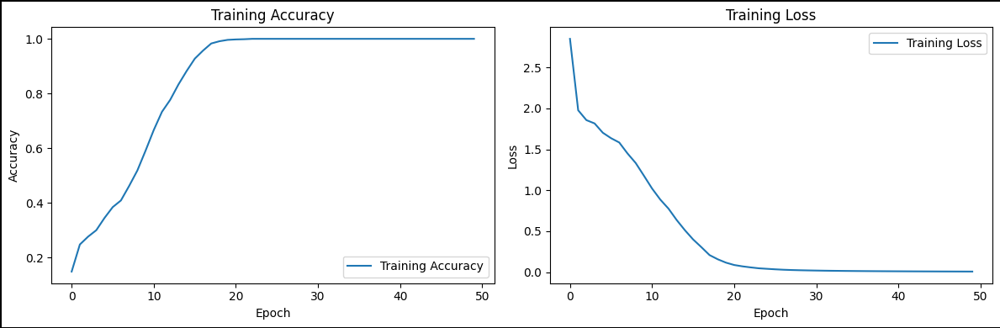


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


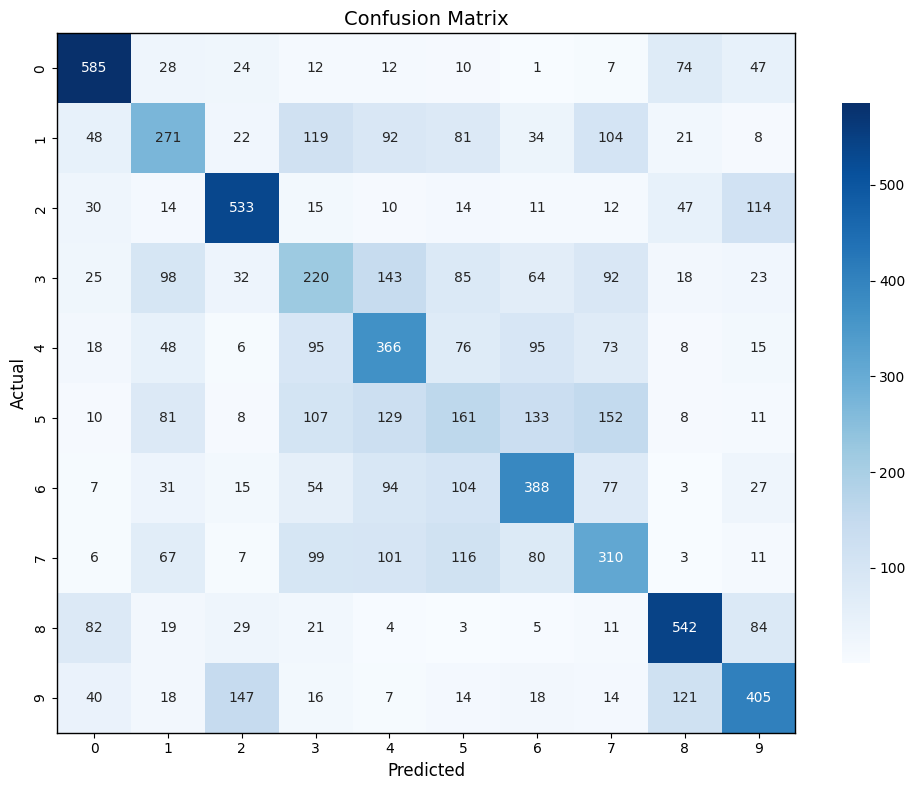

--------------------------------------------------
Experiment 2:
  pool_size: (2, 2)
  Test Accuracy: 0.4670
  Training History Accuracy: 1.0
  Training Time: 100.14501476287842
  Current Memory: 162.02496
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4565.45615196228
    Average Time per Sample: 570.682018995285
    Throughput: 1.7522893077313901




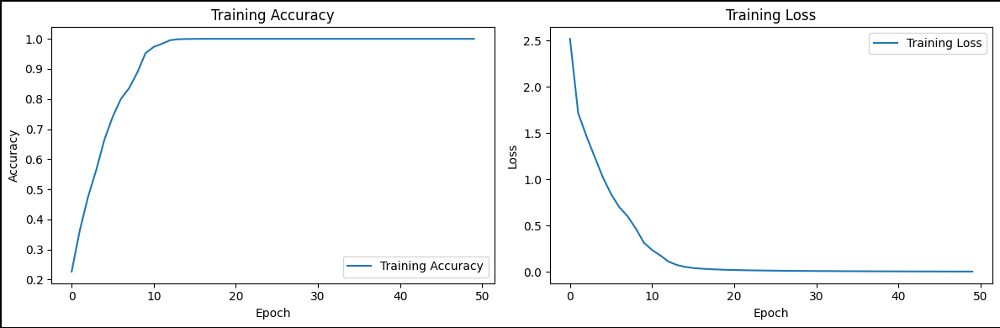


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


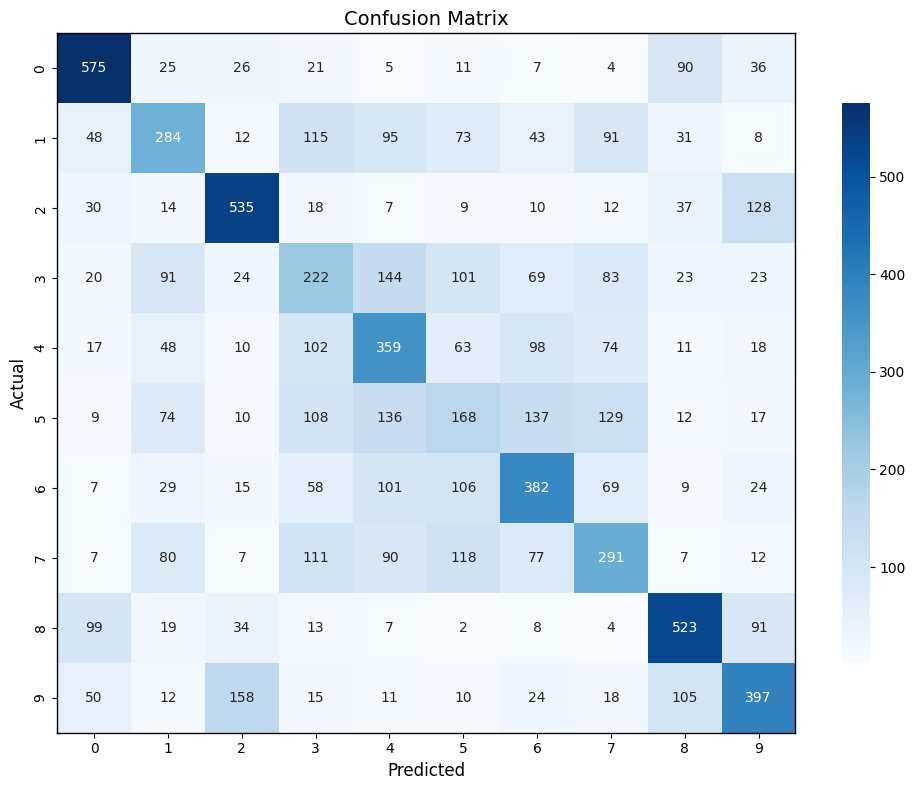

--------------------------------------------------
Experiment 3:
  pool_size: (2, 2)
  Test Accuracy: 0.4058
  Training History Accuracy: 0.9998000264167786
  Training Time: 105.38207030296326
  Current Memory: 259.097856
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4604.252338409424
    Average Time per Sample: 575.531542301178
    Throughput: 1.7375242302127307




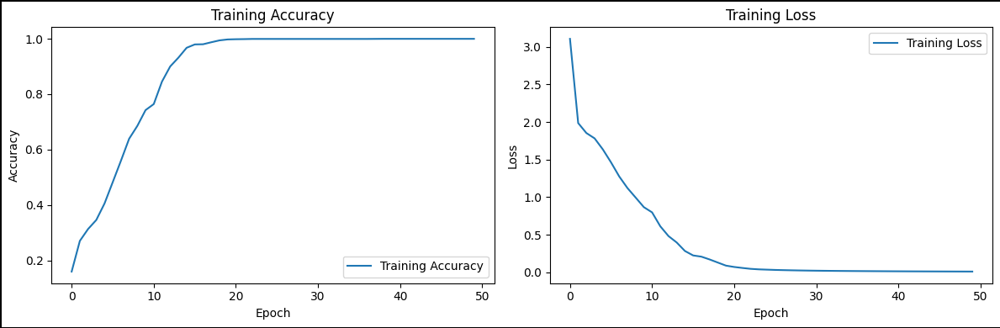


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


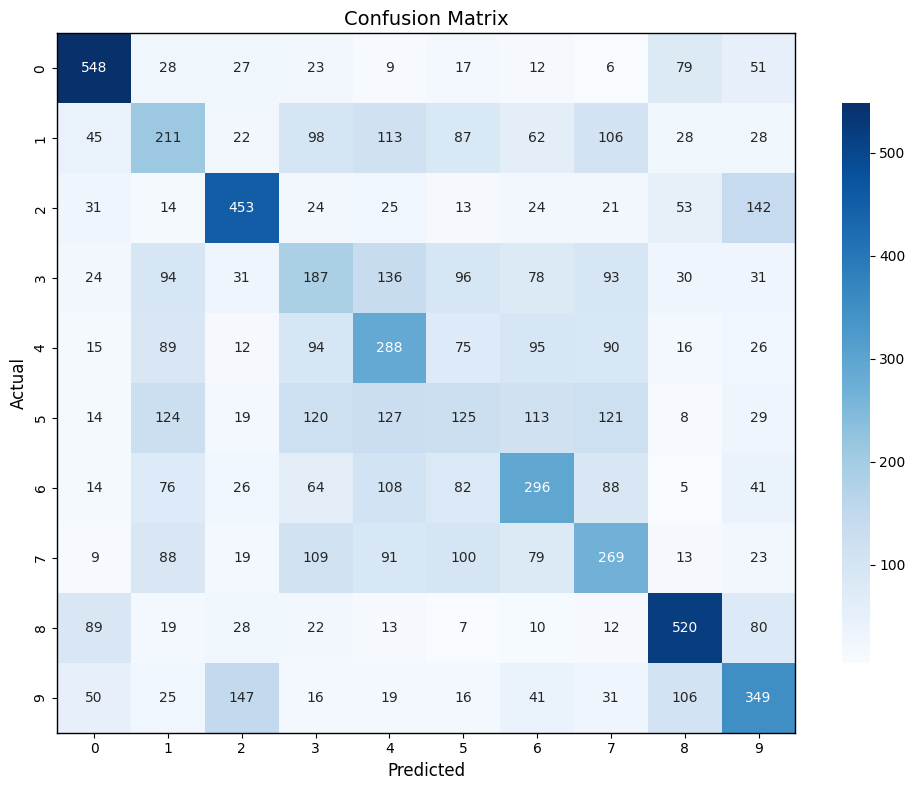

--------------------------------------------------
Experiment 4:
  pool_size: (3, 3)
  Test Accuracy: 0.5257
  Training History Accuracy: 1.0
  Training Time: 64.91727066040039
  Current Memory: 272.935936
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3754.1537284851074
    Average Time per Sample: 469.2692160606384
    Throughput: 2.1309729378685285




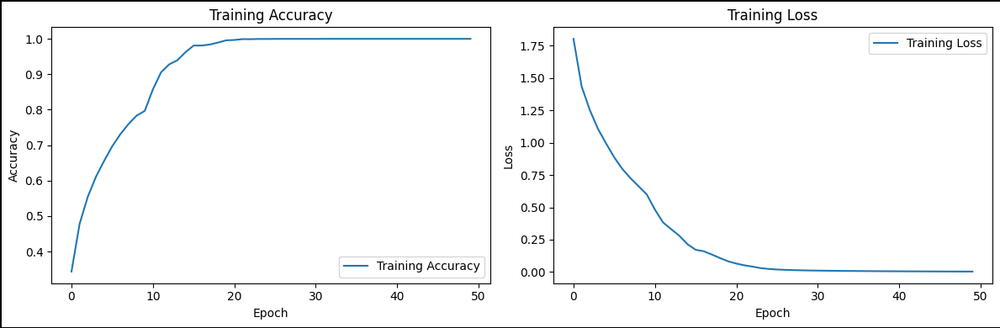


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


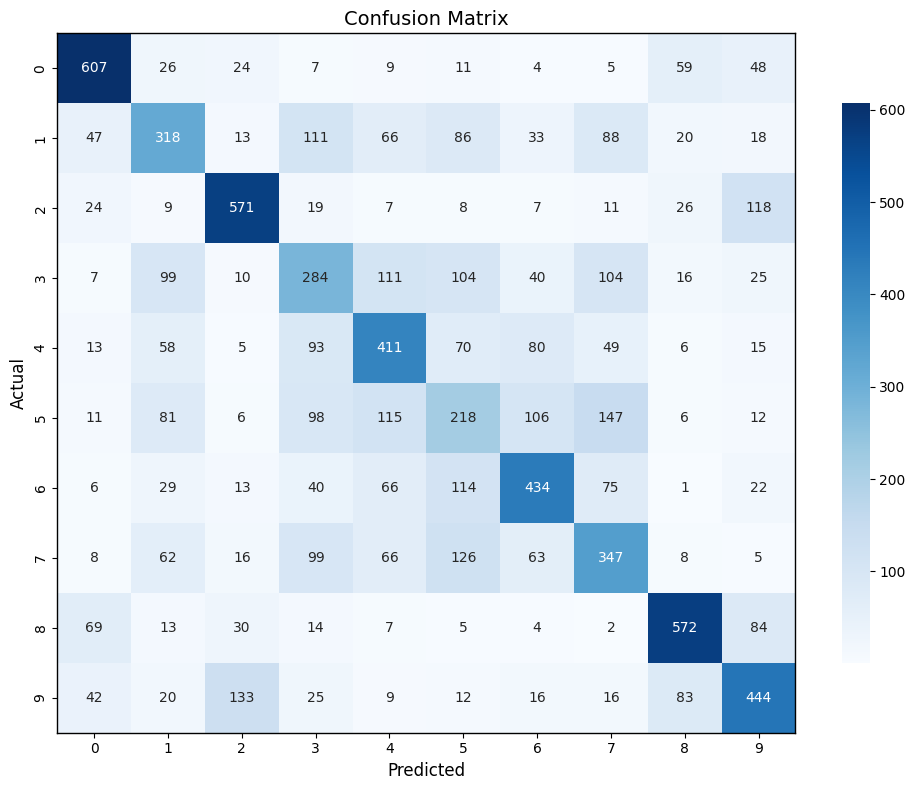

--------------------------------------------------
Experiment 5:
  pool_size: (3, 3)
  Test Accuracy: 0.5280
  Training History Accuracy: 1.0
  Training Time: 62.99697804450989
  Current Memory: 289.220352
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4783.265590667725
    Average Time per Sample: 597.9081988334656
    Throughput: 1.6724975538904232




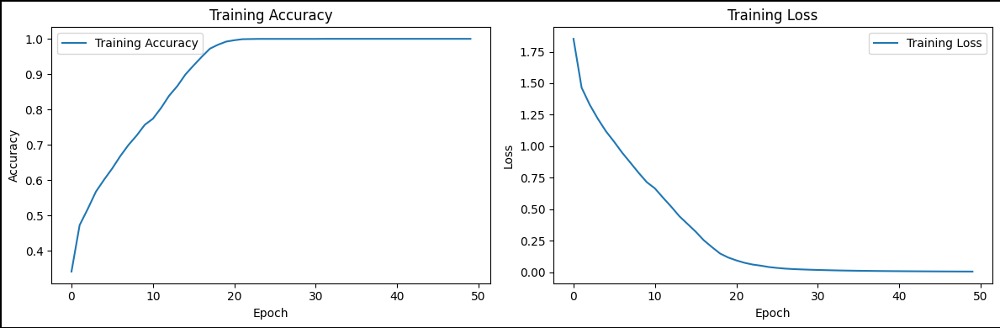


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


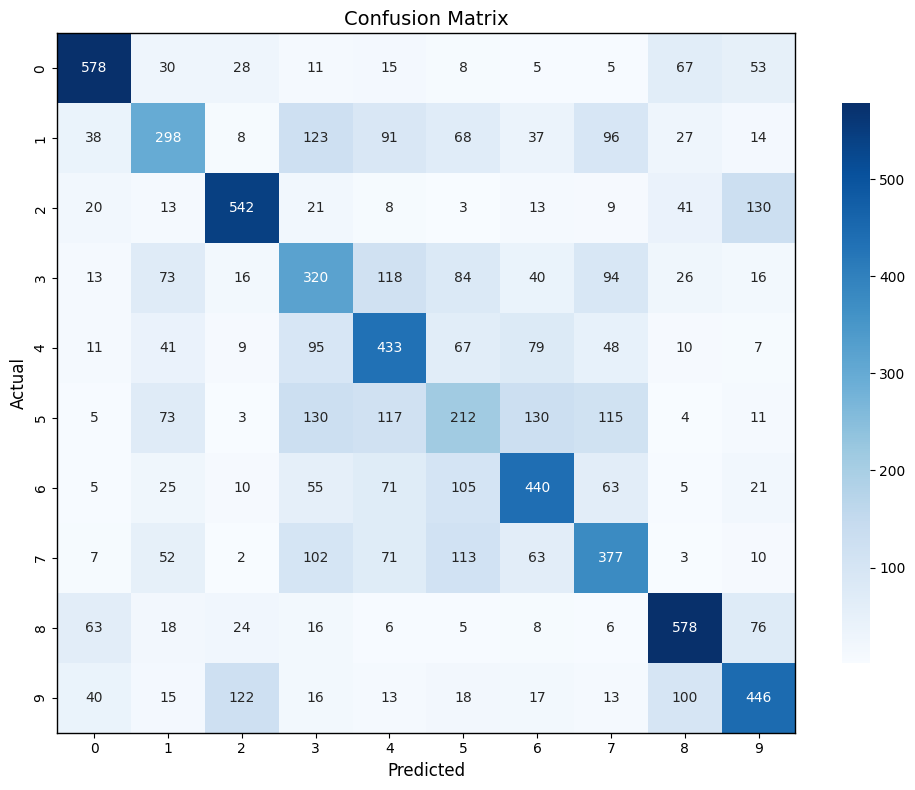

--------------------------------------------------
Experiment 6:
  pool_size: (3, 3)
  Test Accuracy: 0.5347
  Training History Accuracy: 1.0
  Training Time: 64.71199417114258
  Current Memory: 302.274048
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3567.6732063293457
    Average Time per Sample: 445.9591507911682
    Throughput: 2.2423578442687355




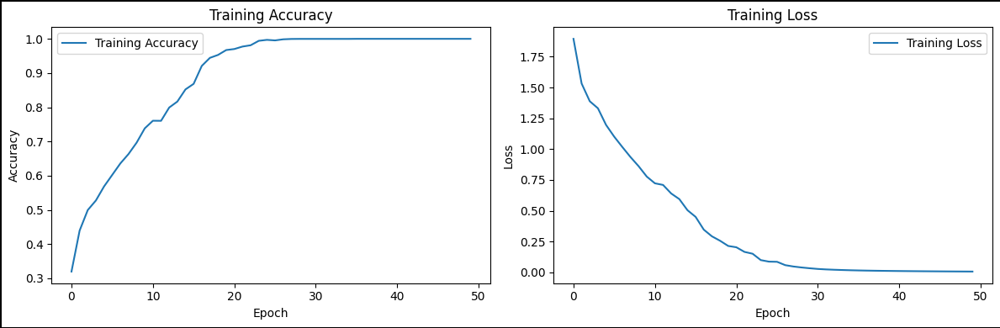


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


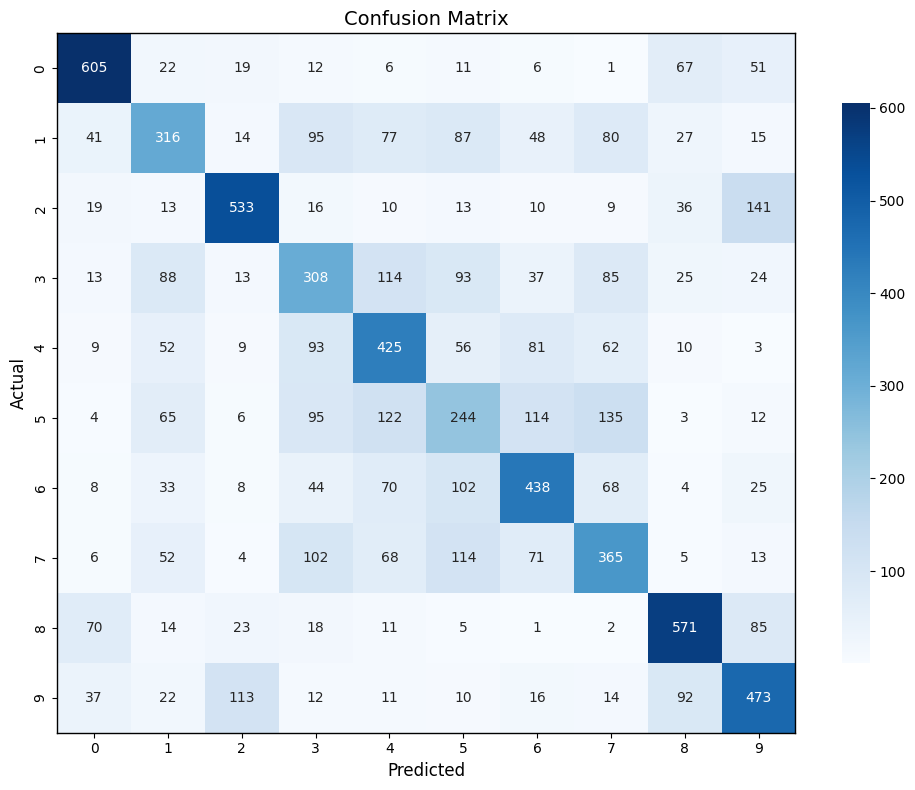

--------------------------------------------------
Experiment 7:
  pool_size: (3, 3)
  Test Accuracy: 0.5316
  Training History Accuracy: 1.0
  Training Time: 63.469778299331665
  Current Memory: 318.212608
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4613.387107849121
    Average Time per Sample: 576.6733884811401
    Throughput: 1.7340838331968644




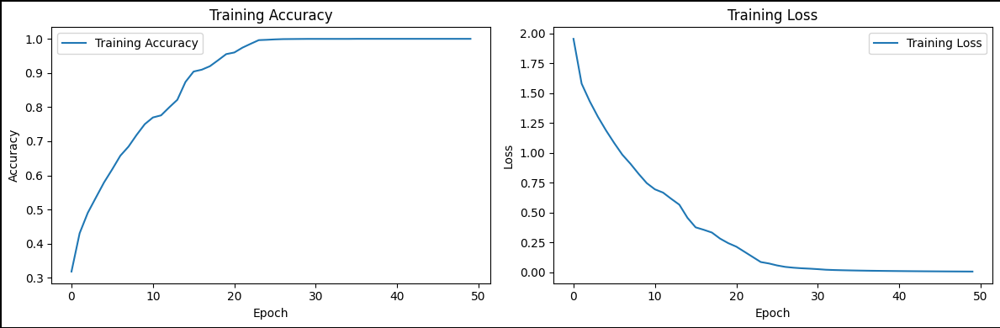


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step


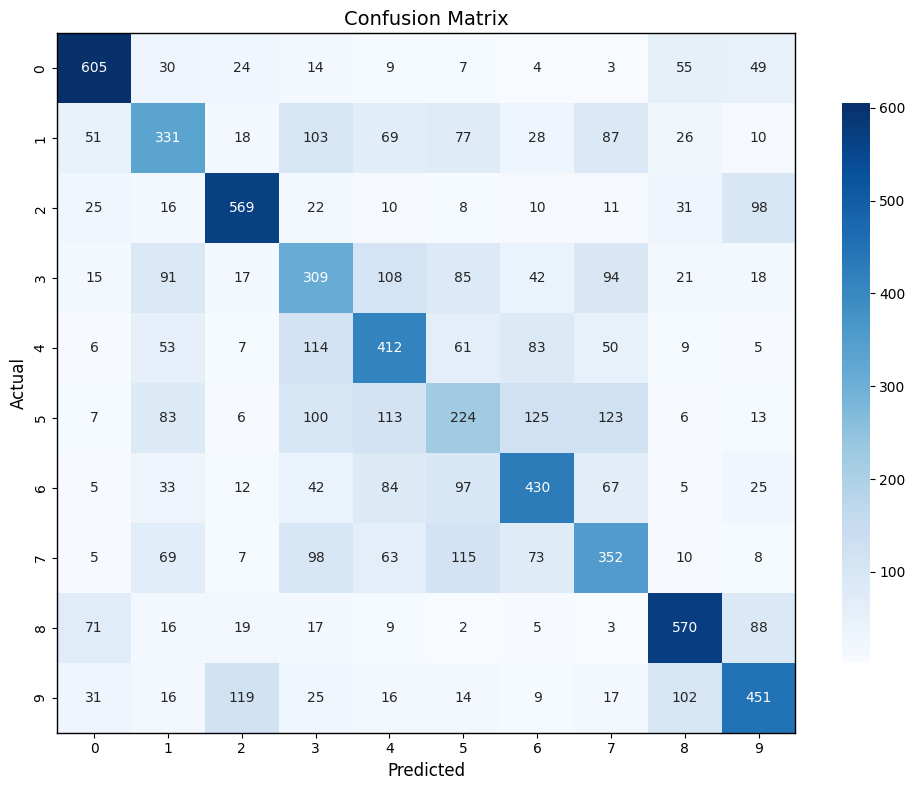

--------------------------------------------------
Experiment 8:
  pool_size: (3, 3)
  Test Accuracy: 0.5114
  Training History Accuracy: 1.0
  Training Time: 63.482455253601074
  Current Memory: 331.264256
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4626.469135284424
    Average Time per Sample: 578.308641910553
    Throughput: 1.729180454050123




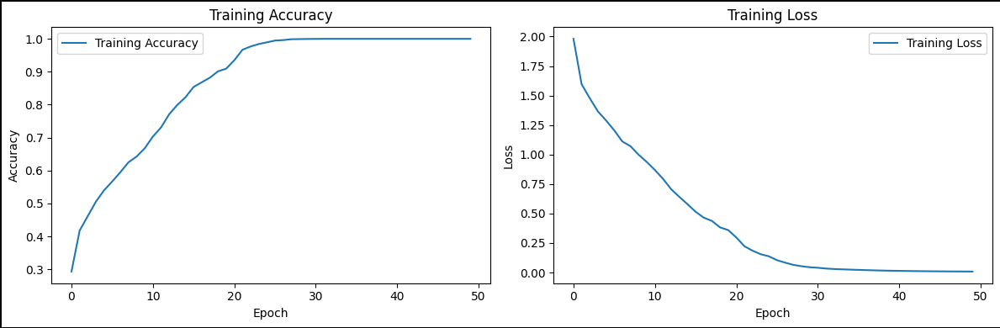


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


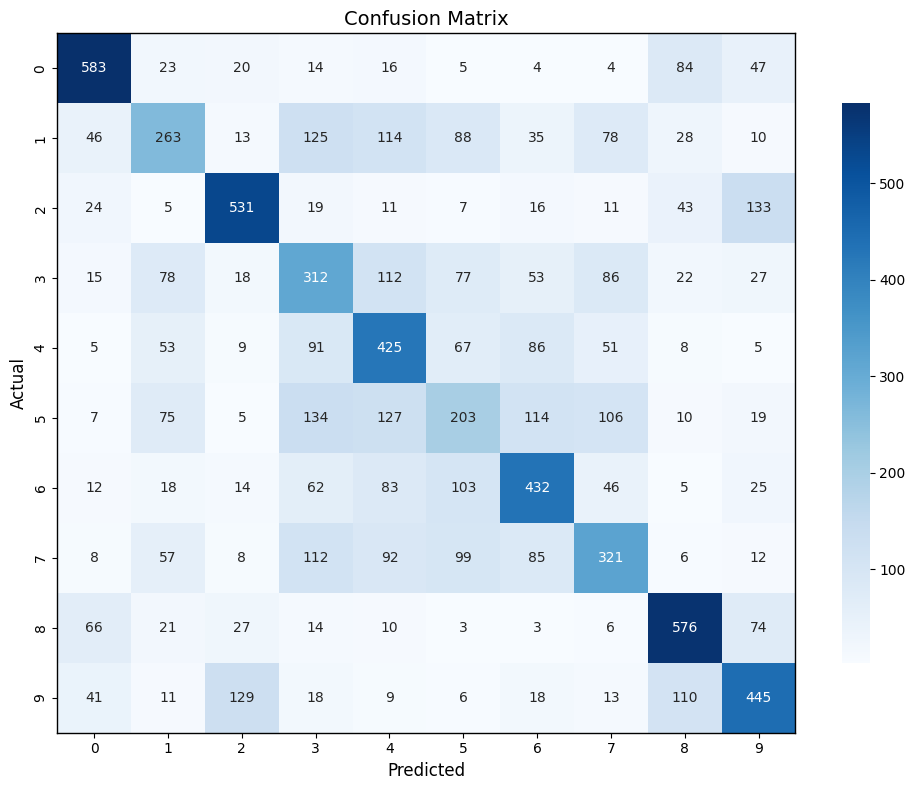

--------------------------------------------------
Experiment 9:
  pool_size: (4, 4)
  Test Accuracy: 0.5612
  Training History Accuracy: 1.0
  Training Time: 58.80510377883911
  Current Memory: 337.625344
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3334.3520164489746
    Average Time per Sample: 416.7940020561218
    Throughput: 2.399266772234762




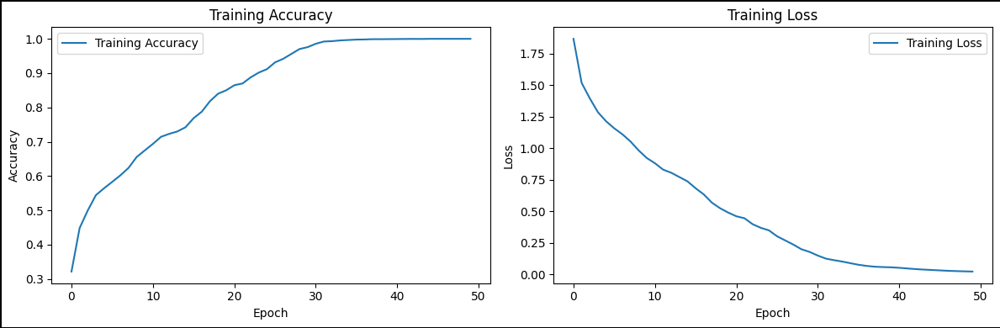


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


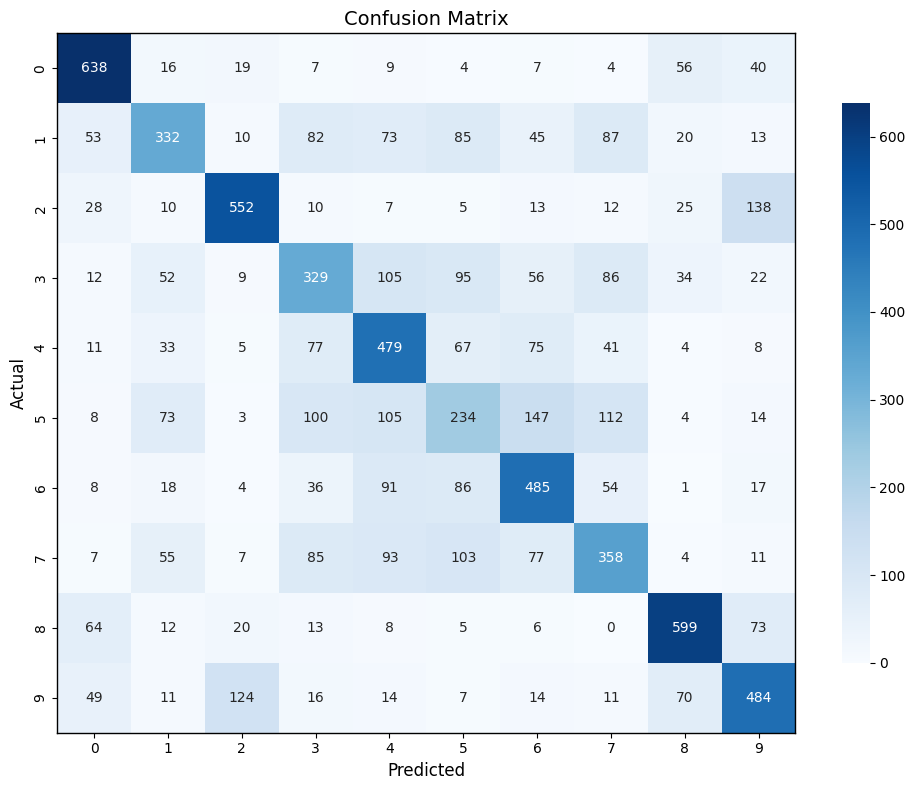

--------------------------------------------------
Experiment 10:
  pool_size: (4, 4)
  Test Accuracy: 0.5518
  Training History Accuracy: 1.0
  Training Time: 58.60399770736694
  Current Memory: 343.128064
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3497.304677963257
    Average Time per Sample: 437.1630847454071
    Throughput: 2.2874758525925745




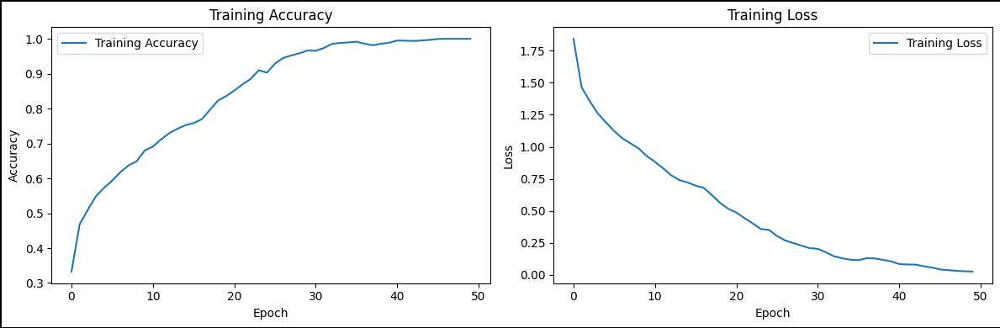


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


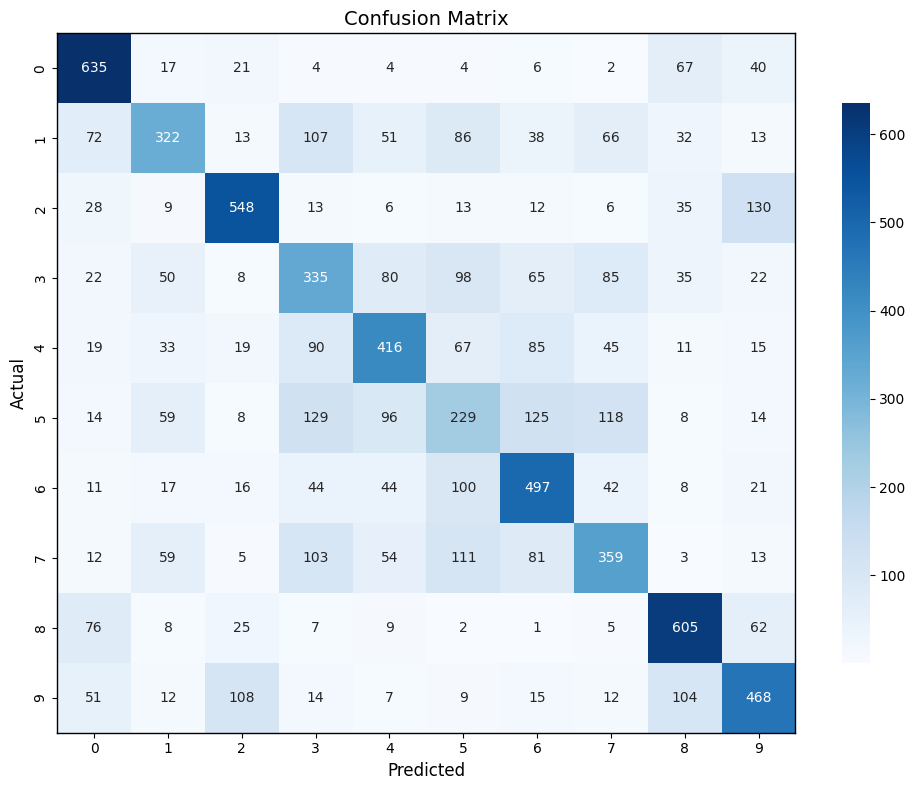

--------------------------------------------------
Experiment 11:
  pool_size: (4, 4)
  Test Accuracy: 0.5589
  Training History Accuracy: 0.9998000264167786
  Training Time: 60.835124015808105
  Current Memory: 348.452864
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3314.7668838500977
    Average Time per Sample: 414.3458604812622
    Throughput: 2.4134427186952014




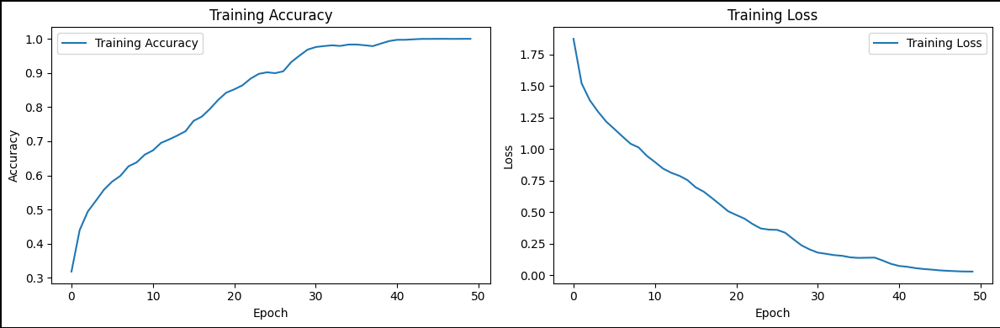


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


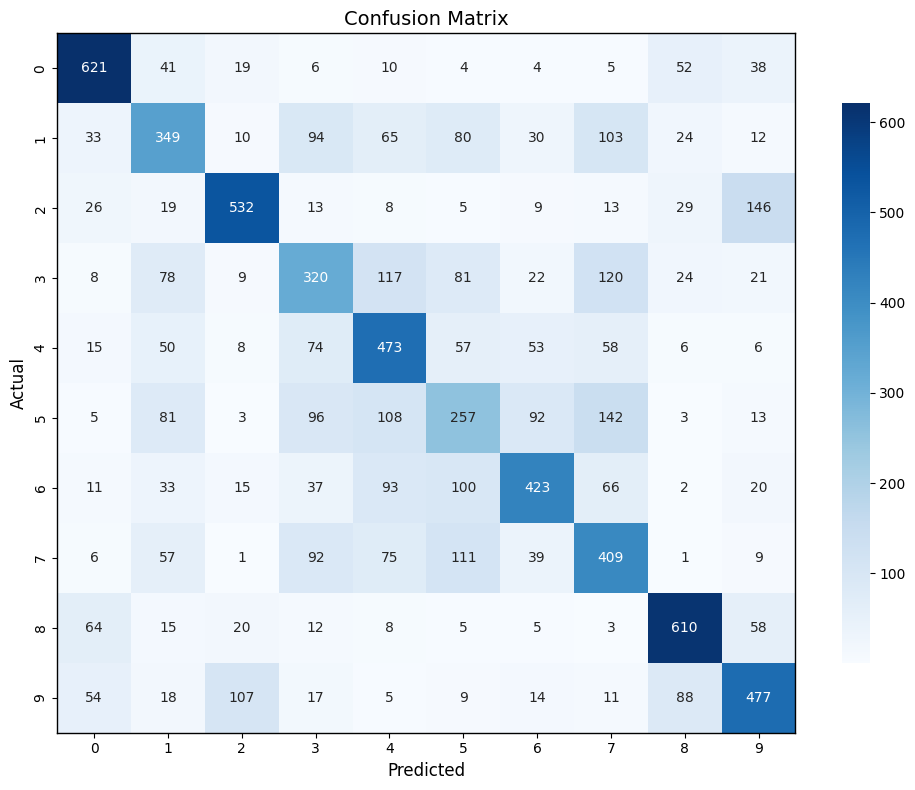

--------------------------------------------------
Experiment 12:
  pool_size: (4, 4)
  Test Accuracy: 0.5450
  Training History Accuracy: 0.995199978351593
  Training Time: 60.17292666435242
  Current Memory: 353.9392
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3323.295831680298
    Average Time per Sample: 415.41197896003723
    Throughput: 2.4072488292308014




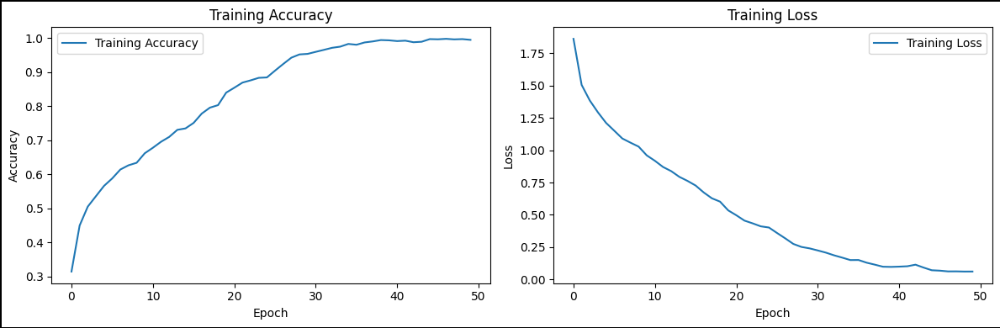


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step


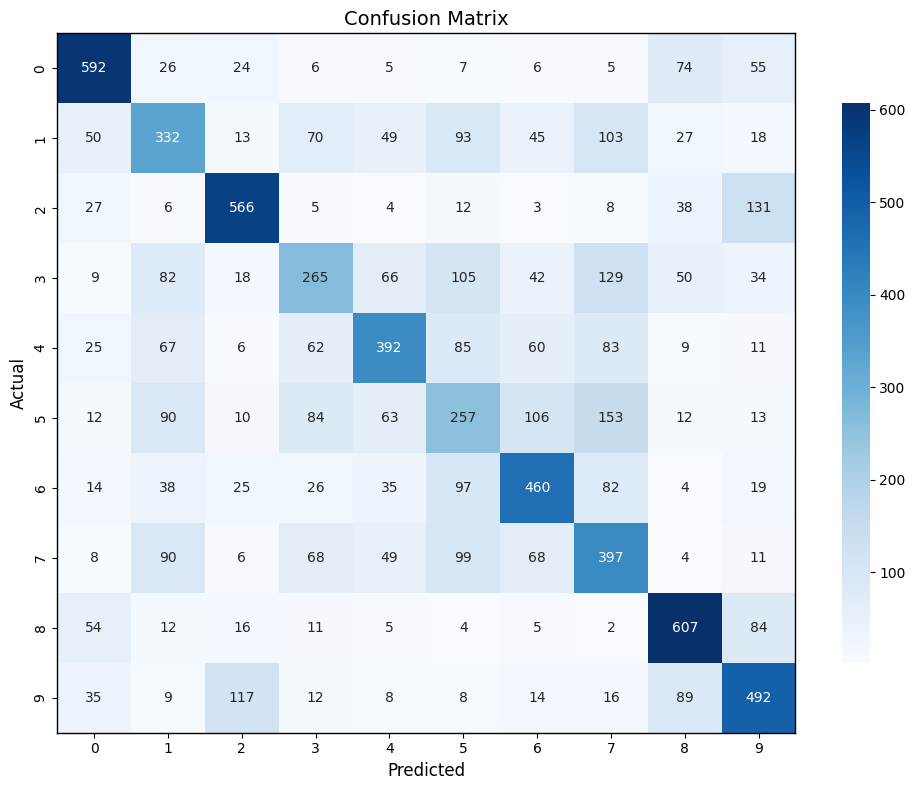

--------------------------------------------------
Experiment 13:
  pool_size: (4, 4)
  Test Accuracy: 0.5591
  Training History Accuracy: 0.9991999864578247
  Training Time: 64.22217965126038
  Current Memory: 359.35488
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3328.0491828918457
    Average Time per Sample: 416.0061478614807
    Throughput: 2.403810629099102




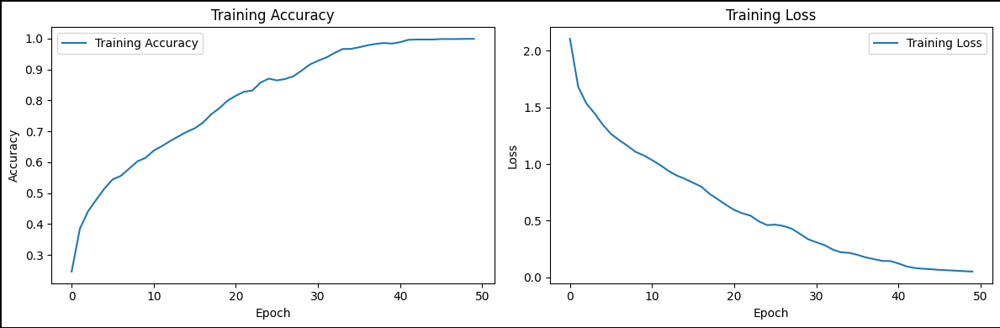


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


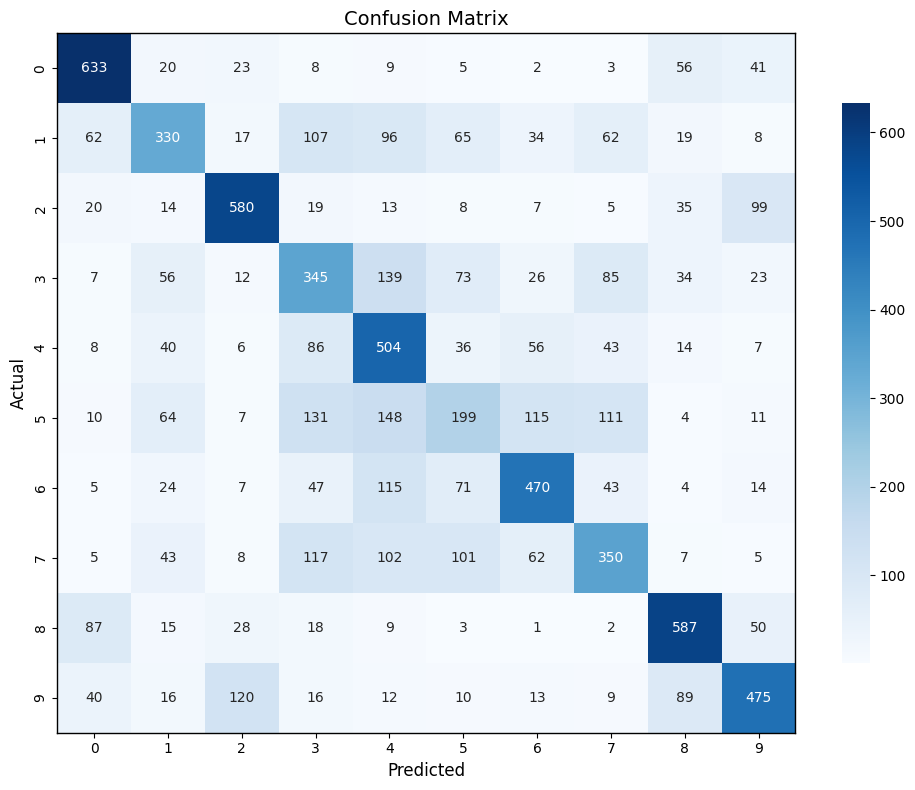

--------------------------------------------------
Experiment 14:
  pool_size: (4, 4)
  Test Accuracy: 0.5315
  Training History Accuracy: 0.9940000176429749
  Training Time: 62.599992513656616
  Current Memory: 365.956352
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3887.369394302368
    Average Time per Sample: 485.921174287796
    Throughput: 2.05794695295112




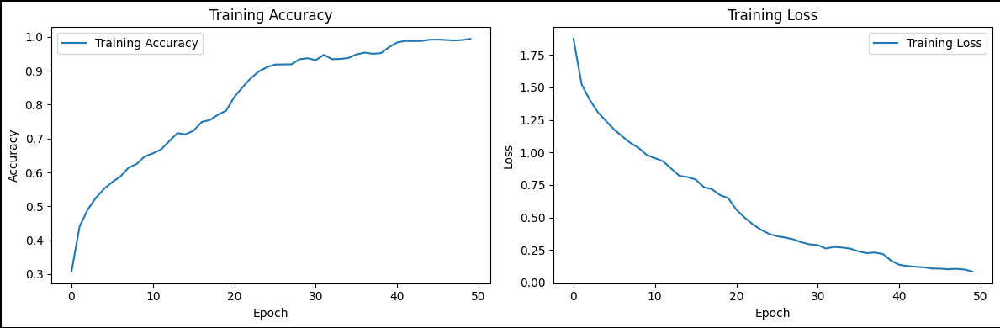


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step


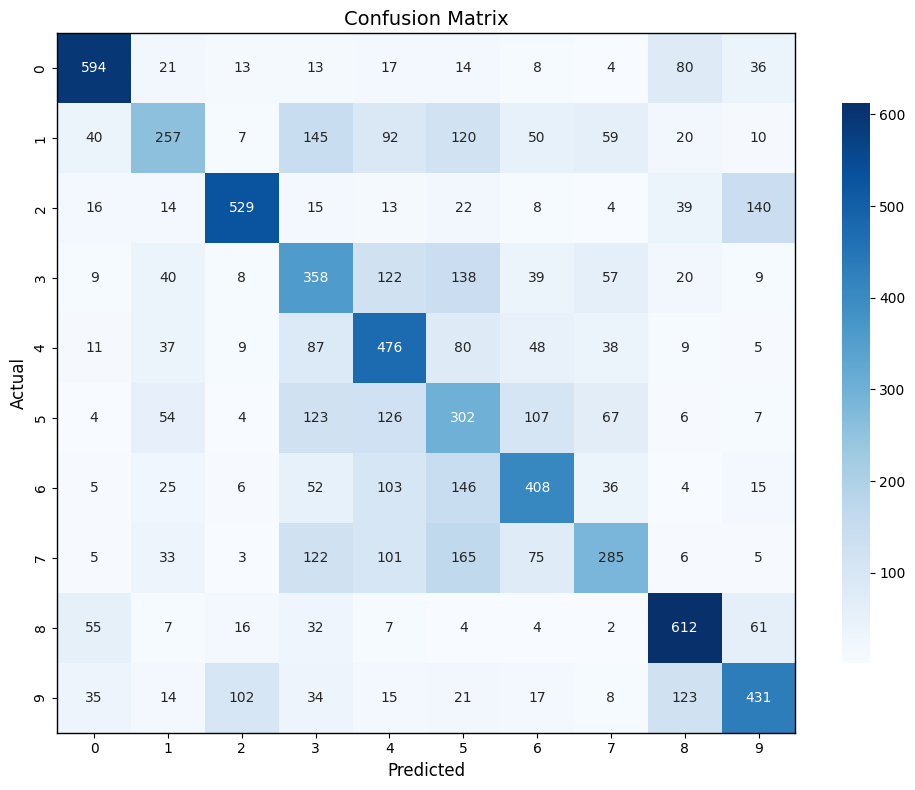

--------------------------------------------------
Experiment 15:
  pool_size: (4, 4)
  Test Accuracy: 0.5362
  Training History Accuracy: 0.998199999332428
  Training Time: 57.970558166503906
  Current Memory: 371.29728
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3291.3477420806885
    Average Time per Sample: 411.41846776008606
    Throughput: 2.4306152454564547




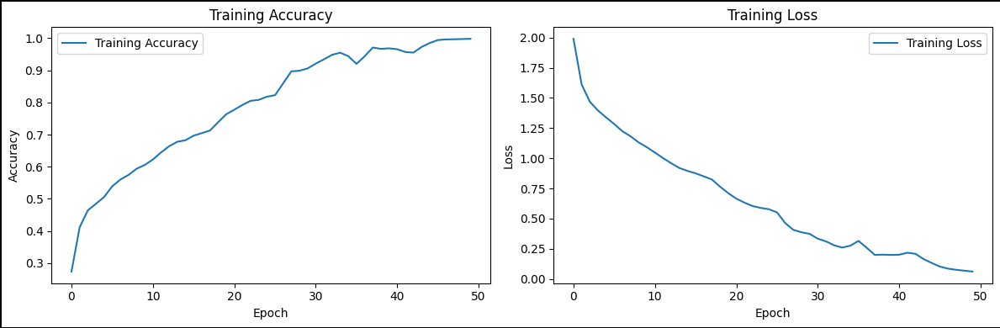


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


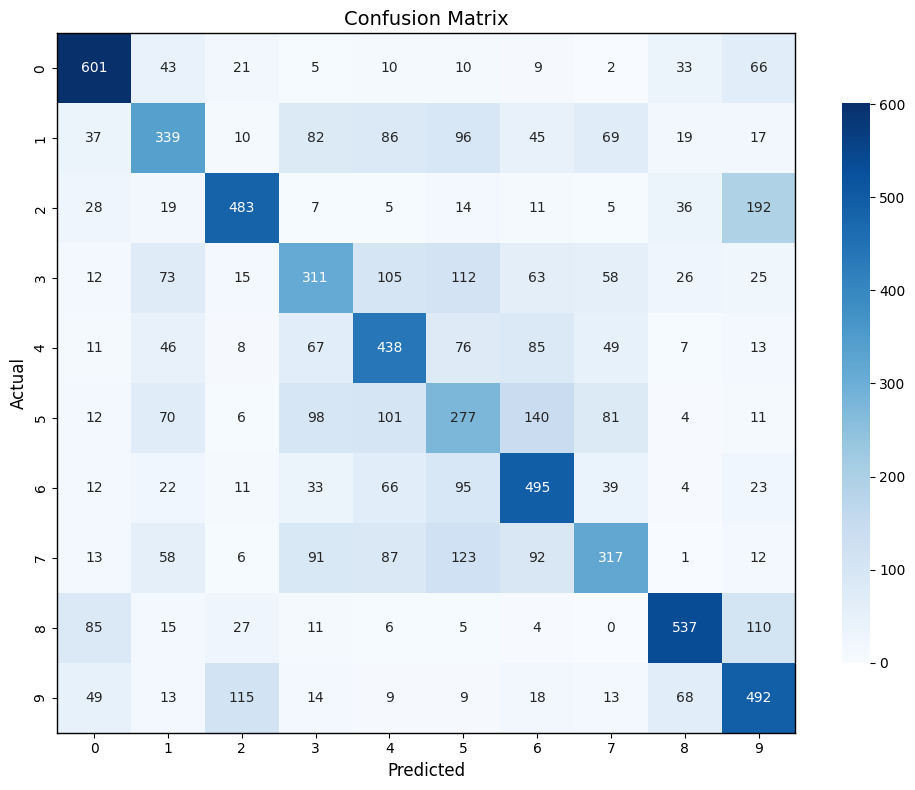

--------------------------------------------------
Experiment 16:
  pool_size: (4, 4)
  Test Accuracy: 0.5261
  Training History Accuracy: 0.996999979019165
  Training Time: 61.48495650291443
  Current Memory: 376.731392
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3319.732904434204
    Average Time per Sample: 414.9666130542755
    Throughput: 2.409832426372107




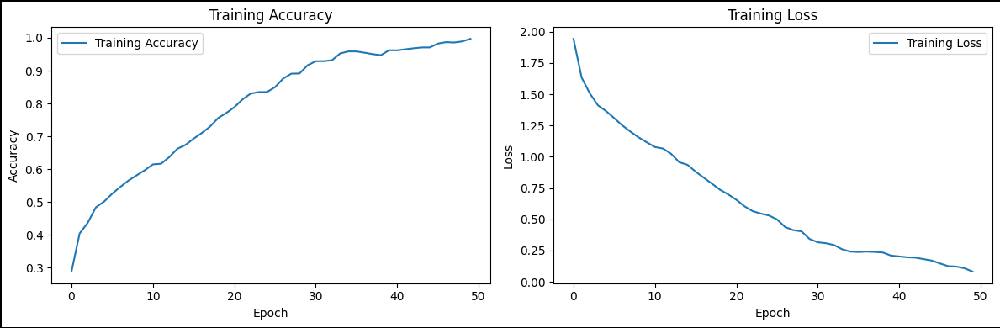


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


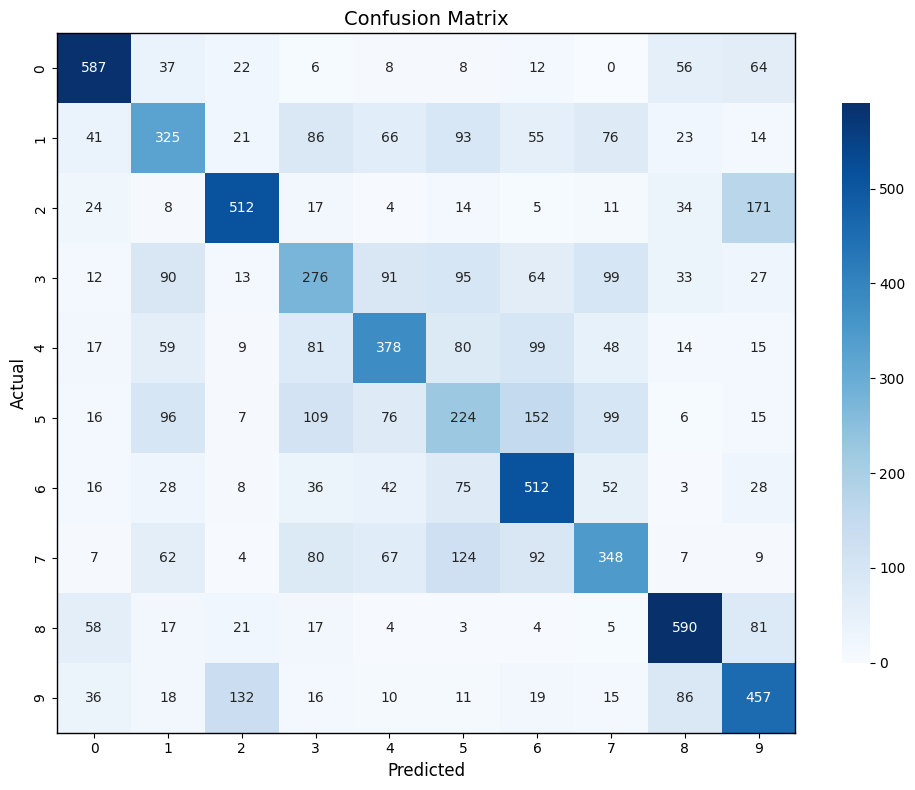

--------------------------------------------------
Experiment 17:
  pool_size: (4, 4)
  Test Accuracy: 0.5217
  Training History Accuracy: 0.996999979019165
  Training Time: 63.74002552032471
  Current Memory: 383.0848
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3975.8002758026123
    Average Time per Sample: 496.97503447532654
    Throughput: 2.012173511000878




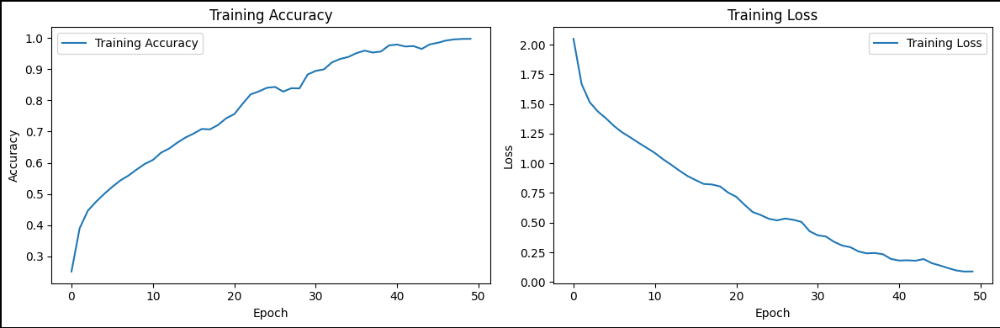


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


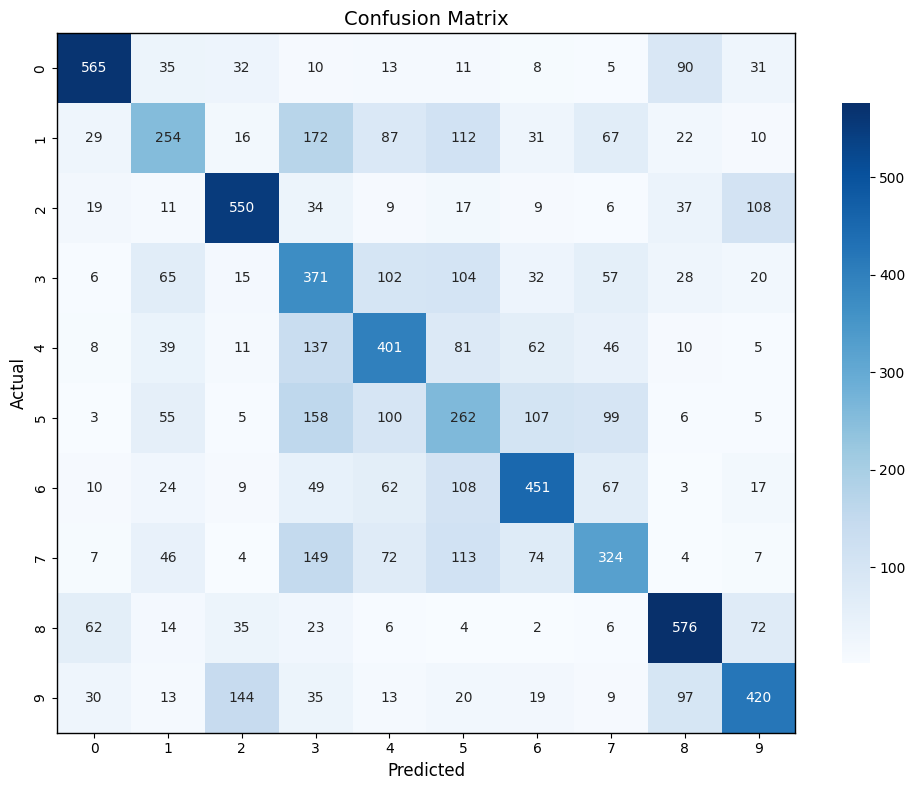

--------------------------------------------------


In [ ]:
print("\n=== Full Results Summary ===")
for idx, result in enumerate(results_tmaxavg, 1):
    print(f"Experiment {idx}:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training History Accuracy: {result['training_history']['accuracy'][-1]}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print()
    print()
    show_training_charts(result['training_history'])
    print()
    show_confusion_matrix(result['model'], x_test, y_test)
    print("-" * 50)

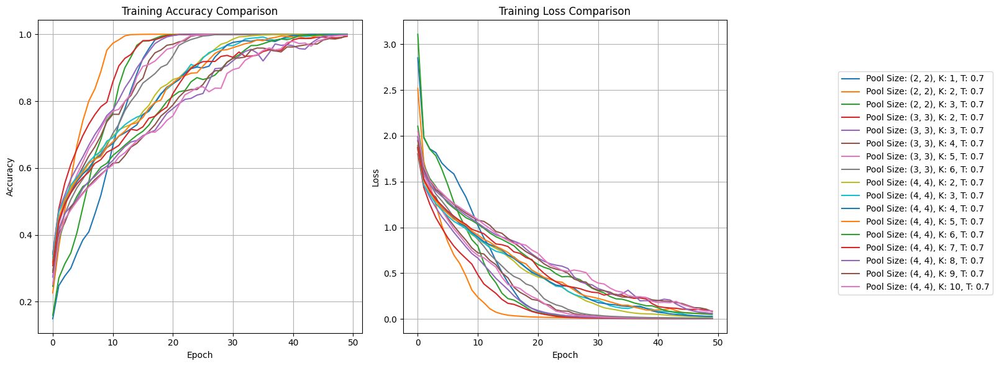

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

for idx, result in enumerate(results_tmaxavg):
    label = f"Pool Size: {result['pool_size']}, K: {result['k']}, T: {result['t']}"
    axes[0].plot(result['training_history']['accuracy'], label=label)
    axes[1].plot(result['training_history']['loss'], label=label)

axes[0].set_title('Training Accuracy Comparison')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].grid(True)

axes[1].set_title('Training Loss Comparison')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].grid(True)

# One legend for both subplots
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', bbox_to_anchor=(1.15, 0.5))

plt.tight_layout(rect=[0, 0, 0.85, 1])
plt.show()


In [ ]:
if SAVE_MODEL:
  for idx, result in enumerate(results_tmaxavg):
      model = result['model']
      pool_size = result['pool_size']
      k = result['k']
      t = result['t']
      model_name = f"tmaxavg_pooling_model_poolsize_{pool_size[0]}x{pool_size[1]}_k_{k}_t_{t}.h5"
      model.save(model_name)
      print(f"Saved model: {model_name}")

## prediction

===== testing data with predictions =====
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 277ms/step


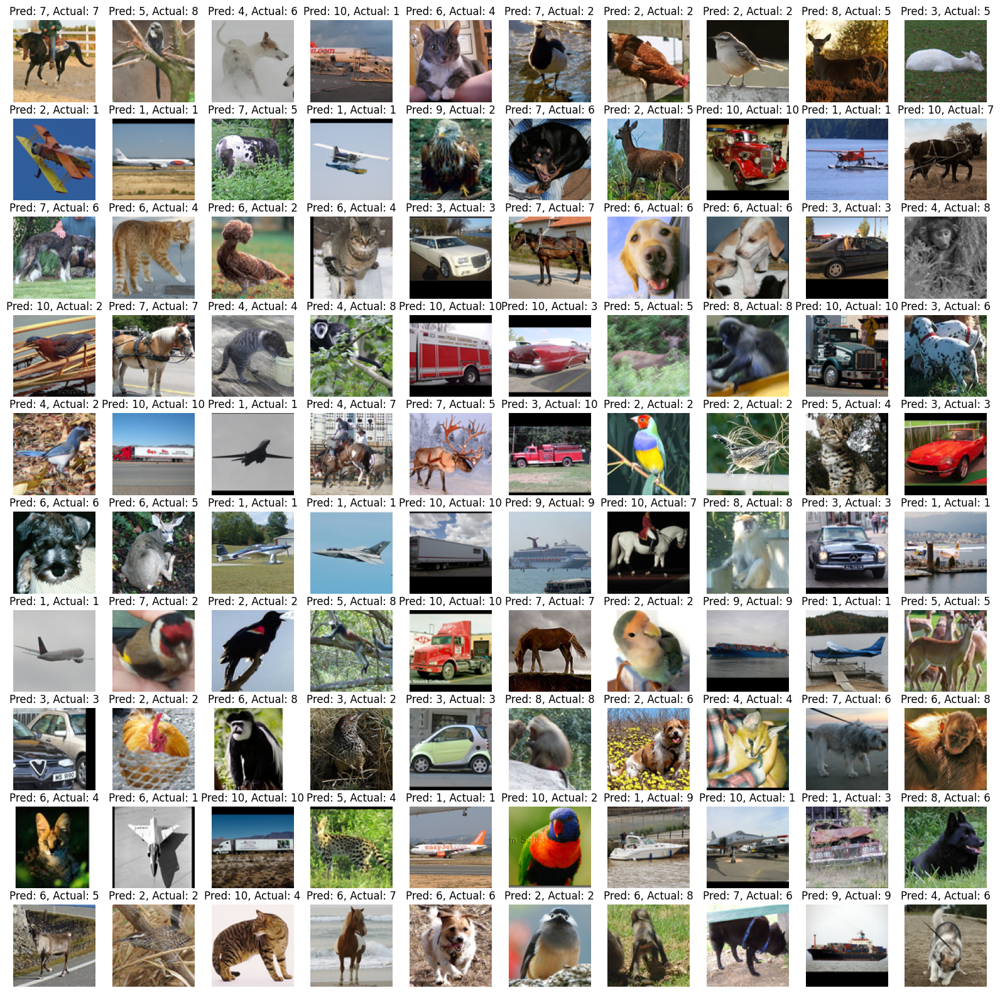

In [ ]:
print("===== testing data with predictions =====")
model = results_tmaxavg[11]['model']
show_predictions(model, x_test, y_test)

## optuna hyperparameter optimization

In [ ]:
def objective(trial):
    pool_size = trial.suggest_int("pool_size",2,5)
    k = trial.suggest_int("k",1,10)
    t = trial.suggest_float("t", 0.1, 0.9, step=0.01)

    print("START OBJECTIVE")
    print(f"\n=== Experiment: pool_size={pool_size}, k={k}, t={t} ===")

    result = run_experiment(pool_size=(pool_size, pool_size), k=k, t=t)
    testing_accuracy = result['test_accuracy']

    print("==============================")
    print(f"result:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print("-" * 50)
    print("==============================")

    print("END OBJECTIVE")
    return testing_accuracy

MAX_TRIAL = 20

start_optuna_time = time.time()
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=MAX_TRIAL)

print("Best trial:")
trial = study.best_trial
print(f"  Value: {trial.value}")
print("  Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

end_optuna_time = time.time()
print(f"optuna time: {end_optuna_time - start_optuna_time}")


[I 2025-09-10 15:02:01,450] A new study created in memory with name: no-name-e84c5236-a171-448b-8ea2-6c7305a3c3fb


START OBJECTIVE

=== Experiment: pool_size=2, k=7, t=0.73 ===

=== Experiment: pool_size=(2, 2), k=7, t=0.73 ===
creating model ...
pool_size (2, 2)
k 7
t 0.73
model created

=== model summary ===


Model: "sequential_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_17 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 77ms/step - accuracy: 0.1796 - loss: 2.9700
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.3826 - loss: 1.7403
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.4715 - loss: 1.5320
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step - accuracy: 0.5545 - loss: 1.3316
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - accuracy: 0.6300 - loss: 1.1482
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.6919 - loss: 0.9751
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7638 - loss: 0.8251
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8206 - loss: 0.6970
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.8565 - loss: 0.5948
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.8803 - loss: 0.5253
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.9266 - loss: 0.4050
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:04:08,918] Trial 0 finished with value: 0.33412501215934753 and parameters: {'pool_size': 2, 'k': 7, 't': 0.73}. Best is trial 0 with value: 0.33412501215934753.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3341
  Training Time: 113.90964412689209
  Current Memory: 453.754368
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3656.752824783325
    Average Time per Sample: 457.09410309791565
    Throughput: 2.1877333206063843
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=2, t=0.19 ===

=== Experiment: pool_size=(2, 2), k=2, t=0.19 ===
creating model ...
pool_size (2, 2)
k 2
t 0.19
model created

=== model summary ===


Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.1192 - loss: 3.5936
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2788 - loss: 1.9281
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.4034 - loss: 1.5869
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.4960 - loss: 1.3895
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - accuracy: 0.6039 - loss: 1.1294
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.6992 - loss: 0.9352
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7429 - loss: 0.8325
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7867 - loss: 0.7124
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.8350 - loss: 0.6368
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.8780 - loss: 0.4746
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.9461 - loss: 0.3285
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:06:05,666] Trial 1 finished with value: 0.45087501406669617 and parameters: {'pool_size': 2, 'k': 2, 't': 0.19}. Best is trial 1 with value: 0.45087501406669617.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.4509
  Training Time: 102.1182701587677
  Current Memory: 526.967808
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4627.402067184448
    Average Time per Sample: 578.425258398056
    Throughput: 1.7288318334671133
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=10, t=0.85 ===

=== Experiment: pool_size=(5, 5), k=10, t=0.85 ===
creating model ...
pool_size (5, 5)
k 10
t 0.85
model created

=== model summary ===


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 19, 19, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 3, 3, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 73ms/step - accuracy: 0.2051 - loss: 2.1404
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 20ms/step - accuracy: 0.3524 - loss: 1.7554
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4036 - loss: 1.6454
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4328 - loss: 1.5673
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4527 - loss: 1.4997
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4708 - loss: 1.4417
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4874 - loss: 1.4007
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4985 - loss: 1.3748
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5063 - loss: 1.3753
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5176 - loss: 1.3343
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5323 - loss: 1.2990
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:08:00,560] Trial 2 finished with value: 0.5377500057220459 and parameters: {'pool_size': 5, 'k': 10, 't': 0.85}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5378
  Training Time: 63.32272553443909
  Current Memory: 529.047296
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3831.0348987579346
    Average Time per Sample: 478.8793623447418
    Throughput: 2.0882085941304505
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=5, t=0.8099999999999999 ===

=== Experiment: pool_size=(4, 4), k=5, t=0.8099999999999999 ===
creating model ...
pool_size (4, 4)
k 5
t 0.8099999999999999
model created

=== model summary ===


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.2515 - loss: 2.0817
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4056 - loss: 1.6006
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4795 - loss: 1.4299
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5107 - loss: 1.3285
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5290 - loss: 1.2652
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5572 - loss: 1.2041
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5790 - loss: 1.1468
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5983 - loss: 1.1111
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6116 - loss: 1.0765
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6415 - loss: 1.0145
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6615 - loss: 0.9622
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:09:16,813] Trial 3 finished with value: 0.5264999866485596 and parameters: {'pool_size': 4, 'k': 5, 't': 0.8099999999999999}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5265
  Training Time: 61.60699534416199
  Current Memory: 534.36928
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4764.564514160156
    Average Time per Sample: 595.5705642700195
    Throughput: 1.6790621632311238
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=7, t=0.42000000000000004 ===

=== Experiment: pool_size=(2, 2), k=7, t=0.42000000000000004 ===
creating model ...
pool_size (2, 2)
k 7
t 0.42000000000000004
model created

=== model summary ===


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.1155 - loss: 3.6446
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - accuracy: 0.1699 - loss: 2.2385
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2448 - loss: 2.0207
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2532 - loss: 1.9561
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.3158 - loss: 1.8574
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.3241 - loss: 1.8036
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.3265 - loss: 1.8676
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3609 - loss: 1.7789
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.4256 - loss: 1.5883
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.4683 - loss: 1.4849
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.5222 - loss: 1.3695
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:11:15,838] Trial 4 finished with value: 0.343625009059906 and parameters: {'pool_size': 2, 'k': 7, 't': 0.42000000000000004}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3436
  Training Time: 105.66049861907959
  Current Memory: 605.145856
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3651.5684127807617
    Average Time per Sample: 456.4460515975952
    Throughput: 2.1908394135515588
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=8, t=0.56 ===

=== Experiment: pool_size=(4, 4), k=8, t=0.56 ===
creating model ...
pool_size (4, 4)
k 8
t 0.56
model created

=== model summary ===


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 65ms/step - accuracy: 0.2481 - loss: 2.0034
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4077 - loss: 1.6127
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4603 - loss: 1.4749
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4859 - loss: 1.4019
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5264 - loss: 1.3236
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5465 - loss: 1.2550
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5703 - loss: 1.1939
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5947 - loss: 1.1452
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6108 - loss: 1.0987
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6254 - loss: 1.0629
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6227 - loss: 1.0516
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:12:30,465] Trial 5 finished with value: 0.5298749804496765 and parameters: {'pool_size': 4, 'k': 8, 't': 0.56}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5299
  Training Time: 61.228415966033936
  Current Memory: 611.107584
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3319.046974182129
    Average Time per Sample: 414.8808717727661
    Throughput: 2.410330453961514
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=10, t=0.49 ===

=== Experiment: pool_size=(5, 5), k=10, t=0.49 ===
creating model ...
pool_size (5, 5)
k 10
t 0.49
model created

=== model summary ===


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 19, 19, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 3, 3, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.2210 - loss: 2.1304
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3618 - loss: 1.7581
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4030 - loss: 1.6242
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4441 - loss: 1.5245
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4584 - loss: 1.4575
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4792 - loss: 1.4150
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4776 - loss: 1.4168
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5113 - loss: 1.3464
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5266 - loss: 1.3047
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5367 - loss: 1.2780
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5439 - loss: 1.2546
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:13:41,941] Trial 6 finished with value: 0.5357499718666077 and parameters: {'pool_size': 5, 'k': 10, 't': 0.49}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5357
  Training Time: 58.351019620895386
  Current Memory: 613.770752
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3896.206855773926
    Average Time per Sample: 487.0258569717407
    Throughput: 2.053279072733143
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=7, t=0.76 ===

=== Experiment: pool_size=(2, 2), k=7, t=0.76 ===
creating model ...
pool_size (2, 2)
k 7
t 0.76
model created

=== model summary ===


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 48, 48, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 24, 24, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.1517 - loss: 2.8595
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step - accuracy: 0.2810 - loss: 1.9044
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - accuracy: 0.3236 - loss: 1.8296
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3670 - loss: 1.7484
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.4593 - loss: 1.5460
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.5461 - loss: 1.3604
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.6137 - loss: 1.2023
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 36ms/step - accuracy: 0.6437 - loss: 1.1058
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step - accuracy: 0.6921 - loss: 0.9915
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7593 - loss: 0.8509
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8032 - loss: 0.7222
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:15:36,356] Trial 7 finished with value: 0.34150001406669617 and parameters: {'pool_size': 2, 'k': 7, 't': 0.76}. Best is trial 2 with value: 0.5377500057220459.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3415
  Training Time: 100.5980875492096
  Current Memory: 684.4864
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4286.314964294434
    Average Time per Sample: 535.7893705368042
    Throughput: 1.8664050744383114
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=3, t=0.51 ===

=== Experiment: pool_size=(3, 3), k=3, t=0.51 ===
creating model ...
pool_size (3, 3)
k 3
t 0.51
model created

=== model summary ===


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 84ms/step - accuracy: 0.2406 - loss: 2.1689
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.4497 - loss: 1.4962
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5209 - loss: 1.3198
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5708 - loss: 1.1873
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6021 - loss: 1.0796
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6474 - loss: 0.9877
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6843 - loss: 0.9000
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7111 - loss: 0.8334
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7390 - loss: 0.7615
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7577 - loss: 0.7061
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7729 - loss: 0.6626
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:17:03,236] Trial 8 finished with value: 0.5522500276565552 and parameters: {'pool_size': 3, 'k': 3, 't': 0.51}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5523
  Training Time: 69.64506769180298
  Current Memory: 698.014976
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4620.552539825439
    Average Time per Sample: 577.5690674781799
    Throughput: 1.73139466136278
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=3, t=0.5700000000000001 ===

=== Experiment: pool_size=(5, 5), k=3, t=0.5700000000000001 ===
creating model ...
pool_size (5, 5)
k 3
t 0.5700000000000001
model created

=== model summary ===


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 19, 19, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 3, 3, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.2083 - loss: 2.1450
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3991 - loss: 1.6323
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4659 - loss: 1.4638
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4877 - loss: 1.3979
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5164 - loss: 1.3345
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5357 - loss: 1.2874
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5516 - loss: 1.2462
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5622 - loss: 1.2099
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5722 - loss: 1.1801
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5808 - loss: 1.1473
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5939 - loss: 1.1163
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:18:16,015] Trial 9 finished with value: 0.5222499966621399 and parameters: {'pool_size': 5, 'k': 3, 't': 0.5700000000000001}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5222
  Training Time: 57.851208209991455
  Current Memory: 700.097024
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3260.4002952575684
    Average Time per Sample: 407.55003690719604
    Throughput: 2.4536864420103384
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=1, t=0.28 ===

=== Experiment: pool_size=(3, 3), k=1, t=0.28 ===
creating model ...
pool_size (3, 3)
k 1
t 0.28
model created

=== model summary ===


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 68ms/step - accuracy: 0.2388 - loss: 2.2609
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 25ms/step - accuracy: 0.4625 - loss: 1.4824
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5113 - loss: 1.3362
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5601 - loss: 1.2059
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6274 - loss: 1.0721
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6279 - loss: 1.0707
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6919 - loss: 0.9111
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7239 - loss: 0.8293
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7515 - loss: 0.7405
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7754 - loss: 0.6874
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7702 - loss: 0.6908
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:19:34,962] Trial 10 finished with value: 0.5332499742507935 and parameters: {'pool_size': 3, 'k': 1, 't': 0.28}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5332
  Training Time: 64.66223359107971
  Current Memory: 713.12512
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4652.223587036133
    Average Time per Sample: 581.5279483795166
    Throughput: 1.71960780696198
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=4, t=0.65 ===

=== Experiment: pool_size=(3, 3), k=4, t=0.65 ===
creating model ...
pool_size (3, 3)
k 4
t 0.65
model created

=== model summary ===


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 72ms/step - accuracy: 0.2434 - loss: 2.1898
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4183 - loss: 1.5372
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5000 - loss: 1.3789
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5505 - loss: 1.2521
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.5894 - loss: 1.1373
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6341 - loss: 1.0399
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6589 - loss: 0.9644
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6946 - loss: 0.8928
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - accuracy: 0.7220 - loss: 0.8230
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7313 - loss: 0.7951
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7484 - loss: 0.7279
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:20:54,471] Trial 11 finished with value: 0.5295000076293945 and parameters: {'pool_size': 3, 'k': 4, 't': 0.65}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5295
  Training Time: 64.65916442871094
  Current Memory: 729.338368
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4742.476224899292
    Average Time per Sample: 592.8095281124115
    Throughput: 1.686882468276345
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=10, t=0.30000000000000004 ===

=== Experiment: pool_size=(4, 4), k=10, t=0.30000000000000004 ===
creating model ...
pool_size (4, 4)
k 10
t 0.30000000000000004
model created

=== model summary ===


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 71ms/step - accuracy: 0.2097 - loss: 2.1314
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.3730 - loss: 1.7076
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4429 - loss: 1.5301
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4832 - loss: 1.4462
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5044 - loss: 1.3735
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5194 - loss: 1.3265
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5384 - loss: 1.2780
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5589 - loss: 1.2289
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5746 - loss: 1.1883
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5868 - loss: 1.1389
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6061 - loss: 1.0996
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:22:12,292] Trial 12 finished with value: 0.5112500190734863 and parameters: {'pool_size': 4, 'k': 10, 't': 0.30000000000000004}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5113
  Training Time: 63.692188024520874
  Current Memory: 734.773504
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 5019.925594329834
    Average Time per Sample: 627.4906992912292
    Throughput: 1.593649118830816
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=4, t=0.88 ===

=== Experiment: pool_size=(3, 3), k=4, t=0.88 ===
creating model ...
pool_size (3, 3)
k 4
t 0.88
model created

=== model summary ===


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 73ms/step - accuracy: 0.2538 - loss: 2.0692
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - accuracy: 0.4455 - loss: 1.5317
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4917 - loss: 1.3868
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5572 - loss: 1.2439
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5987 - loss: 1.1298
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6339 - loss: 1.0646
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6572 - loss: 1.0082
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7087 - loss: 0.8764
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7395 - loss: 0.8085
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7497 - loss: 0.7714
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7867 - loss: 0.6718
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:23:28,331] Trial 13 finished with value: 0.531374990940094 and parameters: {'pool_size': 3, 'k': 4, 't': 0.88}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5314
  Training Time: 62.90333700180054
  Current Memory: 747.965696
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3934.2281818389893
    Average Time per Sample: 491.77852272987366
    Throughput: 2.033435690621415
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=1, t=0.38 ===

=== Experiment: pool_size=(5, 5), k=1, t=0.38 ===
creating model ...
pool_size (5, 5)
k 1
t 0.38
model created

=== model summary ===


Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 19, 19, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 3, 3, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.1826 - loss: 2.1566
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.3867 - loss: 1.6747
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4447 - loss: 1.5266
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4806 - loss: 1.4281
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5081 - loss: 1.3619
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5193 - loss: 1.3349
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5268 - loss: 1.2884
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5411 - loss: 1.2421
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5509 - loss: 1.2133
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5604 - loss: 1.1824
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5764 - loss: 1.1542
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:24:45,294] Trial 14 finished with value: 0.515375018119812 and parameters: {'pool_size': 5, 'k': 1, 't': 0.38}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5154
  Training Time: 61.89033508300781
  Current Memory: 750.313728
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4770.299434661865
    Average Time per Sample: 596.2874293327332
    Throughput: 1.6770435712841298
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=9, t=0.11 ===

=== Experiment: pool_size=(4, 4), k=9, t=0.11 ===
creating model ...
pool_size (4, 4)
k 9
t 0.11
model created

=== model summary ===


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 71ms/step - accuracy: 0.2118 - loss: 2.1956
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.3820 - loss: 1.6691
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4416 - loss: 1.5362
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4792 - loss: 1.4463
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5001 - loss: 1.3729
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5262 - loss: 1.3106
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5455 - loss: 1.2557
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5613 - loss: 1.2080
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5790 - loss: 1.1611
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5992 - loss: 1.1176
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6156 - loss: 1.0704
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:26:03,079] Trial 15 finished with value: 0.518750011920929 and parameters: {'pool_size': 4, 'k': 9, 't': 0.11}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5188
  Training Time: 62.969921350479126
  Current Memory: 755.65696
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4672.172784805298
    Average Time per Sample: 584.0215981006622
    Throughput: 1.7122654423263977
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=5, t=0.89 ===

=== Experiment: pool_size=(3, 3), k=5, t=0.89 ===
creating model ...
pool_size (3, 3)
k 5
t 0.89
model created

=== model summary ===


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 76ms/step - accuracy: 0.2292 - loss: 2.1883
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4019 - loss: 1.6180
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4360 - loss: 1.5427
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4888 - loss: 1.3990
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4942 - loss: 1.3931
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5526 - loss: 1.2366
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5908 - loss: 1.1494
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6171 - loss: 1.0748
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6518 - loss: 0.9966
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6794 - loss: 0.9267
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7029 - loss: 0.8558
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:27:23,416] Trial 16 finished with value: 0.48875001072883606 and parameters: {'pool_size': 3, 'k': 5, 't': 0.89}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.4888
  Training Time: 65.74381995201111
  Current Memory: 769.010432
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 5247.707366943359
    Average Time per Sample: 655.9634208679199
    Throughput: 1.5244752499718317
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=3, t=0.66 ===

=== Experiment: pool_size=(5, 5), k=3, t=0.66 ===
creating model ...
pool_size (5, 5)
k 3
t 0.66
model created

=== model summary ===


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 19, 19, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 3, 3, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 83ms/step - accuracy: 0.2171 - loss: 2.1248
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 20ms/step - accuracy: 0.3883 - loss: 1.6871
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4318 - loss: 1.5313
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4650 - loss: 1.4439
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4873 - loss: 1.3803
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5111 - loss: 1.3295
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5275 - loss: 1.2862
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5476 - loss: 1.2491
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5605 - loss: 1.2171
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5754 - loss: 1.1884
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5849 - loss: 1.1603
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:28:39,996] Trial 17 finished with value: 0.5298749804496765 and parameters: {'pool_size': 5, 'k': 3, 't': 0.66}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5299
  Training Time: 63.48540163040161
  Current Memory: 771.401984
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4017.587423324585
    Average Time per Sample: 502.1984279155731
    Throughput: 1.9912447837612797
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=6, t=0.66 ===

=== Experiment: pool_size=(4, 4), k=6, t=0.66 ===
creating model ...
pool_size (4, 4)
k 6
t 0.66
model created

=== model summary ===


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 24, 24, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 6, 6, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.2615 - loss: 2.0127
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - accuracy: 0.4352 - loss: 1.5568
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4847 - loss: 1.4248
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5156 - loss: 1.3332
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5469 - loss: 1.2620
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5692 - loss: 1.2019
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5869 - loss: 1.1388
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6012 - loss: 1.0914
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6238 - loss: 1.0365
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6482 - loss: 0.9730
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6728 - loss: 0.9159
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:29:56,839] Trial 18 finished with value: 0.5515000224113464 and parameters: {'pool_size': 4, 'k': 6, 't': 0.66}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5515
  Training Time: 63.71489191055298
  Current Memory: 777.62176
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 3917.555809020996
    Average Time per Sample: 489.6944761276245
    Throughput: 2.042089606376077
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=6, t=0.64 ===

=== Experiment: pool_size=(3, 3), k=6, t=0.64 ===
creating model ...
pool_size (3, 3)
k 6
t 0.64
model created

=== model summary ===


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1 (TMaxAvgPooling2D)        │ (None, 32, 32, 6)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2 (TMaxAvgPooling2D)        │ (None, 10, 10, 16)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 9s 93ms/step - accuracy: 0.2238 - loss: 2.2353
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 28ms/step - accuracy: 0.3925 - loss: 1.6573
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4561 - loss: 1.5154
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4824 - loss: 1.4348
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5281 - loss: 1.3096
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5294 - loss: 1.2695
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5914 - loss: 1.1562
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6067 - loss: 1.1096
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6344 - loss: 1.0447
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6626 - loss: 0.9547
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6911 - loss: 0.8834
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 15:31:22,875] Trial 19 finished with value: 0.4961250126361847 and parameters: {'pool_size': 3, 'k': 6, 't': 0.64}. Best is trial 8 with value: 0.5522500276565552.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.4961
  Training Time: 70.54221677780151
  Current Memory: 792.465152
  Peak Memory: 12908.3328
  Inference Benchmark:
    Total Time: 4632.371664047241
    Average Time per Sample: 579.0464580059052
    Throughput: 1.7269771469525195
--------------------------------------------------
END OBJECTIVE
Best trial:
  Value: 0.5522500276565552
  Params: 
    pool_size: 3
    k: 3
    t: 0.51
optuna time: 1761.4277138710022


In [ ]:
# Visualize the optimization history
optuna.visualization.plot_optimization_history(study)
optuna.visualization.plot_intermediate_values(study)
optuna.visualization.plot_param_importances(study)
optuna.visualization.plot_edf(study)
optuna.visualization.plot_slice(study)
optuna.visualization.plot_parallel_coordinate(study)

[W 2025-09-10 15:31:24,197] You need to set up the pruning feature to utilize `plot_intermediate_values()`


In [ ]:
play_sound(440, 1.0)

# average-thresholding pooling

## custom pooling development

In [ ]:
import tensorflow as tf

class AverageThresholdingPooling2D(tf.keras.layers.Layer):
    def __init__(self, pool_size=(2, 2), k=2, t=0.7, **kwargs):
        super(AverageThresholdingPooling2D, self).__init__(**kwargs)
        self.pool_size = pool_size
        self.k = k
        self.t = t

    def call(self, inputs):
        patches = tf.image.extract_patches(
            images=inputs,
            sizes=[1, *self.pool_size, 1],
            strides=[1, *self.pool_size, 1],
            rates=[1, 1, 1, 1],
            padding='VALID'
        )
        batch, out_h, out_w, depth = (
            tf.shape(patches)[0], tf.shape(patches)[1], tf.shape(patches)[2],
            tf.shape(patches)[3]
        )

        ksize = self.pool_size[0] * self.pool_size[1]
        channels = tf.shape(inputs)[-1]

        patches = tf.reshape(patches, [batch, out_h, out_w, ksize, channels])

        # get top-k
        sorted_vals = tf.sort(patches, direction='DESCENDING', axis=3)
        topk = sorted_vals[:, :, :, :self.k, :]

        # check average of top- with threshold
        avg_topk = tf.reduce_mean(topk, axis=3)
        condition = tf.cast(avg_topk >= self.t, tf.float32)

        max_vals = tf.reduce_max(topk, axis=3)
        avg_vals = tf.reduce_mean(topk, axis=3)

        output = condition * max_vals + (1.0 - condition) * avg_vals
        return output

    def get_config(self):
        config = super().get_config()
        config.update({
            'pool_size': self.pool_size,
            'k': self.k,
            't': self.t
        })
        return config


## develop base model

In [ ]:
def create_model(
                 _pool_size=(2, 2),
                 _k=2,
                 _t=0.7):
  print('creating model ...')
  print('pool_size', _pool_size)
  print('k', _k)
  print('t', _t)

  model = Sequential()

  model.add(Input(shape=(len(x_train[0]), len(x_train[0][0]), 3)))
  model.add(Conv2D(6, kernel_size=(5, 5), activation='tanh', padding='same', name='conv1'))
  model.add(AverageThresholdingPooling2D(pool_size=_pool_size, k=_k, t=_t, name='pool1'))
  model.add(Conv2D(16, kernel_size=(5, 5), activation='tanh', padding='same', name='conv2'))
  model.add(AverageThresholdingPooling2D(pool_size=_pool_size, k=_k, t=_t, name='pool2'))
  model.add(Conv2D(120, kernel_size=(5, 5), activation='tanh', padding='same', name='conv3'))

  model.add(Flatten())
  model.add(Dense(84, activation='tanh', name='fc1'))
  model.add(Dense(len(y_train[0]), activation='softmax', name='fc2'))

  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

  print('model created')
  return model


## experiment

In [ ]:
def train_model(x_train, y_train, pool_size, k, t):
    start_time = time.time()

    print(f"\n=== Experiment: pool_size={pool_size}, k={k}, t={t} ===")
    model = create_model(_pool_size=pool_size, _k=k, _t=t)

    print("\n=== model summary ===")
    model.summary()

    print("\n=== model training ===")
    history = model.fit(x_train, y_train, batch_size=128, epochs=50, verbose=1)
    cur, peak = get_gpu_memory_info()

    end_time = time.time()
    training_time = end_time - start_time

    return model, history, training_time, cur, peak

def run_experiment(pool_size, k, t):
    # training process
    model, history, training_time, cur_mb, peak_mb = train_model(x_train, y_train, pool_size, k, t)

    # model evaluation
    loss, accuracy = model_evaluation(model, x_test, y_test)

    # inference benchmark
    inference = inference_speed(model, x_test)

    # Store results
    result = {
        'model': model,
        'pool_size': pool_size,
        'k': k,
        't': t,
        'test_accuracy': accuracy,
        'training_history': history.history,
        'training_time': training_time,
        'current_mb': cur_mb,
        'peak_mb': peak_mb,
        'inference_benchmark': inference
    }

    return result

In [ ]:
results_avgthresholding = []
result = run_experiment(pool_size=(2, 2), k=1, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(2, 2), k=2, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(2, 2), k=3, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(3, 3), k=2, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(3, 3), k=3, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(3, 3), k=4, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(3, 3), k=5, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(3, 3), k=6, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=2, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=3, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=4, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=5, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=6, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=7, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=8, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=9, t=0.7)
results_avgthresholding.append(result)

result = run_experiment(pool_size=(4, 4), k=10, t=0.7)
results_avgthresholding.append(result)


=== Experiment: pool_size=(2, 2), k=1, t=0.7 ===
creating model ...
pool_size (2, 2)
k 1
t 0.7
model created

=== model summary ===


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 11s 85ms/step - accuracy: 0.1229 - loss: 3.5032
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step - accuracy: 0.2313 - loss: 2.0294
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - accuracy: 0.2684 - loss: 1.8700
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.2365 - loss: 2.1019
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - accuracy: 0.2557 - loss: 1.9754
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.2931 - loss: 1.8477
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.3194 - loss: 1.7490
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - accuracy: 0.3487 - loss: 1.7122
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3796 - loss: 1.6423
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - accuracy: 0.4279 - loss: 1.5456
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.4398 - loss: 1.4907
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.1682 - loss: 3.2061
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.3070 - loss: 1.8466
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.4061 - loss: 1.5895
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.5193 - loss: 1.3542
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - accuracy: 0.6051 - loss: 1.1454
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.6810 - loss: 0.9860
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.7533 - loss: 0.8029
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8388 - loss: 0.6199
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.8784 - loss: 0.5065
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.9131 - loss: 0.4032
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.9591 - loss: 0.2881
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 78ms/step - accuracy: 0.1349 - loss: 3.9278
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2328 - loss: 2.0884
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.2783 - loss: 1.9217
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.3114 - loss: 1.8371
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3841 - loss: 1.6703
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.4724 - loss: 1.4912
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.5572 - loss: 1.3123
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.6195 - loss: 1.1690
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.6729 - loss: 1.0450
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - accuracy: 0.7064 - loss: 0.9569
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7583 - loss: 0.8440
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 9s 78ms/step - accuracy: 0.2697 - loss: 2.0155
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 25ms/step - accuracy: 0.4618 - loss: 1.4772
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5495 - loss: 1.2793
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6107 - loss: 1.1172
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6546 - loss: 1.0007
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6966 - loss: 0.8924
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7351 - loss: 0.8016
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7605 - loss: 0.7295
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7752 - loss: 0.6849
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7914 - loss: 0.6168
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.8491 - loss: 0.5001
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 72ms/step - accuracy: 0.2804 - loss: 2.0933
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4469 - loss: 1.5075
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5118 - loss: 1.3571
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5692 - loss: 1.2250
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5975 - loss: 1.1288
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6212 - loss: 1.0495
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6660 - loss: 0.9552
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6923 - loss: 0.8796
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7154 - loss: 0.8071
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7468 - loss: 0.7209
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7661 - loss: 0.6759
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Experiment: pool_size=(3, 3), k=4, t=0.7 ===
creating model ...
pool_size (3, 3)
k 4
t 0.7
model created

=== model summary ===


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_5 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 73ms/step - accuracy: 0.2374 - loss: 2.1494
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4225 - loss: 1.5709
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4867 - loss: 1.4240
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5090 - loss: 1.3906
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5647 - loss: 1.2123
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6014 - loss: 1.1275
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6333 - loss: 1.0219
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6630 - loss: 0.9411
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6941 - loss: 0.8689
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7411 - loss: 0.7740
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7467 - loss: 0.7391
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Experiment: pool_size=(3, 3), k=5, t=0.7 ===
creating model ...
pool_size (3, 3)
k 5
t 0.7
model created

=== model summary ===


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 75ms/step - accuracy: 0.2531 - loss: 2.1459
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4038 - loss: 1.6253
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4752 - loss: 1.4558
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5273 - loss: 1.3253
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.5700 - loss: 1.2037
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6095 - loss: 1.0953
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6579 - loss: 0.9883
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6747 - loss: 0.9272
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7073 - loss: 0.8440
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7402 - loss: 0.7574
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7736 - loss: 0.6831
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_7 (Flatten)             │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 75ms/step - accuracy: 0.2325 - loss: 2.2636
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.3981 - loss: 1.6332
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4498 - loss: 1.4993
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5017 - loss: 1.3804
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5368 - loss: 1.3047
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5769 - loss: 1.2066
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6037 - loss: 1.1126
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6311 - loss: 1.0472
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6471 - loss: 1.0170
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.6745 - loss: 0.9353
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.7036 - loss: 0.8619
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 70ms/step - accuracy: 0.2415 - loss: 2.0759
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 21ms/step - accuracy: 0.4302 - loss: 1.5588
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4832 - loss: 1.4236
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5368 - loss: 1.2967
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5675 - loss: 1.2136
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5844 - loss: 1.1518
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5928 - loss: 1.1137
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6159 - loss: 1.0634
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6551 - loss: 0.9881
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6755 - loss: 0.9242
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6962 - loss: 0.8773
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_9"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_9 (Flatten)             │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 67ms/step - accuracy: 0.2598 - loss: 2.0353
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4563 - loss: 1.4912
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5007 - loss: 1.3773
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5398 - loss: 1.2733
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5660 - loss: 1.1951
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5900 - loss: 1.1271
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6155 - loss: 1.0671
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6348 - loss: 1.0338
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6479 - loss: 0.9864
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6800 - loss: 0.9325
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6892 - loss: 0.8805
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 70ms/step - accuracy: 0.2541 - loss: 2.0854
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4096 - loss: 1.5763
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4838 - loss: 1.4099
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5132 - loss: 1.3164
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5509 - loss: 1.2272
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5739 - loss: 1.1662
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5983 - loss: 1.1038
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6238 - loss: 1.0426
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6335 - loss: 1.0151
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6556 - loss: 0.9544
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6803 - loss: 0.9008
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.2399 - loss: 2.0596
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4331 - loss: 1.5422
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5104 - loss: 1.3983
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5432 - loss: 1.2893
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5728 - loss: 1.2064
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5961 - loss: 1.1398
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6118 - loss: 1.0886
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6322 - loss: 1.0436
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6382 - loss: 1.0244
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6555 - loss: 0.9817
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6764 - loss: 0.9222
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_12 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 69ms/step - accuracy: 0.1803 - loss: 2.3445
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3641 - loss: 1.7348
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4274 - loss: 1.5688
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4632 - loss: 1.4748
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5025 - loss: 1.3752
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5428 - loss: 1.2679
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5572 - loss: 1.2113
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5747 - loss: 1.1647
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6042 - loss: 1.1071
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6124 - loss: 1.0777
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6390 - loss: 1.0303
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_13 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 69ms/step - accuracy: 0.2436 - loss: 2.0479
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 21ms/step - accuracy: 0.4313 - loss: 1.5596
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4772 - loss: 1.4257
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5221 - loss: 1.3211
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5535 - loss: 1.2436
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5723 - loss: 1.1717
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5944 - loss: 1.1158
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6127 - loss: 1.0710
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6269 - loss: 1.0300
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6528 - loss: 0.9717
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6559 - loss: 0.9523
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_14 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.2126 - loss: 2.1684
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.3836 - loss: 1.6594
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4563 - loss: 1.4899
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4744 - loss: 1.4106
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4983 - loss: 1.3371
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5343 - loss: 1.2917
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5565 - loss: 1.2273
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5701 - loss: 1.1810
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5920 - loss: 1.1268
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6064 - loss: 1.0858
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6247 - loss: 1.0417
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_15 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 76ms/step - accuracy: 0.2265 - loss: 2.1058
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3889 - loss: 1.6651
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4275 - loss: 1.5285
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4915 - loss: 1.4150
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5082 - loss: 1.3652
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5333 - loss: 1.3062
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5495 - loss: 1.2470
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5687 - loss: 1.1980
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5870 - loss: 1.1484
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5979 - loss: 1.1104
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6064 - loss: 1.0837
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

Model: "sequential_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_16 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 69ms/step - accuracy: 0.1962 - loss: 2.2131
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3644 - loss: 1.7301
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4396 - loss: 1.5443
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4683 - loss: 1.4485
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4916 - loss: 1.3915
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5178 - loss: 1.3252
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5404 - loss: 1.2621
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5547 - loss: 1.2179
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5768 - loss: 1.1664
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5910 - loss: 1.1195
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6067 - loss: 1.0799
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 


=== Full Results Summary ===
Experiment 1:
  pool_size: (2, 2)
  Test Accuracy: 0.4725
  Training History Accuracy: 1.0
  Training Time: 117.54597663879395
  Current Memory: 91.40224
  Peak Memory: 1034.414848
  Inference Benchmark:
    Total Time: 4643.421411514282
    Average Time per Sample: 580.4276764392853
    Throughput: 1.7228675347368683




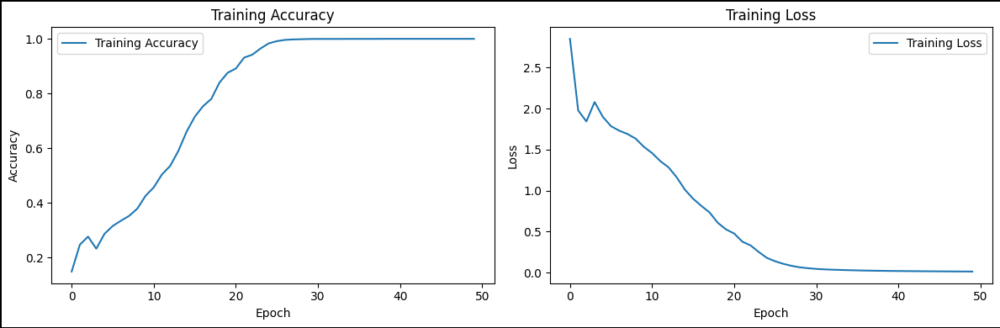


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


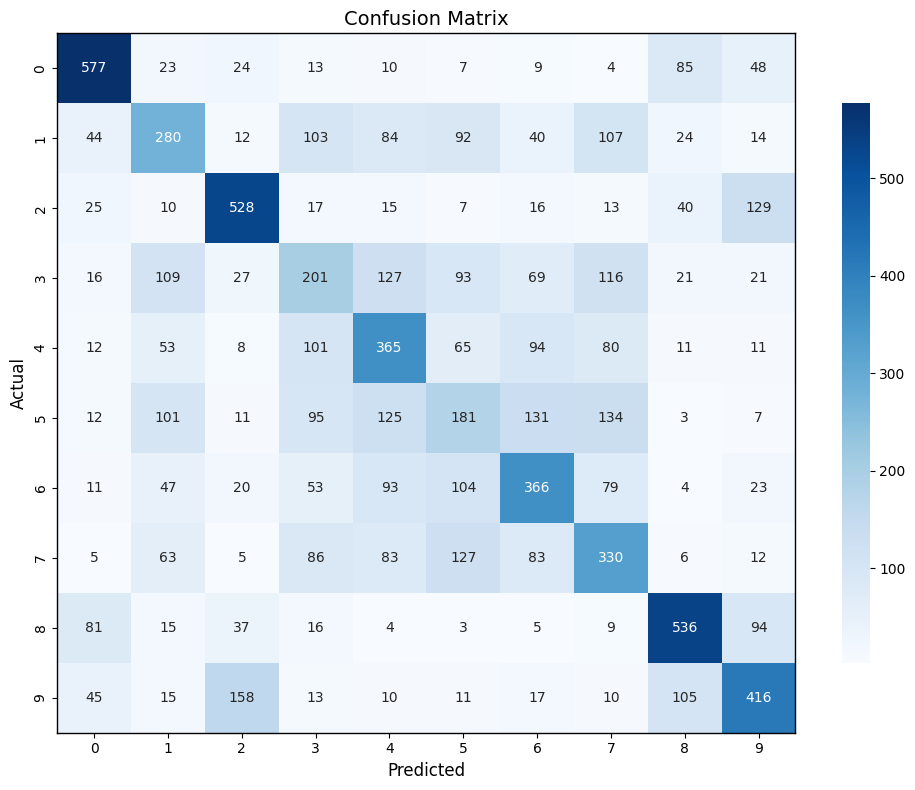

--------------------------------------------------
Experiment 2:
  pool_size: (2, 2)
  Test Accuracy: 0.4700
  Training History Accuracy: 1.0
  Training Time: 96.90656471252441
  Current Memory: 162.080768
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4607.022285461426
    Average Time per Sample: 575.8777856826782
    Throughput: 1.736479553234621




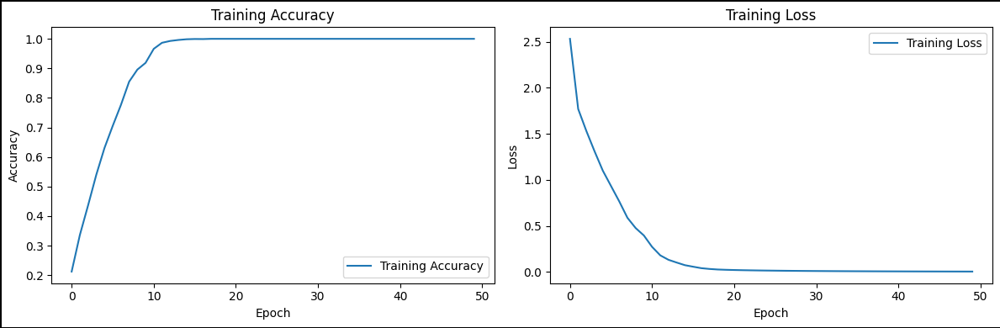


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


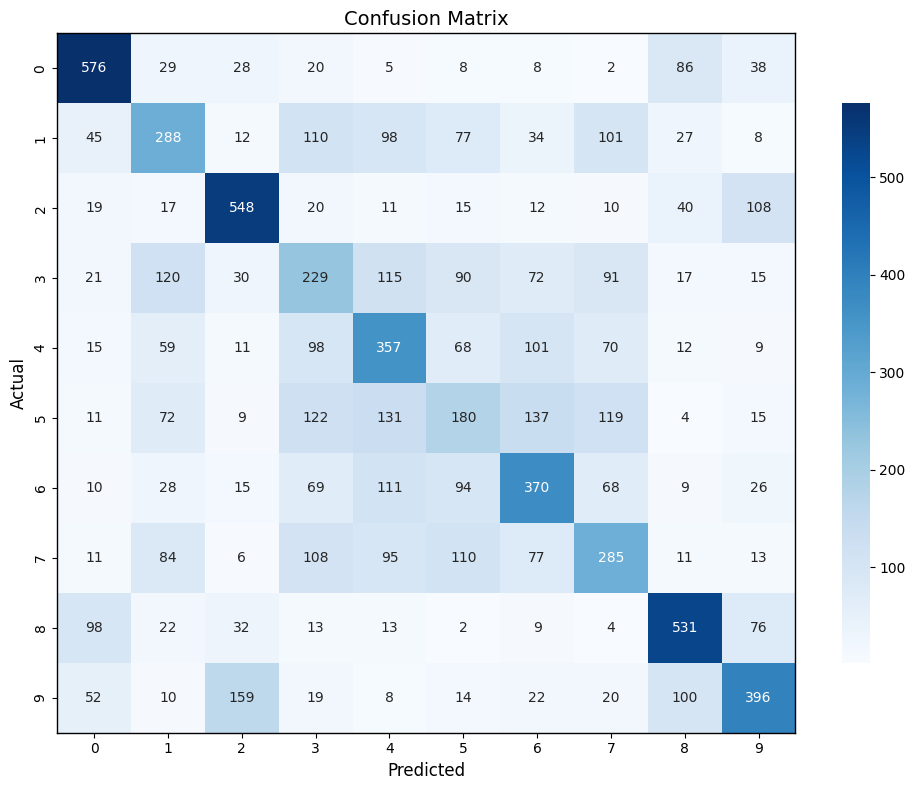

--------------------------------------------------
Experiment 3:
  pool_size: (2, 2)
  Test Accuracy: 0.4064
  Training History Accuracy: 0.9998000264167786
  Training Time: 110.96841955184937
  Current Memory: 259.158784
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3660.8526706695557
    Average Time per Sample: 457.60658383369446
    Throughput: 2.1852832440090606




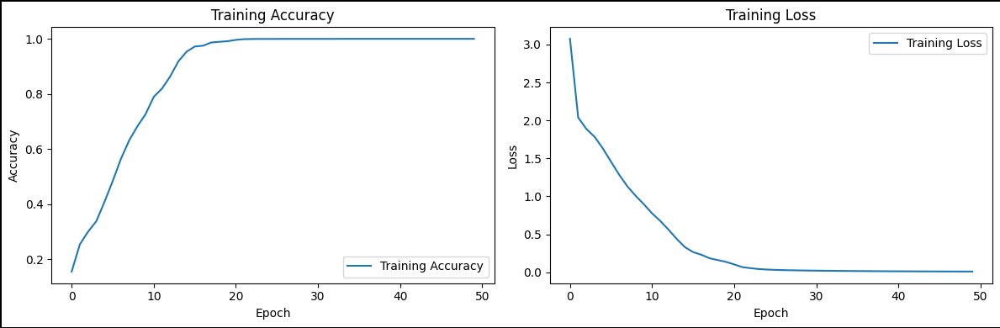


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step


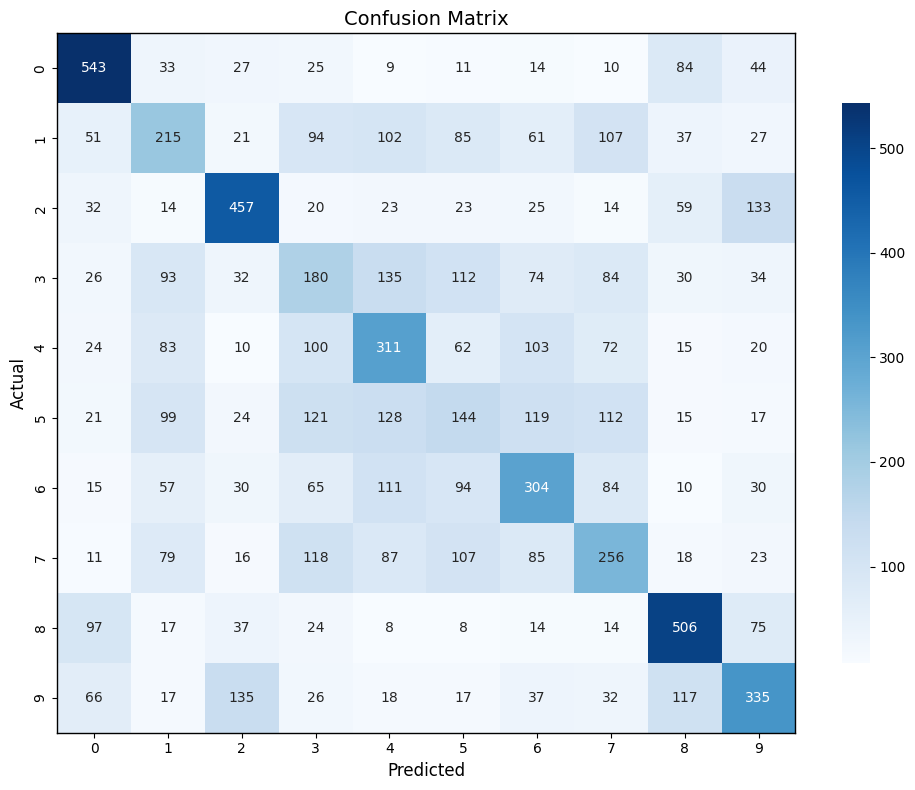

--------------------------------------------------
Experiment 4:
  pool_size: (3, 3)
  Test Accuracy: 0.5253
  Training History Accuracy: 1.0
  Training Time: 69.05415534973145
  Current Memory: 272.983808
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4883.691072463989
    Average Time per Sample: 610.4613840579987
    Throughput: 1.6381052530343052




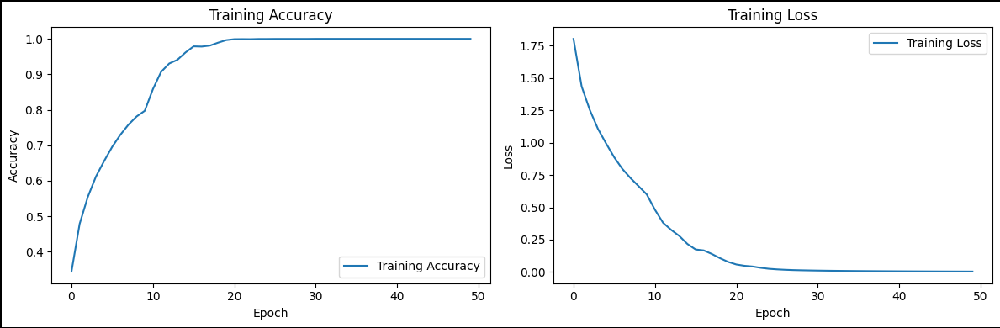


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


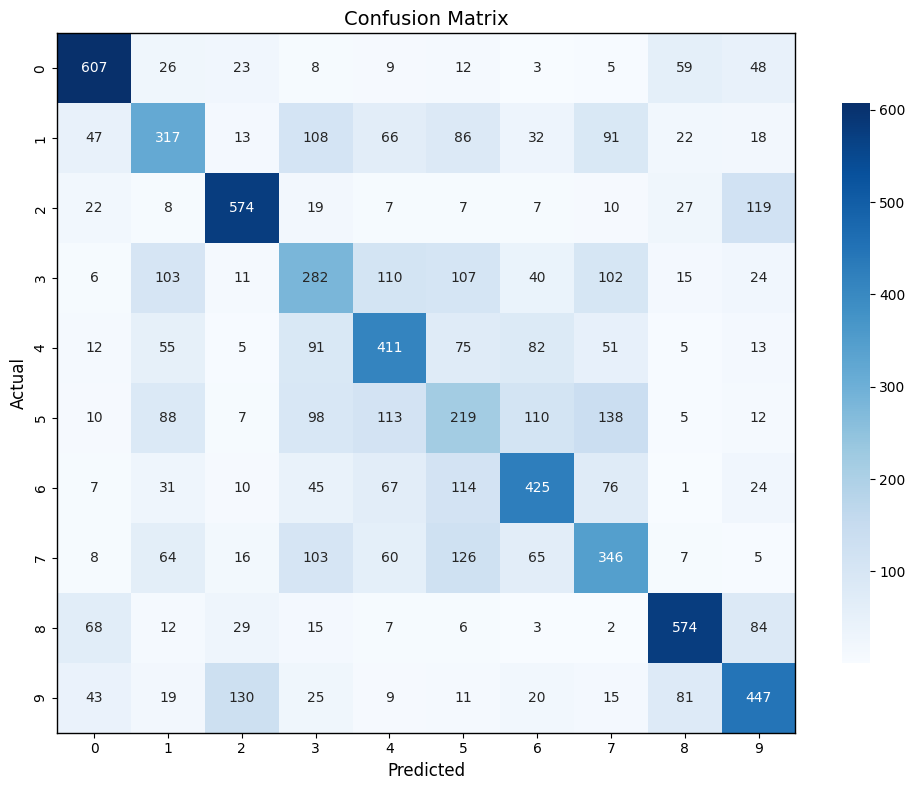

--------------------------------------------------
Experiment 5:
  pool_size: (3, 3)
  Test Accuracy: 0.5290
  Training History Accuracy: 1.0
  Training Time: 63.48137950897217
  Current Memory: 291.565056
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4772.593021392822
    Average Time per Sample: 596.5741276741028
    Throughput: 1.6762376268289683




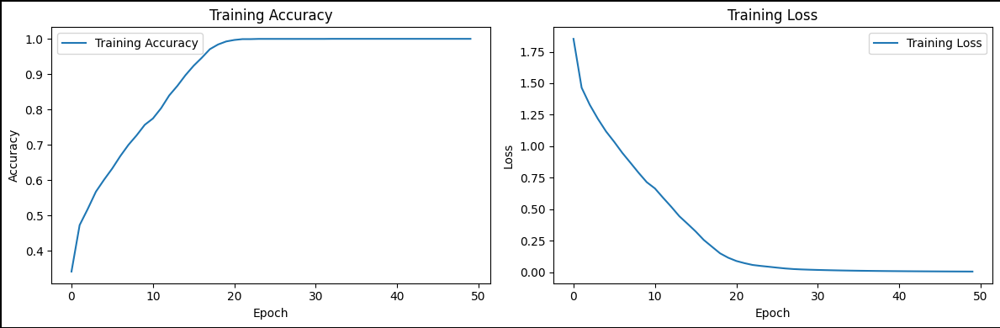


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


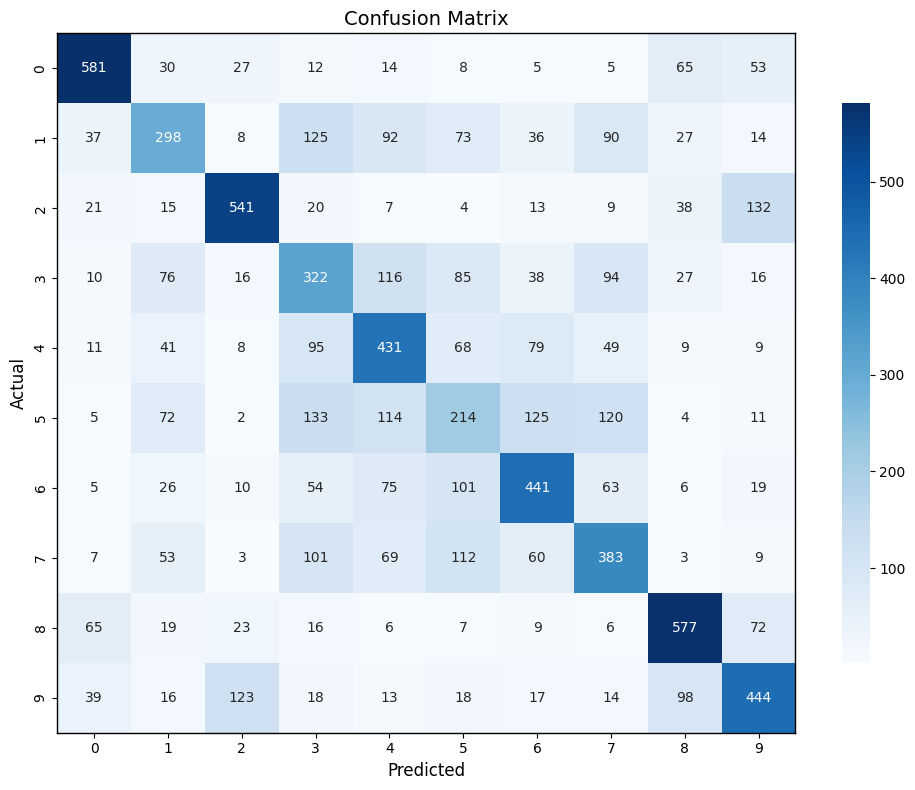

--------------------------------------------------
Experiment 6:
  pool_size: (3, 3)
  Test Accuracy: 0.5351
  Training History Accuracy: 1.0
  Training Time: 63.721357345581055
  Current Memory: 304.611328
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4725.4438400268555
    Average Time per Sample: 590.6804800033569
    Throughput: 1.6929626656941783




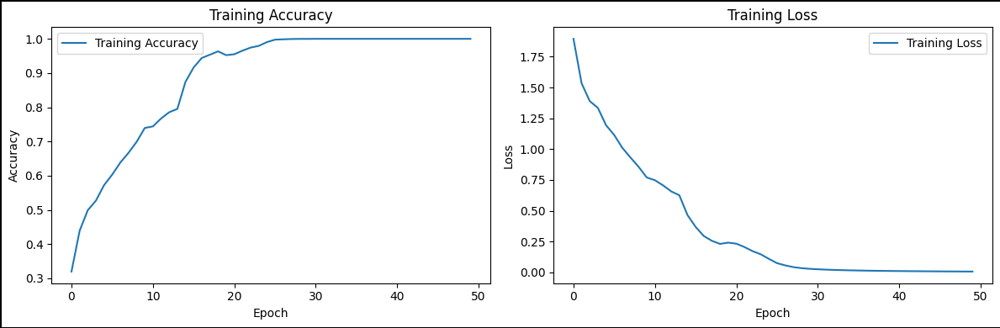


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


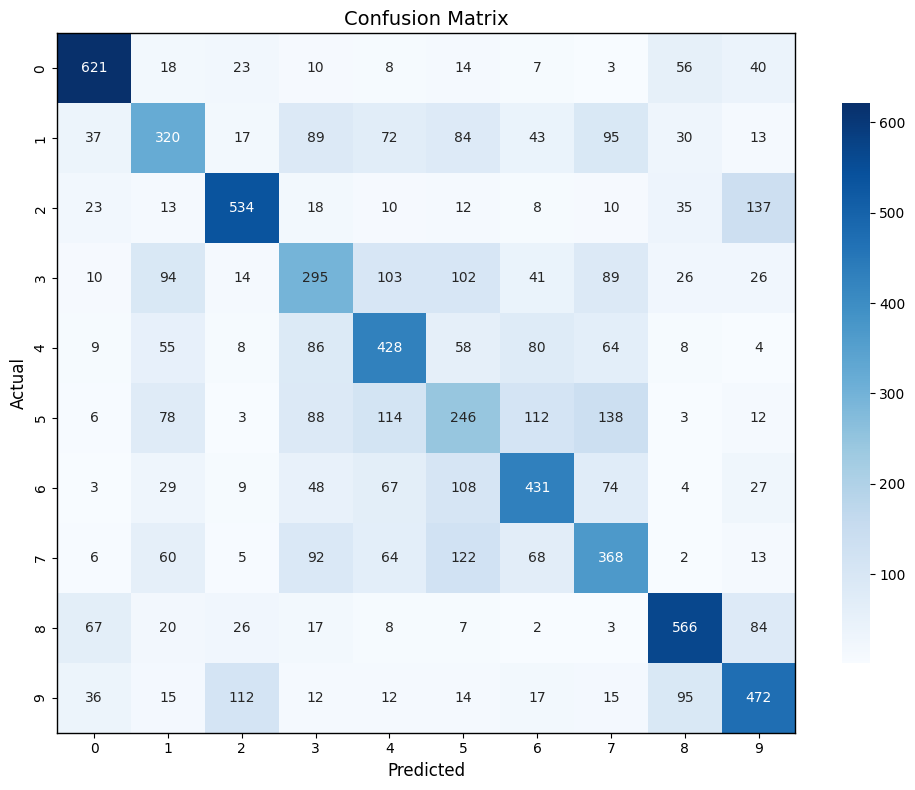

--------------------------------------------------
Experiment 7:
  pool_size: (3, 3)
  Test Accuracy: 0.5293
  Training History Accuracy: 1.0
  Training Time: 63.58084297180176
  Current Memory: 320.53248
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4664.166688919067
    Average Time per Sample: 583.0208361148834
    Throughput: 1.715204565695747




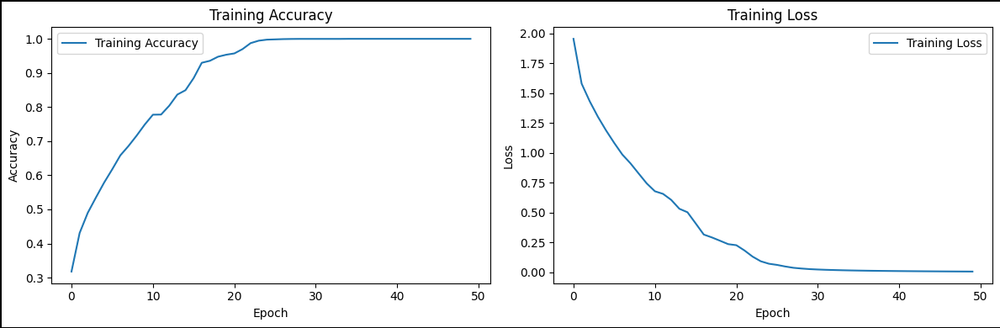


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


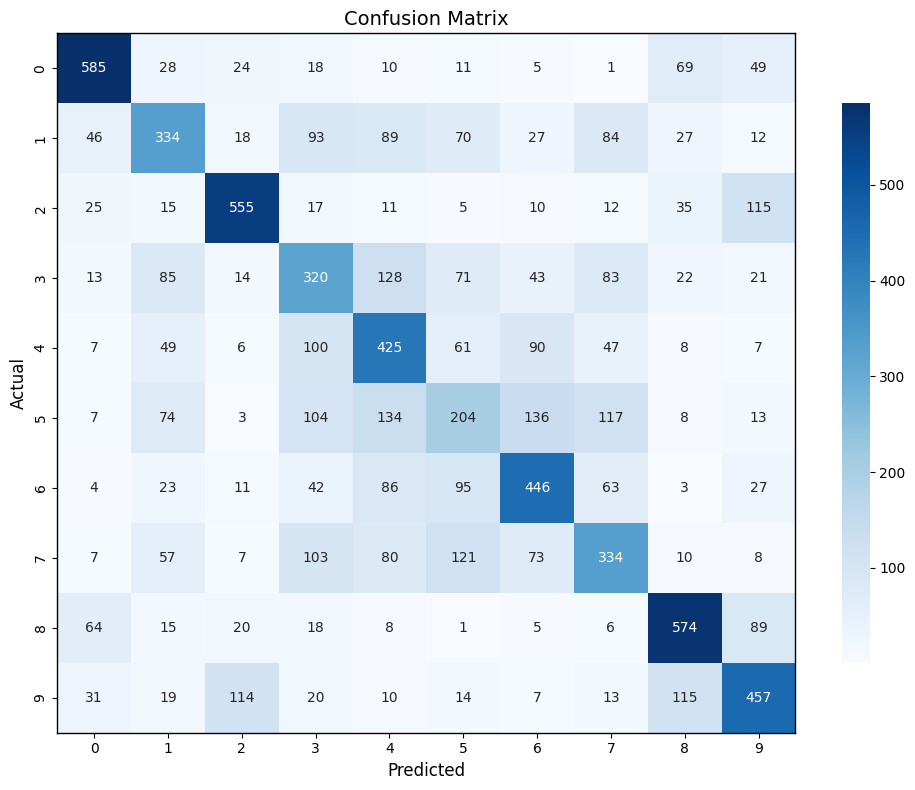

--------------------------------------------------
Experiment 8:
  pool_size: (3, 3)
  Test Accuracy: 0.5125
  Training History Accuracy: 1.0
  Training Time: 63.073829889297485
  Current Memory: 335.650816
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4669.397354125977
    Average Time per Sample: 583.6746692657471
    Throughput: 1.7132831912304558




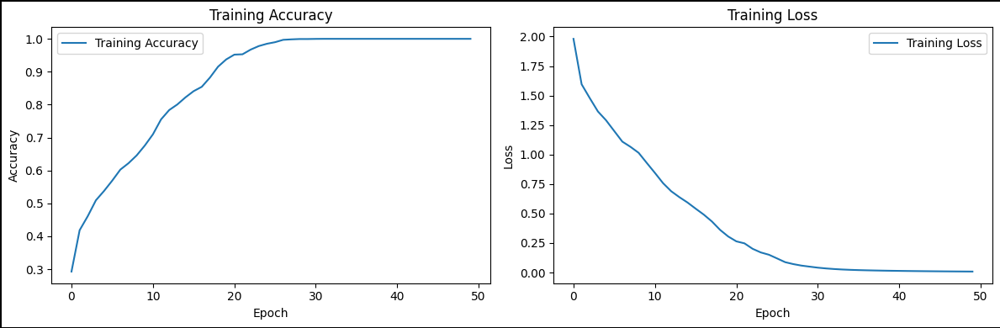


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step


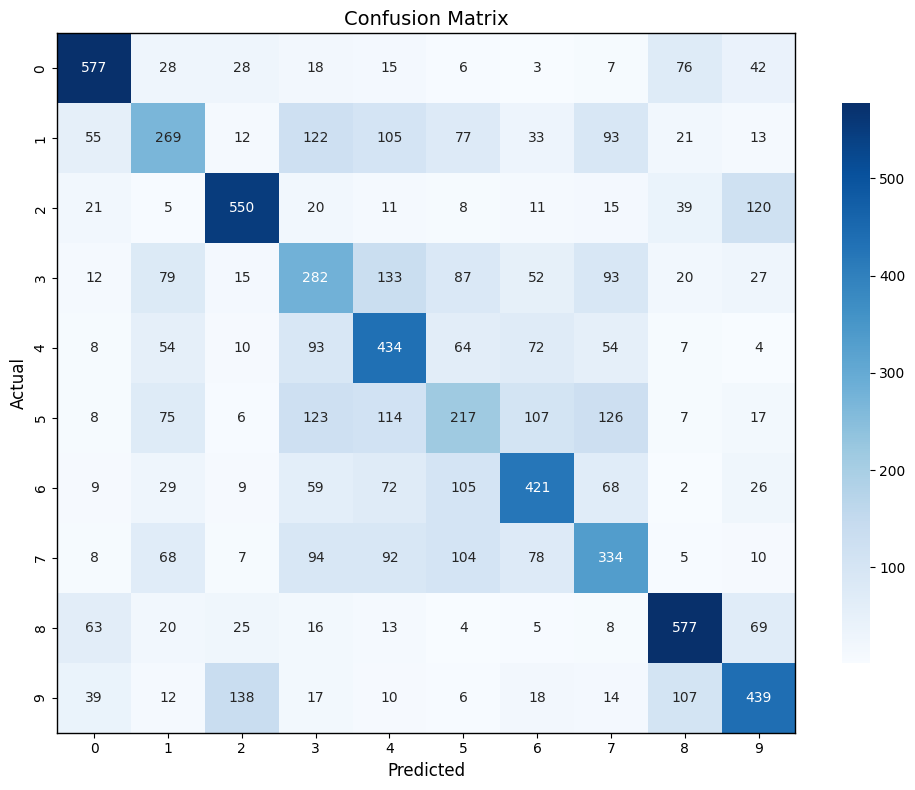

--------------------------------------------------
Experiment 9:
  pool_size: (4, 4)
  Test Accuracy: 0.5576
  Training History Accuracy: 1.0
  Training Time: 64.67381262779236
  Current Memory: 342.26944
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3860.541820526123
    Average Time per Sample: 482.5677275657654
    Throughput: 2.07224798277402




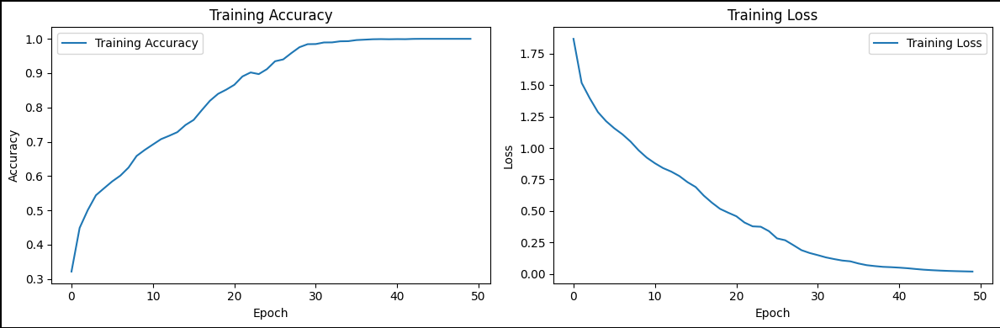


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


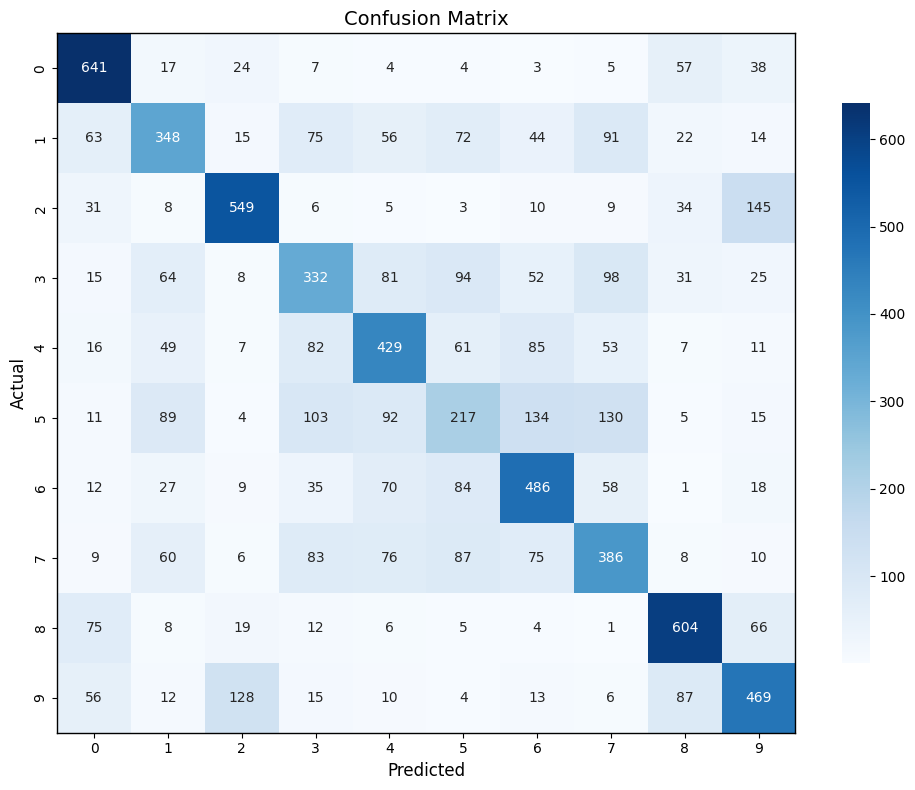

--------------------------------------------------
Experiment 10:
  pool_size: (4, 4)
  Test Accuracy: 0.5508
  Training History Accuracy: 1.0
  Training Time: 57.544090032577515
  Current Memory: 347.597568
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3297.2333431243896
    Average Time per Sample: 412.1541678905487
    Throughput: 2.426276568105843




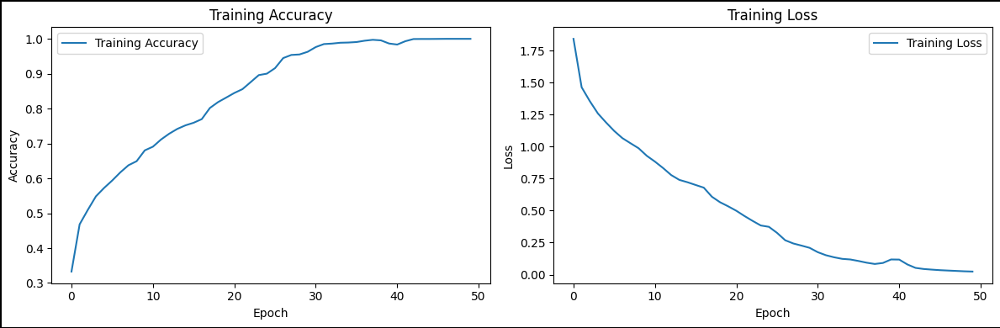


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step


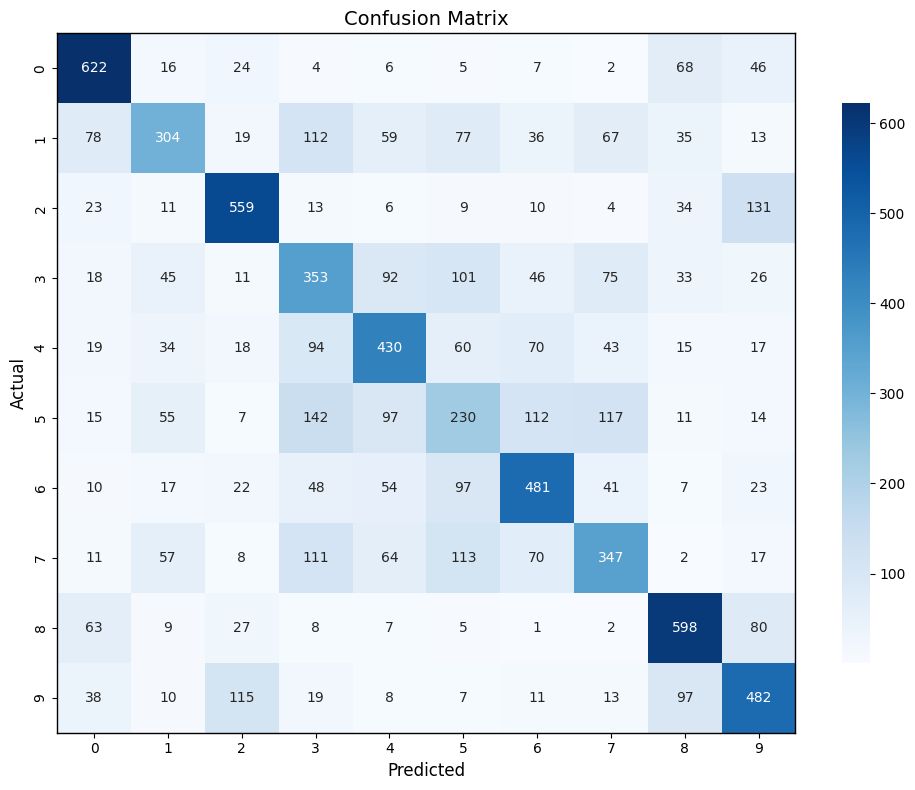

--------------------------------------------------
Experiment 11:
  pool_size: (4, 4)
  Test Accuracy: 0.5539
  Training History Accuracy: 0.9994000196456909
  Training Time: 59.114447593688965
  Current Memory: 353.043968
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4850.563526153564
    Average Time per Sample: 606.3204407691956
    Throughput: 1.6492929031575634




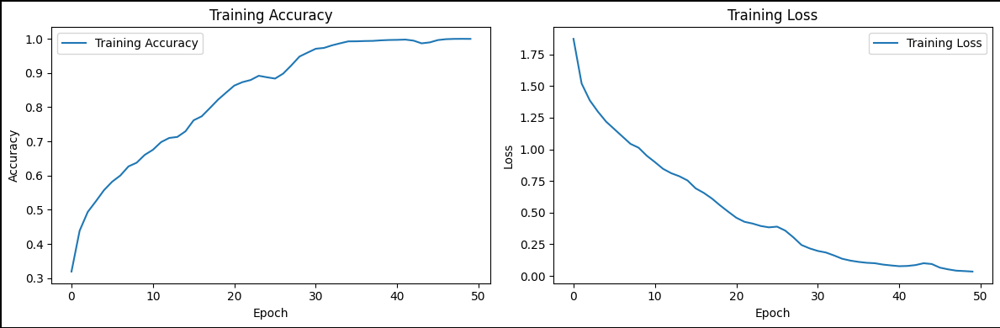


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step


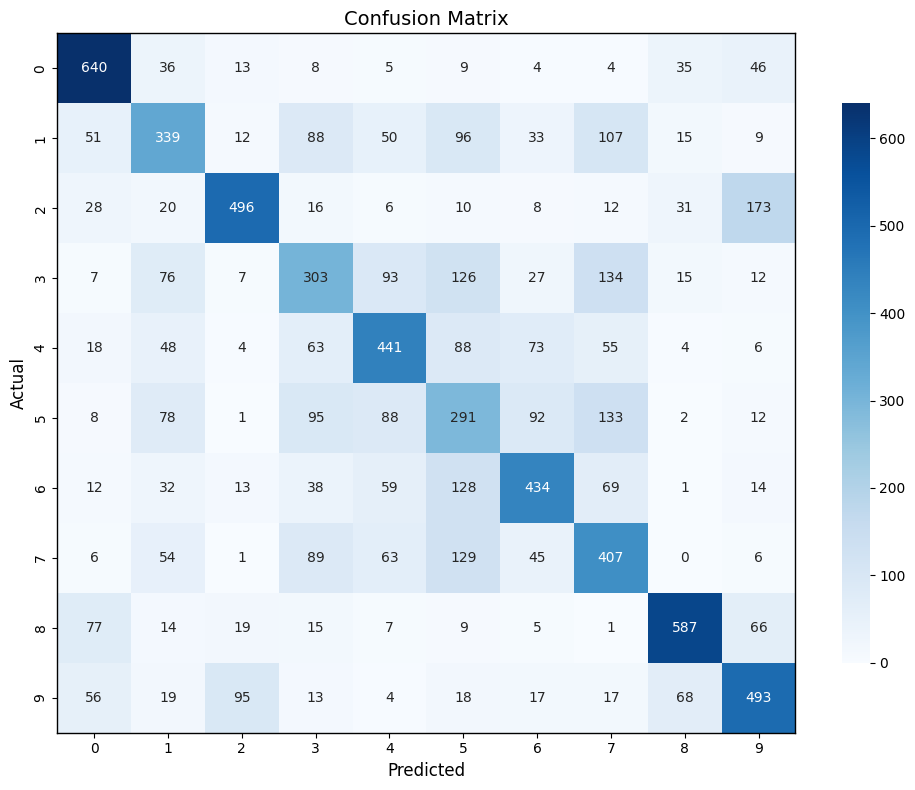

--------------------------------------------------
Experiment 12:
  pool_size: (4, 4)
  Test Accuracy: 0.5355
  Training History Accuracy: 0.9986000061035156
  Training Time: 60.95427966117859
  Current Memory: 359.384832
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3357.088565826416
    Average Time per Sample: 419.636070728302
    Throughput: 2.3830172612770006




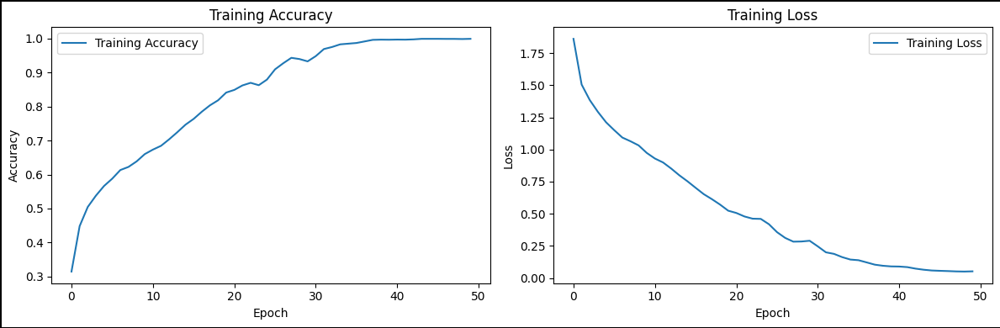


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step


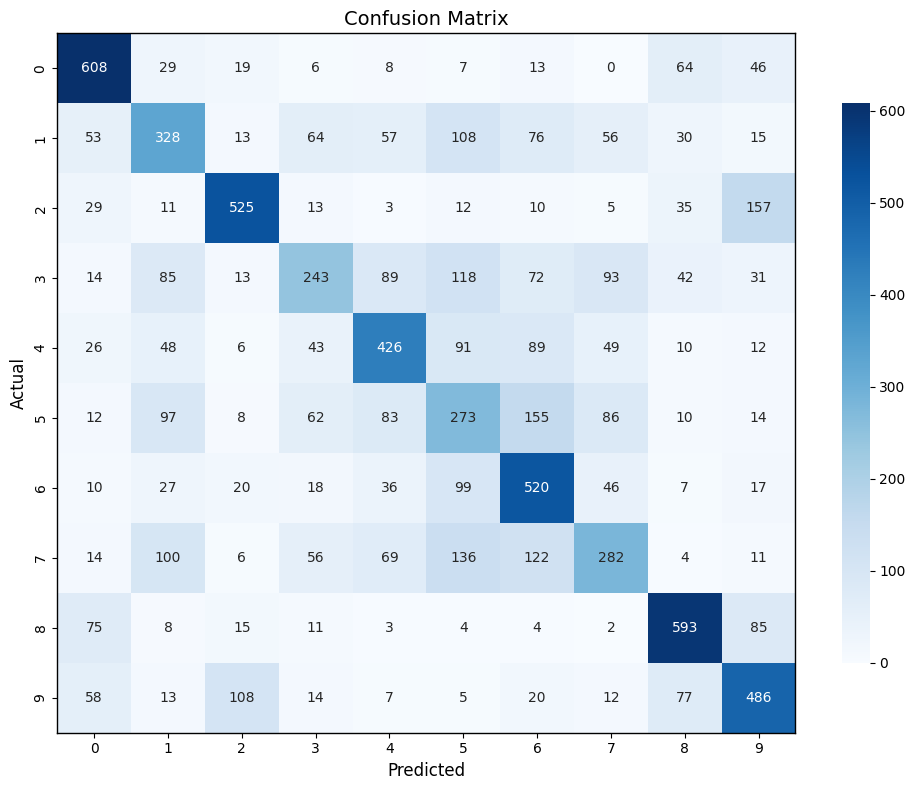

--------------------------------------------------
Experiment 13:
  pool_size: (4, 4)
  Test Accuracy: 0.5460
  Training History Accuracy: 0.9980000257492065
  Training Time: 63.087106704711914
  Current Memory: 364.729856
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3338.874101638794
    Average Time per Sample: 417.35926270484924
    Throughput: 2.396017267040234




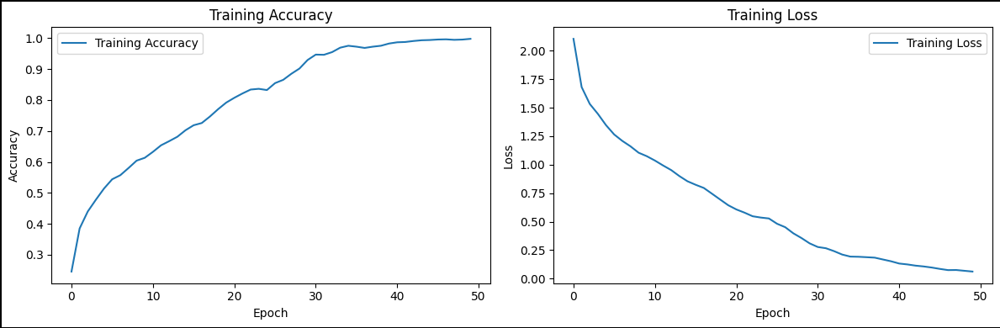


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


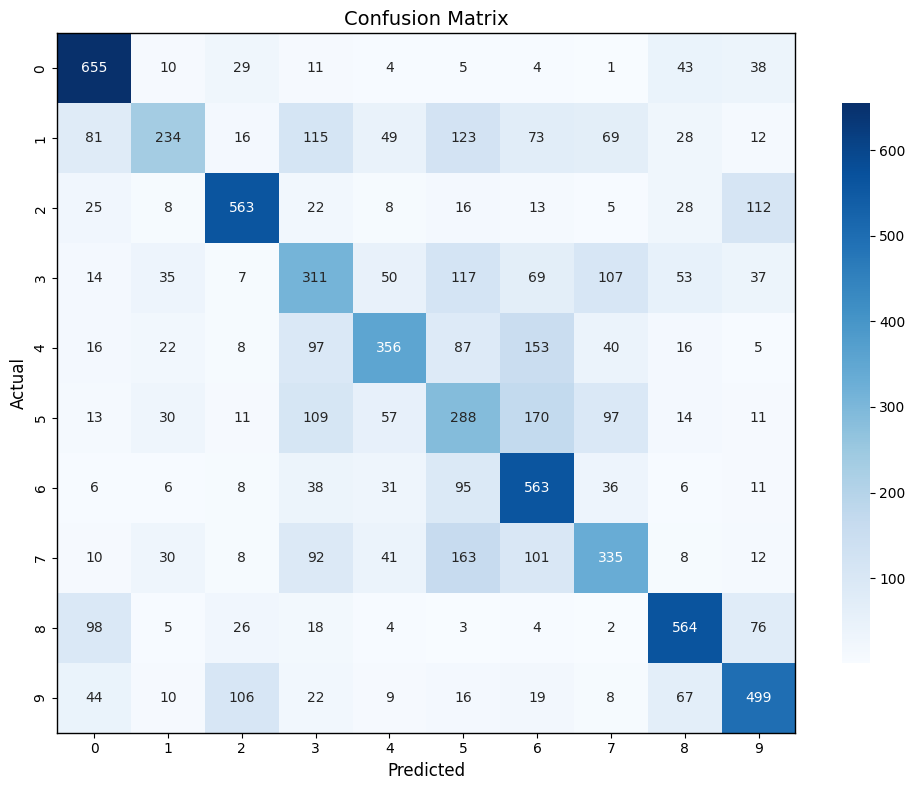

--------------------------------------------------
Experiment 14:
  pool_size: (4, 4)
  Test Accuracy: 0.5501
  Training History Accuracy: 0.9994000196456909
  Training Time: 64.00802040100098
  Current Memory: 370.198016
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3354.0849685668945
    Average Time per Sample: 419.2606210708618
    Throughput: 2.385151263302126




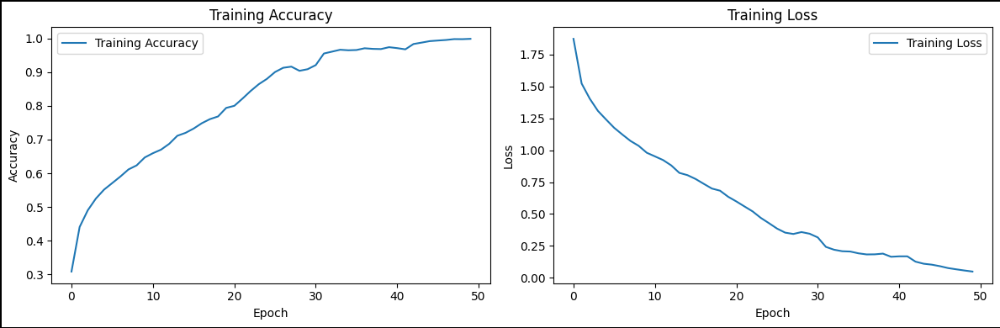


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


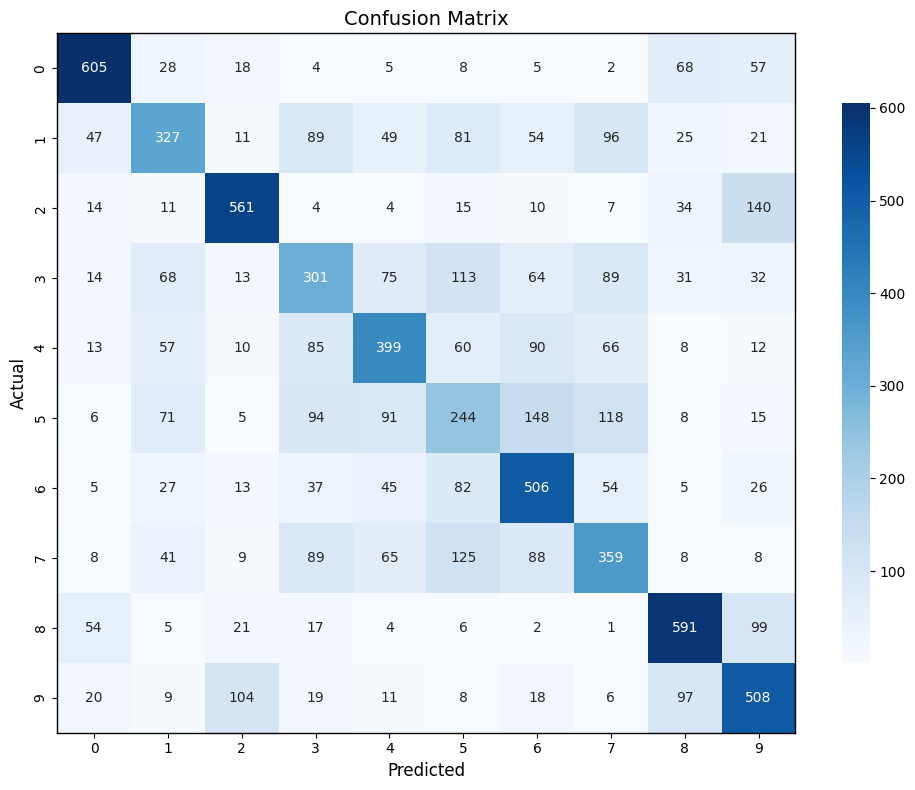

--------------------------------------------------
Experiment 15:
  pool_size: (4, 4)
  Test Accuracy: 0.5379
  Training History Accuracy: 0.9980000257492065
  Training Time: 61.34394860267639
  Current Memory: 376.441344
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3962.0285034179688
    Average Time per Sample: 495.2535629272461
    Throughput: 2.0191677049013017




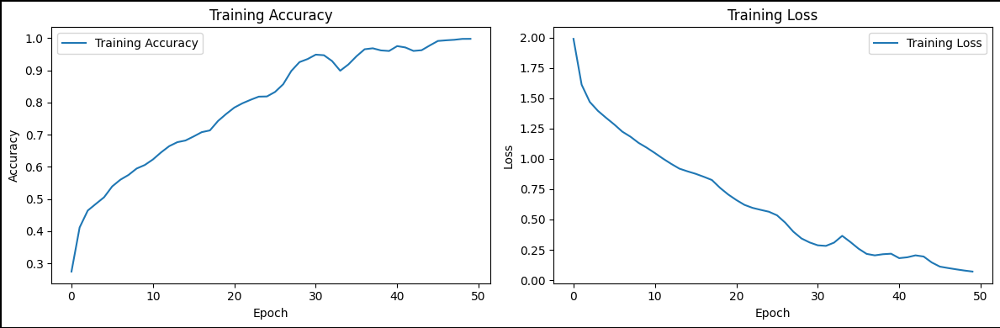


250/250 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step


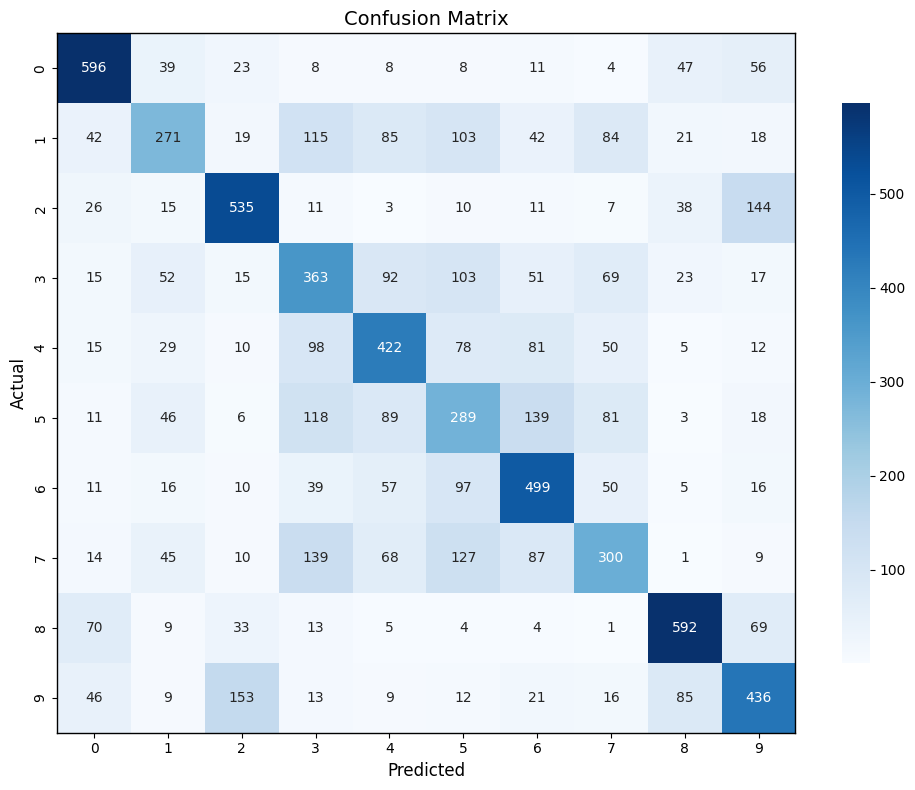

--------------------------------------------------
Experiment 16:
  pool_size: (4, 4)
  Test Accuracy: 0.5116
  Training History Accuracy: 0.9929999709129333
  Training Time: 59.09877252578735
  Current Memory: 381.782272
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3407.3855876922607
    Average Time per Sample: 425.9231984615326
    Throughput: 2.347841121620229




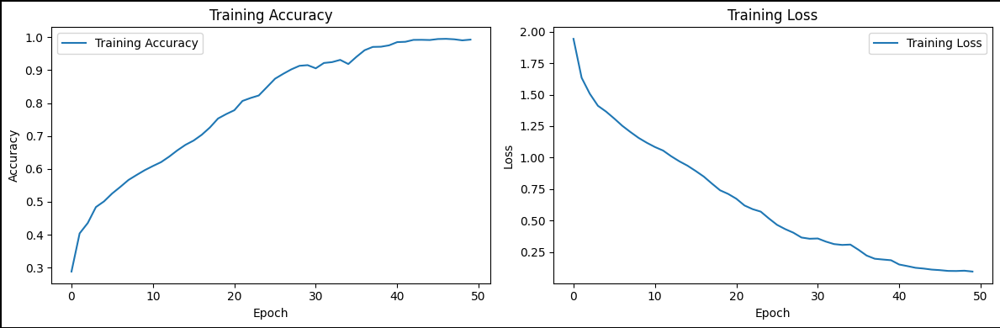


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


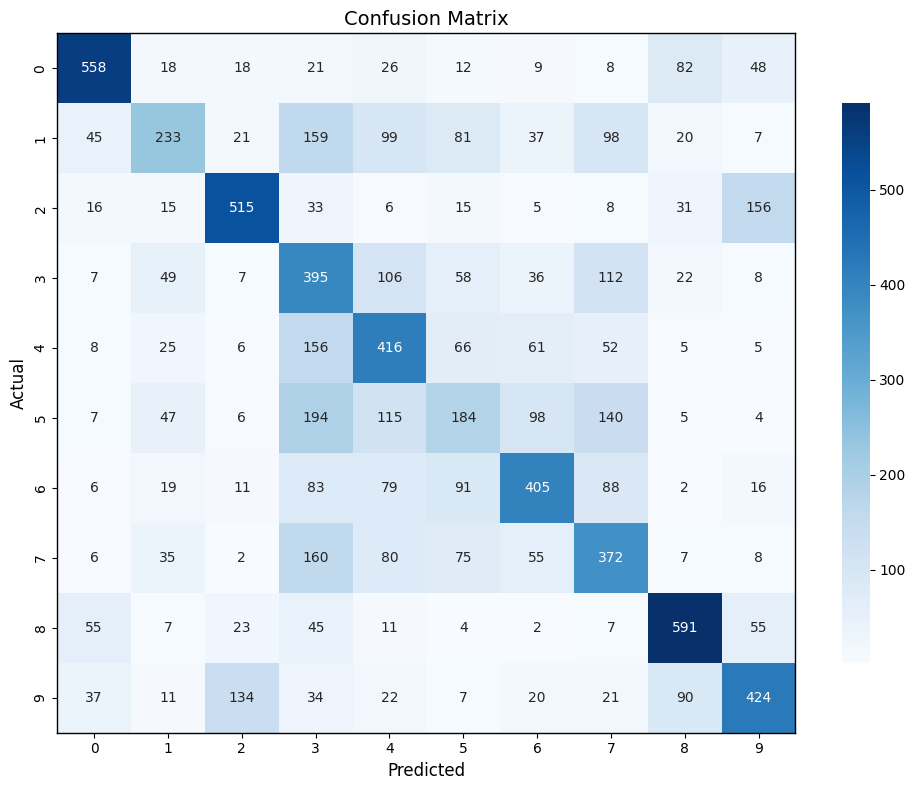

--------------------------------------------------
Experiment 17:
  pool_size: (4, 4)
  Test Accuracy: 0.5220
  Training History Accuracy: 0.9937999844551086
  Training Time: 57.800053119659424
  Current Memory: 387.237376
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3367.5320148468018
    Average Time per Sample: 420.9415018558502
    Throughput: 2.375627006582131




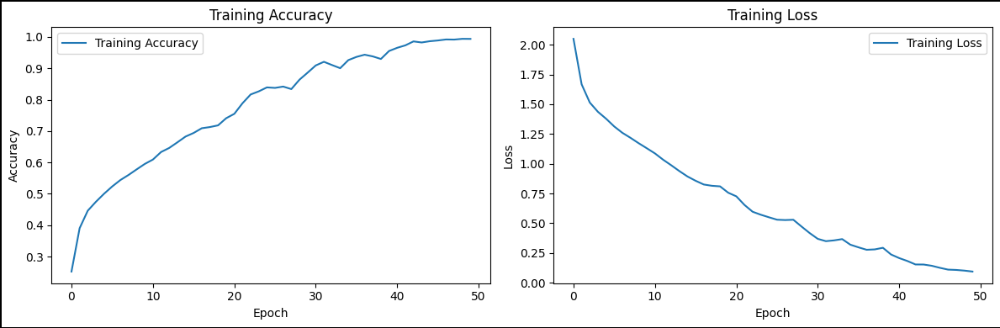


250/250 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step


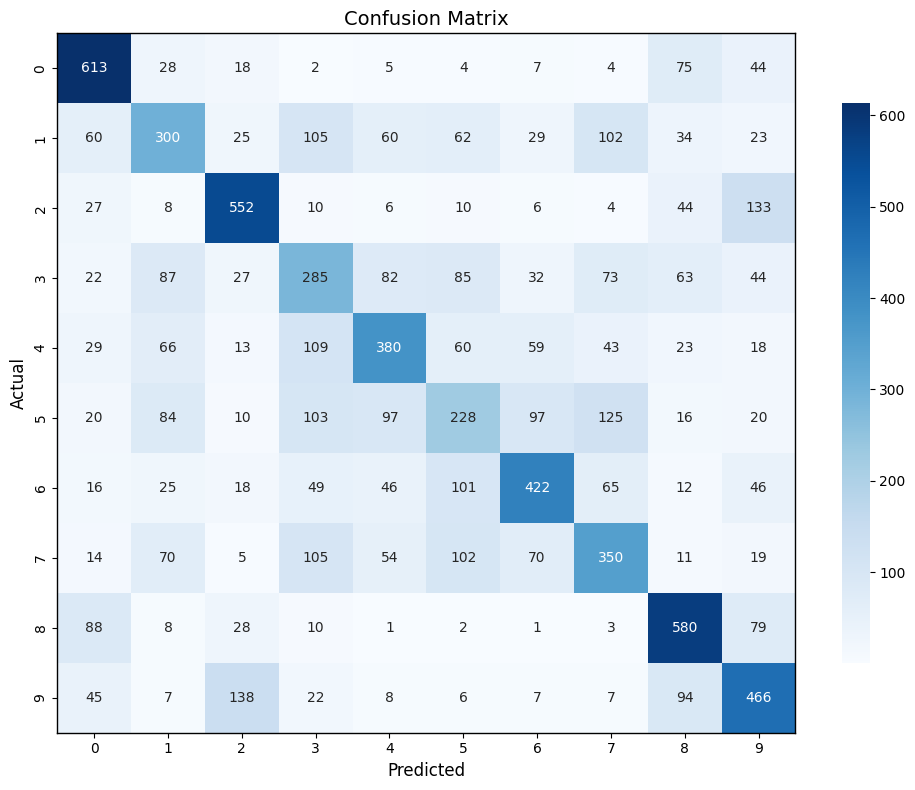

--------------------------------------------------


In [ ]:
print("\n=== Full Results Summary ===")
for idx, result in enumerate(results_avgthresholding, 1):
    print(f"Experiment {idx}:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training History Accuracy: {result['training_history']['accuracy'][-1]}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print()
    print()
    show_training_charts(result['training_history'])
    print()
    show_confusion_matrix(result['model'], x_test, y_test)
    print("-" * 50)

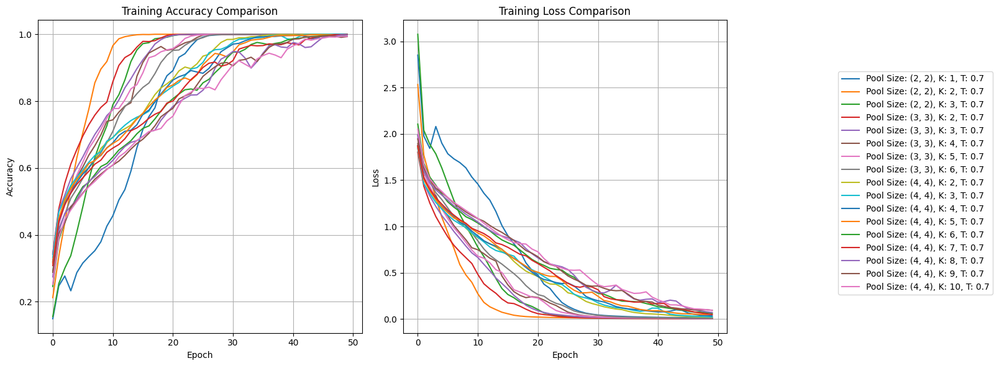

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

for idx, result in enumerate(results_avgthresholding):
    label = f"Pool Size: {result['pool_size']}, K: {result['k']}, T: {result['t']}"
    axes[0].plot(result['training_history']['accuracy'], label=label)
    axes[1].plot(result['training_history']['loss'], label=label)

axes[0].set_title('Training Accuracy Comparison')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Accuracy')
axes[0].grid(True)

axes[1].set_title('Training Loss Comparison')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Loss')
axes[1].grid(True)

# One legend for both subplots
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center right', bbox_to_anchor=(1.15, 0.5))

plt.tight_layout(rect=[0, 0, 0.85, 1])
plt.show()


In [ ]:
if SAVE_MODEL:
  for idx, result in enumerate(results_avgthresholding):
      model = result['model']
      pool_size = result['pool_size']
      k = result['k']
      t = result['t']
      model_name = f"averagethresholding_pooling_model_poolsize_{pool_size[0]}x{pool_size[1]}_k_{k}_t_{t}.h5"
      model.save(model_name)
      print(f"Saved model: {model_name}")

## prediction

In [ ]:
import tensorflow as tf

# Load the model from the .h5 file
# Replace 'path/to/your/model.h5' with the actual path to your saved model file
model = tf.keras.models.load_model('averagethresholding_pooling_model_poolsize_4x4_k_3_t_0.7.h5', custom_objects={'AverageThresholdingPooling2D': AverageThresholdingPooling2D})

===== testing data with predictions =====
4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 460ms/step


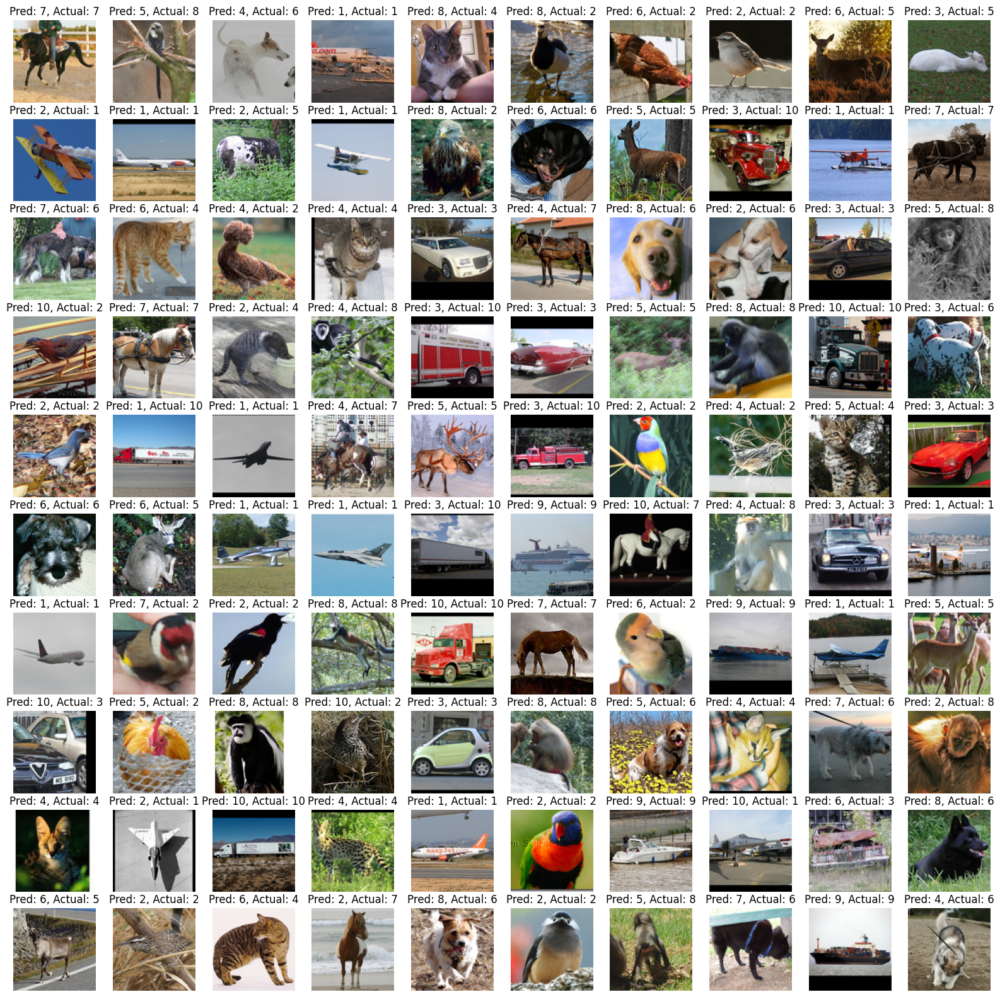

In [ ]:
print("===== testing data with predictions =====")
#model = results_avgthresholding[11]['model']
show_predictions(model, x_test, y_test)

In [ ]:
play_sound(440, 1.0)

In [ ]:
print("\n=== Full Results Summary ===")
for idx, result in enumerate(results_avgthresholding, 1):
    print(f"Experiment {idx}:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training History Accuracy: {result['training_history']['accuracy'][-1]}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print()
    print()
    show_training_charts(result['training_history'])
    print()
    show_confusion_matrix(result['model'], x_test, y_test)
    print("-" * 50)


=== Full Results Summary ===


NameError: name 'results_avgthresholding' is not defined

## optuna hyperparameter optimization

In [ ]:
def objective(trial):
    pool_size = trial.suggest_int("pool_size",2,5)
    k = trial.suggest_int("k",1,10)
    t = trial.suggest_float("t", 0.1, 0.9, step=0.01)

    print("START OBJECTIVE")
    print(f"\n=== Experiment: pool_size={pool_size}, k={k}, t={t} ===")

    result = run_experiment(pool_size=(pool_size, pool_size), k=k, t=t)
    testing_accuracy = result['test_accuracy']

    print("==============================")
    print(f"result:")
    print(f"  pool_size: {result['pool_size']}")
    print(f"  Test Accuracy: {result['test_accuracy']:.4f}")
    print(f"  Training Time: {result['training_time']}")
    print(f"  Current Memory: {result['current_mb']}")
    print(f"  Peak Memory: {result['peak_mb']}")
    print(f"  Inference Benchmark:")
    print(f"    Total Time: {result['inference_benchmark']['total_time_ms']}")
    print(f"    Average Time per Sample: {result['inference_benchmark']['avg_time_per_sample_ms']}")
    print(f"    Throughput: {result['inference_benchmark']['throughput']}")
    print("-" * 50)
    print("==============================")

    print("END OBJECTIVE")
    return testing_accuracy

MAX_TRIAL = 20

start_optuna_time = time.time()
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=MAX_TRIAL)

print("Best trial:")
trial = study.best_trial
print(f"  Value: {trial.value}")
print("  Params: ")
for key, value in trial.params.items():
    print(f"    {key}: {value}")

end_optuna_time = time.time()
print(f"optuna time: {end_optuna_time - start_optuna_time}")


[I 2025-09-10 02:13:23,232] A new study created in memory with name: no-name-c3996bac-e449-4bb1-9c67-8506465e49b8


START OBJECTIVE

=== Experiment: pool_size=5, k=3, t=0.14 ===

=== Experiment: pool_size=(5, 5), k=3, t=0.14 ===
creating model ...
pool_size (5, 5)
k 3
t 0.14
model created

=== model summary ===


Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 19, 19, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 3, 3, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 71ms/step - accuracy: 0.1848 - loss: 2.1644
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3746 - loss: 1.6991
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4215 - loss: 1.5769
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4425 - loss: 1.4997
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4596 - loss: 1.4449
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4842 - loss: 1.3953
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4969 - loss: 1.3696
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5058 - loss: 1.3535
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5280 - loss: 1.2882
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5425 - loss: 1.2484
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5569 - loss: 1.2149
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:15:16,727] Trial 0 finished with value: 0.5261250138282776 and parameters: {'pool_size': 5, 'k': 3, 't': 0.14}. Best is trial 0 with value: 0.5261250138282776.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5261
  Training Time: 61.55375647544861
  Current Memory: 395.789568
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3377.85267829895
    Average Time per Sample: 422.2315847873688
    Throughput: 2.3683685352520207
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=4, t=0.63 ===

=== Experiment: pool_size=(2, 2), k=4, t=0.63 ===
creating model ...
pool_size (2, 2)
k 4
t 0.63
model created

=== model summary ===


Model: "sequential_19"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_19 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 81ms/step - accuracy: 0.1402 - loss: 2.9736
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.2579 - loss: 1.9829
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.3167 - loss: 1.8443
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.3639 - loss: 1.7601
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.4156 - loss: 1.6428
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step - accuracy: 0.4606 - loss: 1.5164
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.5470 - loss: 1.3298
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.6273 - loss: 1.1659
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.6947 - loss: 1.0302
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7271 - loss: 0.9552
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.7625 - loss: 0.8644
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:17:20,983] Trial 1 finished with value: 0.32737499475479126 and parameters: {'pool_size': 2, 'k': 4, 't': 0.63}. Best is trial 0 with value: 0.5261250138282776.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3274
  Training Time: 107.02823615074158
  Current Memory: 468.425472
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4785.0847244262695
    Average Time per Sample: 598.1355905532837
    Throughput: 1.671861724655084
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=6, t=0.11 ===

=== Experiment: pool_size=(4, 4), k=6, t=0.11 ===
creating model ...
pool_size (4, 4)
k 6
t 0.11
model created

=== model summary ===


Model: "sequential_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_20 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 71ms/step - accuracy: 0.2582 - loss: 2.0785
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4185 - loss: 1.5722
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4806 - loss: 1.4252
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5159 - loss: 1.3230
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5358 - loss: 1.2494
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5760 - loss: 1.1636
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5974 - loss: 1.1062
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6188 - loss: 1.0467
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6376 - loss: 0.9967
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6632 - loss: 0.9497
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6812 - loss: 0.9036
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:18:35,204] Trial 2 finished with value: 0.5363749861717224 and parameters: {'pool_size': 4, 'k': 6, 't': 0.11}. Best is trial 2 with value: 0.5363749861717224.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5364
  Training Time: 60.883232831954956
  Current Memory: 473.756672
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3396.2631225585938
    Average Time per Sample: 424.5328903198242
    Throughput: 2.3555300962586068
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=4, t=0.55 ===

=== Experiment: pool_size=(4, 4), k=4, t=0.55 ===
creating model ...
pool_size (4, 4)
k 4
t 0.55
model created

=== model summary ===


Model: "sequential_21"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_21 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.2521 - loss: 2.0638
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4178 - loss: 1.5922
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4703 - loss: 1.4407
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5035 - loss: 1.3529
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5395 - loss: 1.2672
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5656 - loss: 1.1940
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5925 - loss: 1.1275
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6057 - loss: 1.0829
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6354 - loss: 1.0175
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6456 - loss: 0.9810
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6617 - loss: 0.9396
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:19:47,769] Trial 3 finished with value: 0.5412499904632568 and parameters: {'pool_size': 4, 'k': 4, 't': 0.55}. Best is trial 3 with value: 0.5412499904632568.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5412
  Training Time: 59.47551083564758
  Current Memory: 479.298048
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3314.4829273223877
    Average Time per Sample: 414.31036591529846
    Throughput: 2.4136494818100687
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=9, t=0.2 ===

=== Experiment: pool_size=(2, 2), k=9, t=0.2 ===
creating model ...
pool_size (2, 2)
k 9
t 0.2
model created

=== model summary ===


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 105ms/step - accuracy: 0.2182 - loss: 2.4194
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 35ms/step - accuracy: 0.4352 - loss: 1.6070
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.5340 - loss: 1.3632
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.6319 - loss: 1.1268
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7071 - loss: 0.9139
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.8062 - loss: 0.6850
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.8310 - loss: 0.5750
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.8930 - loss: 0.4262
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - accuracy: 0.9598 - loss: 0.2634
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step - accuracy: 0.9799 - loss: 0.1866
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step - accuracy: 0.9878 - loss: 0.1539
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━

[I 2025-09-10 02:21:46,580] Trial 4 finished with value: 0.3251250088214874 and parameters: {'pool_size': 2, 'k': 9, 't': 0.2}. Best is trial 3 with value: 0.5412499904632568.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3251
  Training Time: 103.98126029968262
  Current Memory: 549.956608
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4707.991600036621
    Average Time per Sample: 588.4989500045776
    Throughput: 1.6992383758581413
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=2, k=5, t=0.85 ===

=== Experiment: pool_size=(2, 2), k=5, t=0.85 ===
creating model ...
pool_size (2, 2)
k 5
t 0.85
model created

=== model summary ===


Model: "sequential_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 48, 48, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 48, 48, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 24, 24, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 24, 24, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_23 (Flatten)            │ (None, 69120)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     5,806,164 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,858,006 (22.35 MB)

 Trainable params: 5,858,006 (22.35 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 80ms/step - accuracy: 0.2018 - loss: 2.8775
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 34ms/step - accuracy: 0.3663 - loss: 1.7711
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 34ms/step - accuracy: 0.4354 - loss: 1.6072
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - accuracy: 0.5191 - loss: 1.4199
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.5784 - loss: 1.2516
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - accuracy: 0.6574 - loss: 1.0826
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.6852 - loss: 1.0140
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7629 - loss: 0.8417
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.7881 - loss: 0.7637
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.8556 - loss: 0.6116
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 3s 36ms/step - accuracy: 0.8901 - loss: 0.5142
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:23:50,972] Trial 5 finished with value: 0.33675000071525574 and parameters: {'pool_size': 2, 'k': 5, 't': 0.85}. Best is trial 3 with value: 0.5412499904632568.


result:
  pool_size: (2, 2)
  Test Accuracy: 0.3368
  Training Time: 108.55491971969604
  Current Memory: 643.334912
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 5320.430755615234
    Average Time per Sample: 665.0538444519043
    Throughput: 1.5036376503080549
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=5, t=0.88 ===

=== Experiment: pool_size=(4, 4), k=5, t=0.88 ===
creating model ...
pool_size (4, 4)
k 5
t 0.88
model created

=== model summary ===


Model: "sequential_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_24 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 91ms/step - accuracy: 0.2120 - loss: 2.1443
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4025 - loss: 1.6021
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4784 - loss: 1.4412
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5085 - loss: 1.3409
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5582 - loss: 1.2536
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.5807 - loss: 1.1733
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6085 - loss: 1.1137
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6234 - loss: 1.0658
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6372 - loss: 1.0228
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6504 - loss: 0.9725
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6665 - loss: 0.9224
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:25:08,011] Trial 6 finished with value: 0.5525000095367432 and parameters: {'pool_size': 4, 'k': 5, 't': 0.88}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5525
  Training Time: 62.81322360038757
  Current Memory: 648.679424
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 5008.681297302246
    Average Time per Sample: 626.0851621627808
    Throughput: 1.597226799858263
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=1, t=0.73 ===

=== Experiment: pool_size=(5, 5), k=1, t=0.73 ===
creating model ...
pool_size (5, 5)
k 1
t 0.73
model created

=== model summary ===


Model: "sequential_25"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 19, 19, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 3, 3, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_25 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 66ms/step - accuracy: 0.2147 - loss: 2.1271
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3921 - loss: 1.6595
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4521 - loss: 1.4908
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4967 - loss: 1.3932
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5178 - loss: 1.3341
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5477 - loss: 1.2751
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5637 - loss: 1.2313
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5758 - loss: 1.1921
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5882 - loss: 1.1610
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6009 - loss: 1.1341
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6093 - loss: 1.1060
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:26:17,562] Trial 7 finished with value: 0.5131250023841858 and parameters: {'pool_size': 5, 'k': 1, 't': 0.73}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5131
  Training Time: 56.7103533744812
  Current Memory: 651.035392
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3312.262535095215
    Average Time per Sample: 414.03281688690186
    Throughput: 2.415267484154915
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=2, t=0.21000000000000002 ===

=== Experiment: pool_size=(4, 4), k=2, t=0.21000000000000002 ===
creating model ...
pool_size (4, 4)
k 2
t 0.21000000000000002
model created

=== model summary ===


Model: "sequential_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_26 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 78ms/step - accuracy: 0.2376 - loss: 2.1178
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 21ms/step - accuracy: 0.4578 - loss: 1.5075
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5152 - loss: 1.3588
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5483 - loss: 1.2579
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5800 - loss: 1.1717
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6105 - loss: 1.0957
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6408 - loss: 1.0171
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6534 - loss: 0.9543
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6786 - loss: 0.9092
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6957 - loss: 0.8650
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.7086 - loss: 0.8229
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:27:34,850] Trial 8 finished with value: 0.5431249737739563 and parameters: {'pool_size': 4, 'k': 2, 't': 0.21000000000000002}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5431
  Training Time: 64.1112654209137
  Current Memory: 657.421824
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3386.630058288574
    Average Time per Sample: 423.3287572860718
    Throughput: 2.3622302590802557
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=2, t=0.1 ===

=== Experiment: pool_size=(4, 4), k=2, t=0.1 ===
creating model ...
pool_size (4, 4)
k 2
t 0.1
model created

=== model summary ===


Model: "sequential_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_27 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 90ms/step - accuracy: 0.1983 - loss: 2.2054
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - accuracy: 0.4185 - loss: 1.5670
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4869 - loss: 1.4057
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5281 - loss: 1.2913
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5613 - loss: 1.2102
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5827 - loss: 1.1366
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6095 - loss: 1.0723
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6287 - loss: 1.0141
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6444 - loss: 0.9771
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6627 - loss: 0.9264
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.6901 - loss: 0.8733
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:28:51,034] Trial 9 finished with value: 0.5519999861717224 and parameters: {'pool_size': 4, 'k': 2, 't': 0.1}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5520
  Training Time: 62.810760498046875
  Current Memory: 662.747904
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4840.285062789917
    Average Time per Sample: 605.0356328487396
    Throughput: 1.6527952168562647
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=7, t=0.4 ===

=== Experiment: pool_size=(3, 3), k=7, t=0.4 ===
creating model ...
pool_size (3, 3)
k 7
t 0.4
model created

=== model summary ===


Model: "sequential_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_28 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 77ms/step - accuracy: 0.2163 - loss: 2.2426
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 26ms/step - accuracy: 0.4042 - loss: 1.6233
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4594 - loss: 1.4896
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5001 - loss: 1.3952
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5314 - loss: 1.3197
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5579 - loss: 1.2369
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5903 - loss: 1.1590
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6142 - loss: 1.0943
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6311 - loss: 1.0530
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6777 - loss: 0.9528
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7027 - loss: 0.8847
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:30:14,644] Trial 10 finished with value: 0.47699999809265137 and parameters: {'pool_size': 3, 'k': 7, 't': 0.4}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.4770
  Training Time: 69.79700446128845
  Current Memory: 675.830784
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3540.1453971862793
    Average Time per Sample: 442.5181746482849
    Throughput: 2.2597941899105134
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=8, t=0.42000000000000004 ===

=== Experiment: pool_size=(3, 3), k=8, t=0.42000000000000004 ===
creating model ...
pool_size (3, 3)
k 8
t 0.42000000000000004
model created

=== model summary ===


Model: "sequential_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_29 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 75ms/step - accuracy: 0.1890 - loss: 2.2941
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 27ms/step - accuracy: 0.3264 - loss: 1.8404
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.3912 - loss: 1.7187
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4208 - loss: 1.6330
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4267 - loss: 1.5703
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.4694 - loss: 1.4892
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4945 - loss: 1.4366
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5025 - loss: 1.3785
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5264 - loss: 1.3343
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5473 - loss: 1.2659
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5705 - loss: 1.2115
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:31:39,507] Trial 11 finished with value: 0.42012500762939453 and parameters: {'pool_size': 3, 'k': 8, 't': 0.42000000000000004}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.4201
  Training Time: 70.26072931289673
  Current Memory: 691.722752
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4723.6292362213135
    Average Time per Sample: 590.4536545276642
    Throughput: 1.6936130250560548
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=1, t=0.87 ===

=== Experiment: pool_size=(4, 4), k=1, t=0.87 ===
creating model ...
pool_size (4, 4)
k 1
t 0.87
model created

=== model summary ===


Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_30 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 64ms/step - accuracy: 0.2389 - loss: 2.1023
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - accuracy: 0.4529 - loss: 1.5313
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5080 - loss: 1.3750
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5407 - loss: 1.2721
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5785 - loss: 1.1686
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6032 - loss: 1.0966
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6344 - loss: 1.0243
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6587 - loss: 0.9559
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6849 - loss: 0.8944
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.7074 - loss: 0.8372
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.7277 - loss: 0.7864
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:32:57,612] Trial 12 finished with value: 0.5322499871253967 and parameters: {'pool_size': 4, 'k': 1, 't': 0.87}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5322
  Training Time: 65.77618312835693
  Current Memory: 697.988096
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3751.098155975342
    Average Time per Sample: 468.8872694969177
    Throughput: 2.1327087874936934
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=10, t=0.36 ===

=== Experiment: pool_size=(5, 5), k=10, t=0.36 ===
creating model ...
pool_size (5, 5)
k 10
t 0.36
model created

=== model summary ===


Model: "sequential_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 19, 19, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 3, 3, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_31 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 67ms/step - accuracy: 0.1900 - loss: 2.1636
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3751 - loss: 1.7083
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4184 - loss: 1.5795
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4659 - loss: 1.4817
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4639 - loss: 1.4650
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4906 - loss: 1.4070
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5123 - loss: 1.3617
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5182 - loss: 1.3442
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5320 - loss: 1.3087
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5367 - loss: 1.2823
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5412 - loss: 1.2584
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:34:07,957] Trial 13 finished with value: 0.5264999866485596 and parameters: {'pool_size': 5, 'k': 10, 't': 0.36}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5265
  Training Time: 55.20023846626282
  Current Memory: 700.215552
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3386.713981628418
    Average Time per Sample: 423.33924770355225
    Throughput: 2.3621717226186894
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=3, t=0.71 ===

=== Experiment: pool_size=(3, 3), k=3, t=0.71 ===
creating model ...
pool_size (3, 3)
k 3
t 0.71
model created

=== model summary ===


Model: "sequential_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_32 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 90ms/step - accuracy: 0.2290 - loss: 2.3534
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 27ms/step - accuracy: 0.4125 - loss: 1.5793
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.4777 - loss: 1.4373
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5277 - loss: 1.3193
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5834 - loss: 1.2154
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6077 - loss: 1.1064
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6312 - loss: 1.0277
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6599 - loss: 0.9699
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7011 - loss: 0.8944
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7385 - loss: 0.7987
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.7427 - loss: 0.7591
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:35:31,173] Trial 14 finished with value: 0.5331249833106995 and parameters: {'pool_size': 3, 'k': 3, 't': 0.71}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5331
  Training Time: 68.4906599521637
  Current Memory: 713.294848
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 4701.456785202026
    Average Time per Sample: 587.6820981502533
    Throughput: 1.7016002412656936
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=6, t=0.29000000000000004 ===

=== Experiment: pool_size=(4, 4), k=6, t=0.29000000000000004 ===
creating model ...
pool_size (4, 4)
k 6
t 0.29000000000000004
model created

=== model summary ===


Model: "sequential_33"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_33 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 10s 71ms/step - accuracy: 0.2323 - loss: 2.1183
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.3982 - loss: 1.6281
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4540 - loss: 1.4992
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4737 - loss: 1.4278
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.4948 - loss: 1.3617
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5266 - loss: 1.2797
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.5570 - loss: 1.2173
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5708 - loss: 1.1655
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5859 - loss: 1.1158
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6052 - loss: 1.0697
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6250 - loss: 1.0124
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━

[I 2025-09-10 02:36:48,342] Trial 15 finished with value: 0.5101249814033508 and parameters: {'pool_size': 4, 'k': 6, 't': 0.29000000000000004}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5101
  Training Time: 63.84500694274902
  Current Memory: 719.77984
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3398.0507850646973
    Average Time per Sample: 424.75634813308716
    Throughput: 2.354290887929647
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=5, t=0.53 ===

=== Experiment: pool_size=(3, 3), k=5, t=0.53 ===
creating model ...
pool_size (3, 3)
k 5
t 0.53
model created

=== model summary ===


Model: "sequential_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_34 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 77ms/step - accuracy: 0.2567 - loss: 2.1676
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 5s 27ms/step - accuracy: 0.3989 - loss: 1.6245
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.4834 - loss: 1.4392
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.5123 - loss: 1.3439
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.5521 - loss: 1.2420
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5821 - loss: 1.1513
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6130 - loss: 1.0803
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.6237 - loss: 1.0447
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6531 - loss: 0.9711
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6714 - loss: 0.9264
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7197 - loss: 0.8301
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:38:12,695] Trial 16 finished with value: 0.515999972820282 and parameters: {'pool_size': 3, 'k': 5, 't': 0.53}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5160
  Training Time: 70.47612738609314
  Current Memory: 734.954752
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3638.5135650634766
    Average Time per Sample: 454.81419563293457
    Throughput: 2.198700061699628
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=5, k=3, t=0.62 ===

=== Experiment: pool_size=(5, 5), k=3, t=0.62 ===
creating model ...
pool_size (5, 5)
k 3
t 0.62
model created

=== model summary ===


Model: "sequential_35"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 19, 19, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 19, 19, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 3, 3, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 3, 3, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_35 (Flatten)            │ (None, 1080)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │        90,804 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 142,646 (557.21 KB)

 Trainable params: 142,646 (557.21 KB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 69ms/step - accuracy: 0.2278 - loss: 2.0842
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.3782 - loss: 1.6544
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4311 - loss: 1.5315
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4606 - loss: 1.4447
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4901 - loss: 1.3698
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5071 - loss: 1.3246
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5261 - loss: 1.2832
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5439 - loss: 1.2497
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5548 - loss: 1.2163
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5694 - loss: 1.1901
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5789 - loss: 1.1626
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:39:26,510] Trial 17 finished with value: 0.5236250162124634 and parameters: {'pool_size': 5, 'k': 3, 't': 0.62}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (5, 5)
  Test Accuracy: 0.5236
  Training Time: 60.33432483673096
  Current Memory: 737.034752
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3410.4132652282715
    Average Time per Sample: 426.30165815353394
    Throughput: 2.345756768414555
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=4, k=7, t=0.78 ===

=== Experiment: pool_size=(4, 4), k=7, t=0.78 ===
creating model ...
pool_size (4, 4)
k 7
t 0.78
model created

=== model summary ===


Model: "sequential_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 24, 24, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 24, 24, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 6, 6, 16)       │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 6, 6, 120)      │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_36 (Flatten)            │ (None, 4320)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │       362,964 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 414,806 (1.58 MB)

 Trainable params: 414,806 (1.58 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 9s 106ms/step - accuracy: 0.2433 - loss: 2.0459
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4164 - loss: 1.5891
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4656 - loss: 1.4495
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.4903 - loss: 1.3687
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5185 - loss: 1.3023
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.5394 - loss: 1.2564
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5664 - loss: 1.1902
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.5868 - loss: 1.1292
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6040 - loss: 1.0745
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6172 - loss: 1.0341
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.6323 - loss: 0.9958
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━

[I 2025-09-10 02:40:40,707] Trial 18 finished with value: 0.5397499799728394 and parameters: {'pool_size': 4, 'k': 7, 't': 0.78}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (4, 4)
  Test Accuracy: 0.5397
  Training Time: 60.82393193244934
  Current Memory: 743.292928
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3479.7651767730713
    Average Time per Sample: 434.9706470966339
    Throughput: 2.29900570687897
--------------------------------------------------
END OBJECTIVE
START OBJECTIVE

=== Experiment: pool_size=3, k=2, t=0.29000000000000004 ===

=== Experiment: pool_size=(3, 3), k=2, t=0.29000000000000004 ===
creating model ...
pool_size (3, 3)
k 2
t 0.29000000000000004
model created

=== model summary ===


Model: "sequential_37"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1 (Conv2D)                  │ (None, 96, 96, 6)      │           456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool1                           │ (None, 32, 32, 6)      │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2 (Conv2D)                  │ (None, 32, 32, 16)     │         2,416 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ pool2                           │ (None, 10, 10, 16)     │             0 │
│ (AverageThresholdingPooling2D)  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv3 (Conv2D)                  │ (None, 10, 10, 120)    │        48,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_37 (Flatten)            │ (None, 12000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc1 (Dense)                     │ (None, 84)             │     1,008,084 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ fc2 (Dense)                     │ (None, 10)             │           850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,059,926 (4.04 MB)

 Trainable params: 1,059,926 (4.04 MB)

 Non-trainable params: 0 (0.00 B)


=== model training ===
Epoch 1/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 73ms/step - accuracy: 0.2171 - loss: 2.3907
Epoch 2/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step - accuracy: 0.4129 - loss: 1.6038
Epoch 3/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.5136 - loss: 1.3802
Epoch 4/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.5563 - loss: 1.2585
Epoch 5/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6013 - loss: 1.1052
Epoch 6/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - accuracy: 0.6547 - loss: 0.9813
Epoch 7/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - accuracy: 0.6908 - loss: 0.8848
Epoch 8/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7259 - loss: 0.8006
Epoch 9/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7630 - loss: 0.7168
Epoch 10/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.7900 - loss: 0.6425
Epoch 11/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.8207 - loss: 0.5717
Epoch 12/50
40/40 ━━━━━━━━━━━━━━━━━━━━ 

[I 2025-09-10 02:41:59,173] Trial 19 finished with value: 0.5417500138282776 and parameters: {'pool_size': 3, 'k': 2, 't': 0.29000000000000004}. Best is trial 6 with value: 0.5525000095367432.


result:
  pool_size: (3, 3)
  Test Accuracy: 0.5418
  Training Time: 64.72421860694885
  Current Memory: 758.087168
  Peak Memory: 12908.384768
  Inference Benchmark:
    Total Time: 3565.723657608032
    Average Time per Sample: 445.715457201004
    Throughput: 2.2435838466984794
--------------------------------------------------
END OBJECTIVE
Best trial:
  Value: 0.5525000095367432
  Params: 
    pool_size: 4
    k: 5
    t: 0.88
optuna time: 1715.9424285888672


In [ ]:
# Visualize the optimization history
optuna.visualization.plot_optimization_history(study)
optuna.visualization.plot_intermediate_values(study)
optuna.visualization.plot_param_importances(study)
optuna.visualization.plot_edf(study)
optuna.visualization.plot_slice(study)
optuna.visualization.plot_parallel_coordinate(study)

NameError: name 'optuna' is not defined

# summary

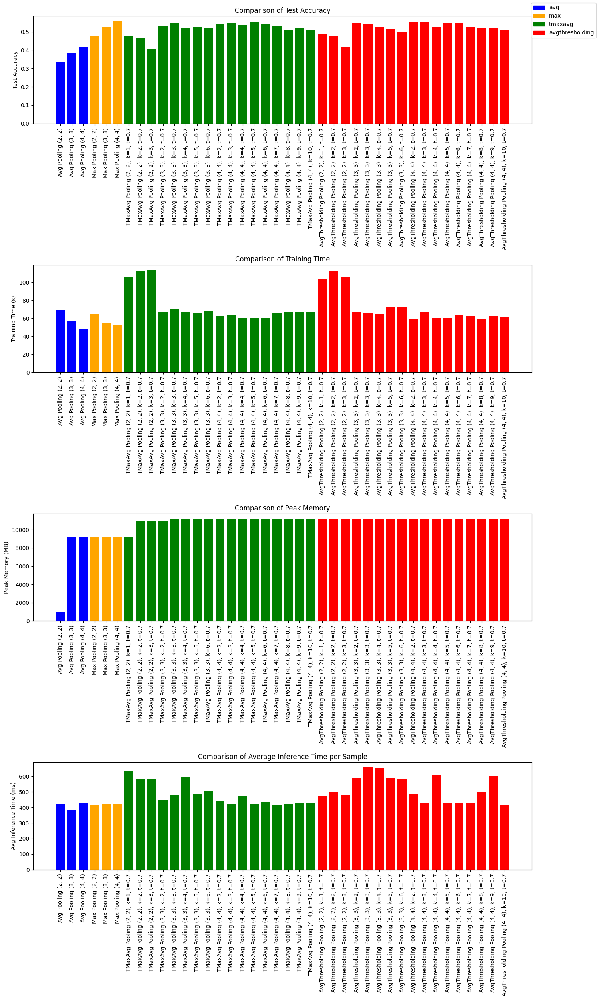

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define colors for each method
method_colors = {
    "avg": "blue",
    "max": "orange",
    "tmaxavg": "green",
    "avgthresholding": "red"
}

# Concatenate metrics
test_accuracy = [r['test_accuracy'] for r in results_avg] + \
                [r['test_accuracy'] for r in results_max] + \
                [r['test_accuracy'] for r in results_tmaxavg] + \
                [r['test_accuracy'] for r in results_avgthresholding]

training_time = [r['training_time'] for r in results_avg] + \
                [r['training_time'] for r in results_max] + \
                [r['training_time'] for r in results_tmaxavg] + \
                [r['training_time'] for r in results_avgthresholding]

peak_memory = [r['peak_mb'] for r in results_avg] + \
              [r['peak_mb'] for r in results_max] + \
              [r['peak_mb'] for r in results_tmaxavg] + \
              [r['peak_mb'] for r in results_avgthresholding]

avg_inference_time = [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_max] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_tmaxavg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avgthresholding]

# Build labels and color list
labels = ([f"Avg Pooling {r['pool_size']}" for r in results_avg] +
          [f"Max Pooling {r['pool_size']}" for r in results_max] +
          [f"TMaxAvg Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_tmaxavg] +
          [f"AvgThresholding Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_avgthresholding])

colors = (["blue"] * len(results_avg) +
          ["orange"] * len(results_max) +
          ["green"] * len(results_tmaxavg) +
          ["red"] * len(results_avgthresholding))

x = np.arange(len(labels))

# Create plots
fig, axes = plt.subplots(4, 1, figsize=(15, 25))

# Test Accuracy
axes[0].bar(x, test_accuracy, color=colors)
axes[0].set_ylabel('Test Accuracy')
axes[0].set_title('Comparison of Test Accuracy')
axes[0].set_xticks(x)
axes[0].set_xticklabels(labels, rotation=90)

# Training Time
axes[1].bar(x, training_time, color=colors)
axes[1].set_ylabel('Training Time (s)')
axes[1].set_title('Comparison of Training Time')
axes[1].set_xticks(x)
axes[1].set_xticklabels(labels, rotation=90)

# Peak Memory
axes[2].bar(x, peak_memory, color=colors)
axes[2].set_ylabel('Peak Memory (MB)')
axes[2].set_title('Comparison of Peak Memory')
axes[2].set_xticks(x)
axes[2].set_xticklabels(labels, rotation=90)

# Average Inference Time
axes[3].bar(x, avg_inference_time, color=colors)
axes[3].set_ylabel('Avg Inference Time (ms)')
axes[3].set_title('Comparison of Average Inference Time per Sample')
axes[3].set_xticks(x)
axes[3].set_xticklabels(labels, rotation=90)

# Add legend manually
handles = [plt.Rectangle((0,0),1,1,color=method_colors[m]) for m in method_colors]
fig.legend(handles, method_colors.keys(), loc="upper right")

plt.tight_layout(rect=[0,0,0.9,1])
plt.show()


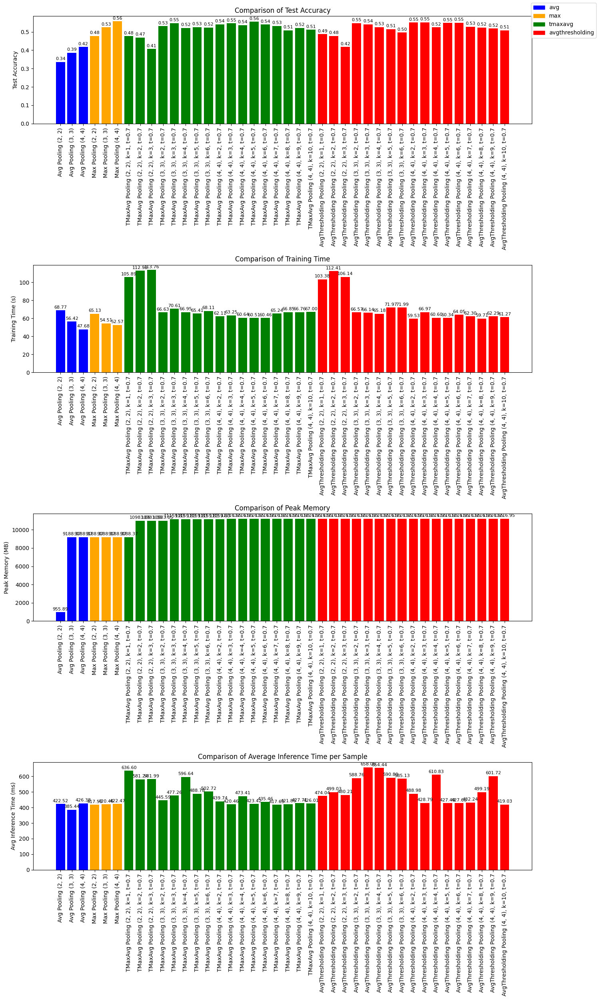

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define colors for each method
method_colors = {
    "avg": "blue",
    "max": "orange",
    "tmaxavg": "green",
    "avgthresholding": "red"
}

# Concatenate metrics
test_accuracy = [r['test_accuracy'] for r in results_avg] + \
                [r['test_accuracy'] for r in results_max] + \
                [r['test_accuracy'] for r in results_tmaxavg] + \
                [r['test_accuracy'] for r in results_avgthresholding]

training_time = [r['training_time'] for r in results_avg] + \
                [r['training_time'] for r in results_max] + \
                [r['training_time'] for r in results_tmaxavg] + \
                [r['training_time'] for r in results_avgthresholding]

peak_memory = [r['peak_mb'] for r in results_avg] + \
              [r['peak_mb'] for r in results_max] + \
              [r['peak_mb'] for r in results_tmaxavg] + \
              [r['peak_mb'] for r in results_avgthresholding]

avg_inference_time = [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_max] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_tmaxavg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avgthresholding]

# Build labels and color list
labels = ([f"Avg Pooling {r['pool_size']}" for r in results_avg] +
          [f"Max Pooling {r['pool_size']}" for r in results_max] +
          [f"TMaxAvg Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_tmaxavg] +
          [f"AvgThresholding Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_avgthresholding])

colors = (["blue"] * len(results_avg) +
          ["orange"] * len(results_max) +
          ["green"] * len(results_tmaxavg) +
          ["red"] * len(results_avgthresholding))

x = np.arange(len(labels))

# Create plots
fig, axes = plt.subplots(4, 1, figsize=(15, 25))

def add_values_on_bars(ax, bars, values):
    """Helper to print values above bars (horizontal)."""
    for bar, val in zip(bars, values):
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + (0.01 * max(values)),  # push slightly above bar
            f"{val:.2f}" if isinstance(val, float) else str(val),
            ha="center", va="bottom", fontsize=8, rotation=0
        )

# Test Accuracy
bars = axes[0].bar(x, test_accuracy, color=colors)
axes[0].set_ylabel('Test Accuracy')
axes[0].set_title('Comparison of Test Accuracy')
axes[0].set_xticks(x)
axes[0].set_xticklabels(labels, rotation=90)
add_values_on_bars(axes[0], bars, test_accuracy)

# Training Time
bars = axes[1].bar(x, training_time, color=colors)
axes[1].set_ylabel('Training Time (s)')
axes[1].set_title('Comparison of Training Time')
axes[1].set_xticks(x)
axes[1].set_xticklabels(labels, rotation=90)
add_values_on_bars(axes[1], bars, training_time)

# Peak Memory
bars = axes[2].bar(x, peak_memory, color=colors)
axes[2].set_ylabel('Peak Memory (MB)')
axes[2].set_title('Comparison of Peak Memory')
axes[2].set_xticks(x)
axes[2].set_xticklabels(labels, rotation=90)
add_values_on_bars(axes[2], bars, peak_memory)

# Average Inference Time
bars = axes[3].bar(x, avg_inference_time, color=colors)
axes[3].set_ylabel('Avg Inference Time (ms)')
axes[3].set_title('Comparison of Average Inference Time per Sample')
axes[3].set_xticks(x)
axes[3].set_xticklabels(labels, rotation=90)
add_values_on_bars(axes[3], bars, avg_inference_time)

# Add legend manually
handles = [plt.Rectangle((0,0),1,1,color=method_colors[m]) for m in method_colors]
fig.legend(handles, method_colors.keys(), loc="upper right")

plt.tight_layout(rect=[0,0,0.9,1])
plt.show()


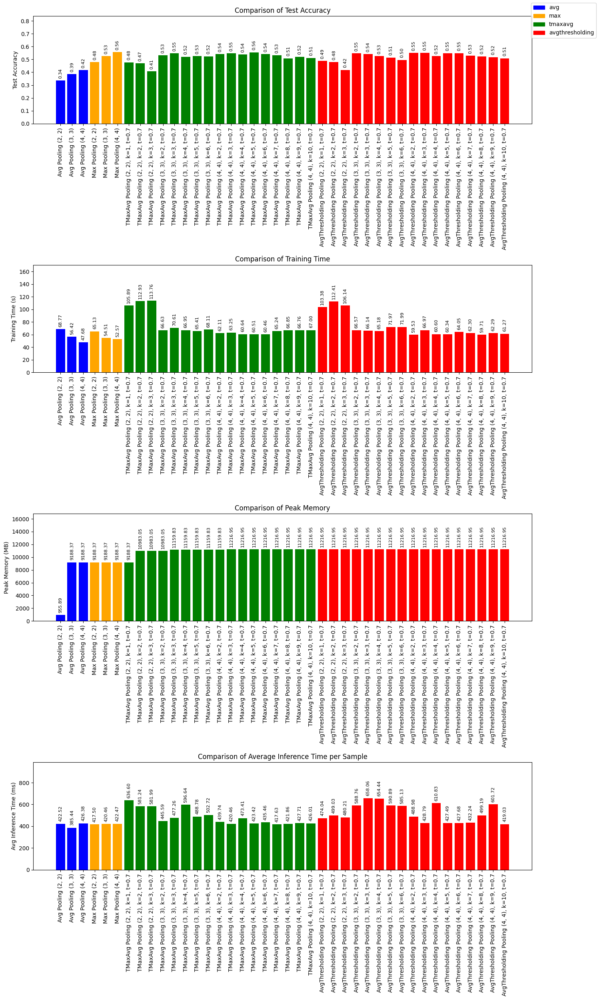

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define colors for each method
method_colors = {
    "avg": "blue",
    "max": "orange",
    "tmaxavg": "green",
    "avgthresholding": "red"
}

# Concatenate metrics
test_accuracy = [r['test_accuracy'] for r in results_avg] + \
                [r['test_accuracy'] for r in results_max] + \
                [r['test_accuracy'] for r in results_tmaxavg] + \
                [r['test_accuracy'] for r in results_avgthresholding]

training_time = [r['training_time'] for r in results_avg] + \
                [r['training_time'] for r in results_max] + \
                [r['training_time'] for r in results_tmaxavg] + \
                [r['training_time'] for r in results_avgthresholding]

peak_memory = [r['peak_mb'] for r in results_avg] + \
              [r['peak_mb'] for r in results_max] + \
              [r['peak_mb'] for r in results_tmaxavg] + \
              [r['peak_mb'] for r in results_avgthresholding]

avg_inference_time = [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_max] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_tmaxavg] + \
                     [r['inference_benchmark']['avg_time_per_sample_ms'] for r in results_avgthresholding]

# Build labels and color list
labels = ([f"Avg Pooling {r['pool_size']}" for r in results_avg] +
          [f"Max Pooling {r['pool_size']}" for r in results_max] +
          [f"TMaxAvg Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_tmaxavg] +
          [f"AvgThresholding Pooling {r['pool_size']}, k={r['k']}, t={r['t']}" for r in results_avgthresholding])

colors = (["blue"] * len(results_avg) +
          ["orange"] * len(results_max) +
          ["green"] * len(results_tmaxavg) +
          ["red"] * len(results_avgthresholding))

x = np.arange(len(labels))

# Create plots
fig, axes = plt.subplots(4, 1, figsize=(15, 25))

def add_values_on_top(ax, bars, values):
    """Helper to print values on top of bars rotated 90° with extra spacing."""
    offset = 0.03 * max(values)  # extra spacing
    for bar, val in zip(bars, values):
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + offset,  # add more gap
            f"{val:.2f}" if isinstance(val, float) else str(val),
            ha="center", va="bottom", fontsize=8, rotation=90, color="black"
        )
    ax.set_ylim(0, max(values) * 1.5)

# Test Accuracy
bars = axes[0].bar(x, test_accuracy, color=colors)
axes[0].set_ylabel('Test Accuracy')
axes[0].set_title('Comparison of Test Accuracy')
axes[0].set_xticks(x)
axes[0].set_xticklabels(labels, rotation=90)
add_values_on_top(axes[0], bars, test_accuracy)

# Training Time
bars = axes[1].bar(x, training_time, color=colors)
axes[1].set_ylabel('Training Time (s)')
axes[1].set_title('Comparison of Training Time')
axes[1].set_xticks(x)
axes[1].set_xticklabels(labels, rotation=90)
add_values_on_top(axes[1], bars, training_time)

# Peak Memory
bars = axes[2].bar(x, peak_memory, color=colors)
axes[2].set_ylabel('Peak Memory (MB)')
axes[2].set_title('Comparison of Peak Memory')
axes[2].set_xticks(x)
axes[2].set_xticklabels(labels, rotation=90)
add_values_on_top(axes[2], bars, peak_memory)

# Average Inference Time
bars = axes[3].bar(x, avg_inference_time, color=colors)
axes[3].set_ylabel('Avg Inference Time (ms)')
axes[3].set_title('Comparison of Average Inference Time per Sample')
axes[3].set_xticks(x)
axes[3].set_xticklabels(labels, rotation=90)
add_values_on_top(axes[3], bars, avg_inference_time)

# Add legend manually
handles = [plt.Rectangle((0,0),1,1,color=method_colors[m]) for m in method_colors]
fig.legend(handles, method_colors.keys(), loc="upper right")

plt.tight_layout(rect=[0,0,0.9,1])
plt.show()


# load from existing model

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 345ms/step


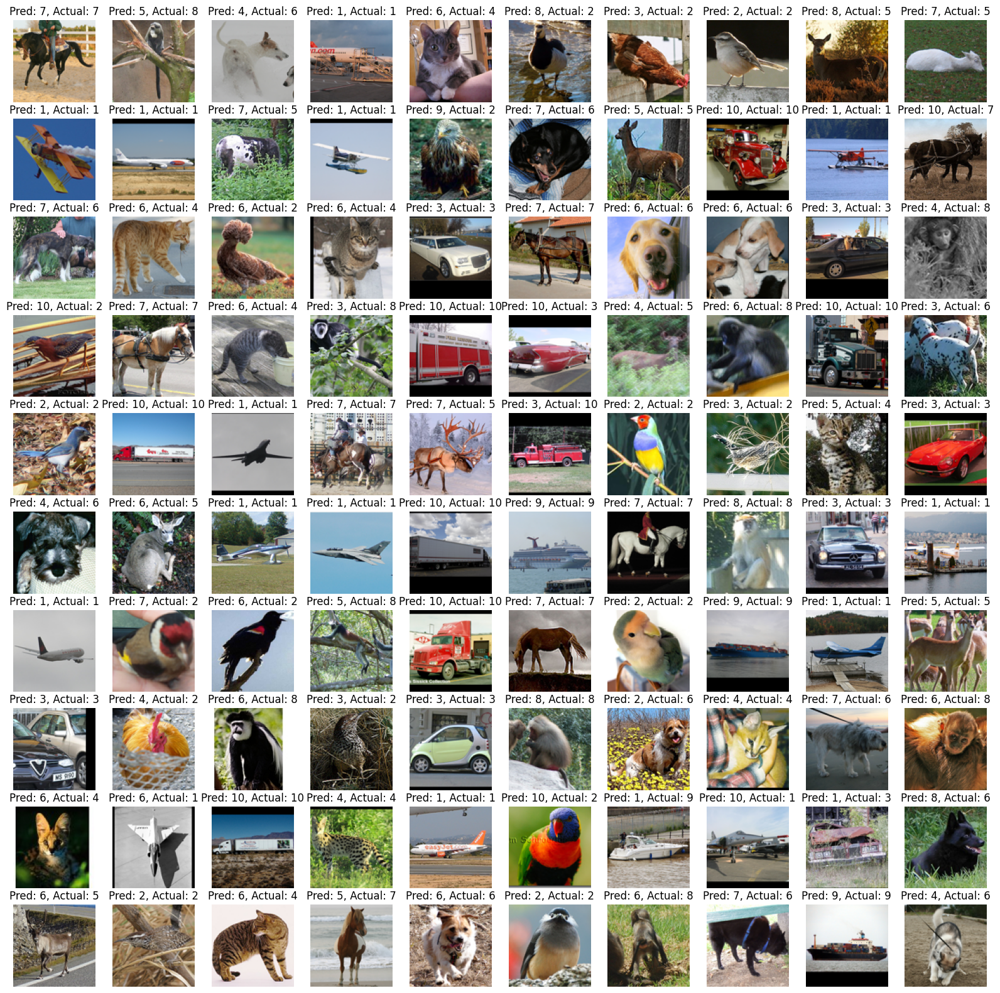

In [ ]:
from tensorflow.keras.models import load_model

# Load the model from the .h5 file
# Replace 'path/to/your/model.h5' with the actual path to your saved model file
loaded_model = load_model('averagethresholding_pooling_model_poolsize_4x4_k_4_t_0.7.h5', custom_objects={'AverageThresholdingPooling2D': AverageThresholdingPooling2D})

show_predictions(loaded_model, x_test, y_test)

# end of experiment